<a href="https://colab.research.google.com/github/Xen14581/BCI/blob/main/BCI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports

In [ ]:
!pip install update gradio matplotlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 42.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.8/57.8 kB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 286.2/286.2 kB 34.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.7/45.7 kB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.3/75.3 kB 11.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 28.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 140.5/140.5 kB 18.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 15.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.0/57.0 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.5/50.5 kB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.7/129.7 

In [ ]:
import scipy.io
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import gradio as gr
import seaborn as sns
import tensorflow as tf
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import cohen_kappa_score

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Data Analysis

## Loading Data of Patient 1

In [ ]:
data = np.load('/content/drive/MyDrive/MP Datasets/A01T.npz')

In [ ]:
data.files

['s', 'etyp', 'epos', 'edur', 'artifacts']

### Signals

In [ ]:
signals = data['s']
signals

array([[-21.14257812, -23.68164062, -21.484375  , ...,  31.73828125,
        -13.671875  , -43.9453125 ],
       [-21.92382812, -23.92578125, -24.31640625, ...,  22.4609375 ,
        -13.18359375, -40.52734375],
       [-15.625     , -19.7265625 , -18.84765625, ...,  33.69140625,
         -8.30078125, -38.57421875],
       ...,
       [  5.51757812,  10.49804688,  14.94140625, ...,   6.34765625,
        -37.109375  ,  16.6015625 ],
       [  1.46484375,   3.07617188,   9.22851562, ...,  -4.39453125,
        -47.8515625 ,  12.6953125 ],
       [  1.3671875 ,   3.515625  ,   7.86132812, ...,  -4.39453125,
        -45.41015625,   7.8125    ]])

In [ ]:
signals.shape

(672528, 25)

### Event type

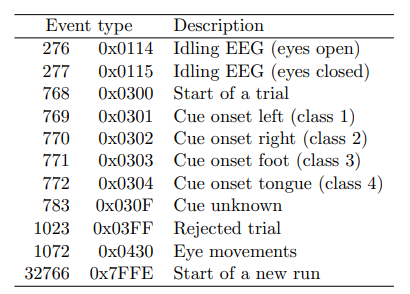

In [ ]:
etype = data['etyp']
etype

array([[32766],
       [  276],
       [32766],
       [  277],
       [32766],
       [ 1072],
       [32766],
       [  768],
       [  772],
       [  768],
       [  771],
       [  768],
       [  770],
       [  768],
       [  769],
       [  768],
       [  769],
       [  768],
       [  770],
       [  768],
       [  771],
       [  768],
       [  772],
       [  768],
       [  770],
       [  768],
       [  771],
       [  768],
       [  769],
       [  768],
       [  769],
       [  768],
       [  769],
       [  768],
       [  772],
       [  768],
       [  770],
       [  768],
       [  770],
       [  768],
       [  769],
       [  768],
       [  769],
       [  768],
       [  771],
       [  768],
       [  769],
       [  768],
       [  770],
       [  768],
       [ 1023],
       [  772],
       [  768],
       [  772],
       [  768],
       [  771],
       [  768],
       [  769],
       [  768],
       [  772],
       [  768],
       [  772],
       [

### Event Position w.r.t. event type and duration

In [ ]:
epos = data['epos']
epos

array([[     1],
       [     1],
       [ 29684],
       [ 29684],
       [ 49956],
       [ 49956],
       [ 91519],
       [ 91869],
       [ 92369],
       [ 93872],
       [ 94372],
       [ 95790],
       [ 96290],
       [ 97742],
       [ 98242],
       [ 99750],
       [100250],
       [101861],
       [102361],
       [103778],
       [104278],
       [105828],
       [106328],
       [107759],
       [108259],
       [109757],
       [110257],
       [111663],
       [112163],
       [113558],
       [114058],
       [115530],
       [116030],
       [117474],
       [117974],
       [119441],
       [119941],
       [121561],
       [122061],
       [123569],
       [124069],
       [125635],
       [126135],
       [127671],
       [128171],
       [129737],
       [130237],
       [131807],
       [132307],
       [133887],
       [133887],
       [134387],
       [135799],
       [136299],
       [137830],
       [138330],
       [139783],
       [140283],
       [141744

### Event Duration

In [ ]:
edur = data['edur']
edur

array([[    0],
       [29682],
       [    0],
       [20271],
       [    0],
       [41562],
       [    0],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [ 1875],
       [  313],
       [

In [ ]:
etype.shape, epos.shape, edur.shape, signals.shape

((603, 1), (603, 1), (603, 1), (672528, 25))

#### From the event type table as seen above, event type 768 represent the start of a trial. Hence, let us observe the signals of this trial.

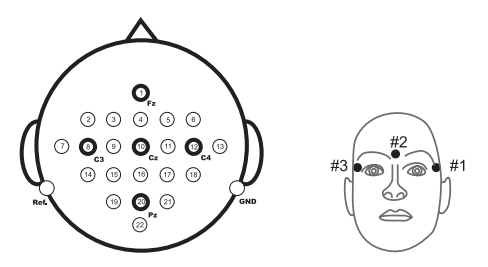

##### From the above diagram, we can see that the 1st, 8th, 10th, 12th and 20th channels are important. Therefore, let us check the signals of these channels.

In [ ]:
channelFz = signals[:, 0]
channelC3 = signals[:, 7]
channelCz = signals[:, 9]
channelC4 = signals[:, 11]
channelPz = signals[:, 19]

In [ ]:
etype_req = etype.T[0,7] # Since the 7th occuring event is 768
epos_req = epos.T[0,7]
edur_req = edur.T[0,7]

In [ ]:
etype_req, epos_req, edur_req

(768, 91869, 1875)

In [ ]:
trial_start_Fz = channelFz[epos_req : epos_req + edur_req]
trial_start_C3 = channelC3[epos_req : epos_req + edur_req]
trial_start_Cz = channelCz[epos_req : epos_req + edur_req]
trial_start_C4 = channelC4[epos_req : epos_req + edur_req]
trial_start_Pz = channelPz[epos_req : epos_req + edur_req]

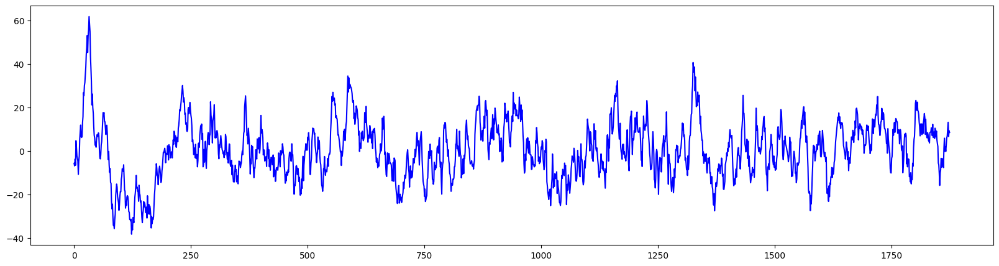

In [ ]:
plt.figure(figsize=(20,5))
plt.plot(trial_start_Fz, 'b-')
plt.show()

In [ ]:
etype_req = etype.T[0,8] # Since the 8th occuring event is 769
epos_req = epos.T[0,8]
edur_req = edur.T[0,8]

In [ ]:
etype_req, epos_req, edur_req

(772, 92369, 313)

In [ ]:
trial_start_Fz = channelFz[epos_req : epos_req + edur_req]
trial_start_C3 = channelC3[epos_req : epos_req + edur_req]
trial_start_Cz = channelCz[epos_req : epos_req + edur_req]
trial_start_C4 = channelC4[epos_req : epos_req + edur_req]
trial_start_Pz = channelPz[epos_req : epos_req + edur_req]

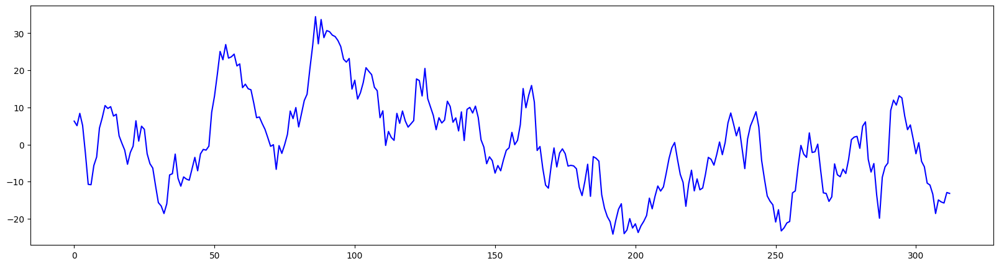

In [ ]:
plt.figure(figsize=(20,5))
plt.plot(trial_start_Fz, 'b-')
plt.show()

In [ ]:
from PIL import Image
import os

In [ ]:
def make_graphs(channels=[]):
  print(channels)
  img = None
  for channel in channels:
    temp = signals[:, channel]
    img = plt.plot(temp[epos_req : epos_req + edur_req])
  plt.savefig('temp.jpeg')
  img = Image.open('temp.jpeg')
  os.remove('temp.jpeg')
  return img

In [ ]:
with gr.Blocks() as demo:
  with gr.Column(scale=2):
    gr.Markdown("""
      # Select EEG Channels to see signals
    """)
    with gr.Row():
      check = gr.CheckboxGroup(list(range(0,23)))
      plt = gr.Image()
      check.change(fn=make_graphs, inputs=check, outputs=plt)
demo.launch(share=True, debug=True, inbrowser=True)

Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
Running on public URL: https://ae2f60af388109a112.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades (NEW!), check out Spaces: https://huggingface.co/spaces


[3]


Traceback (most recent call last):
  File "/usr/local/lib/python3.9/dist-packages/gradio/routes.py", line 401, in run_predict
    output = await app.get_blocks().process_api(
  File "/usr/local/lib/python3.9/dist-packages/gradio/blocks.py", line 1302, in process_api
    result = await self.call_function(
  File "/usr/local/lib/python3.9/dist-packages/gradio/blocks.py", line 1025, in call_function
    prediction = await anyio.to_thread.run_sync(
  File "/usr/local/lib/python3.9/dist-packages/anyio/to_thread.py", line 31, in run_sync
    return await get_asynclib().run_sync_in_worker_thread(
  File "/usr/local/lib/python3.9/dist-packages/anyio/_backends/_asyncio.py", line 937, in run_sync_in_worker_thread
    return await future
  File "/usr/local/lib/python3.9/dist-packages/anyio/_backends/_asyncio.py", line 867, in run
    result = context.run(func, *args)
  File "<ipython-input-26-0bb5ce65b3d4>", line 6, in make_graphs
    img = plt.plot(temp[epos_req : epos_req + edur_req])
Attribute

Keyboard interruption in main thread... closing server.
Killing tunnel 127.0.0.1:7860 <> https://5ef52400b34f5519b5.gradio.live
Killing tunnel 127.0.0.1:7861 <> https://92fe91d76b39c2a817.gradio.live
Killing tunnel 127.0.0.1:7862 <> https://68f3863a0c9c9ba731.gradio.live
Killing tunnel 127.0.0.1:7863 <> https://ae2f60af388109a112.gradio.live


## Data Segmentation

In [ ]:
left = [] # 769
right = [] # 770
foot = [] # 771
tongue = [] # 772

for i in range(len(etype)):
  channels = []
  for sig in signals.T:
    channels.append(sig[epos[i,0] : epos[i,0] + edur[i,0]])
  if etype[i,0] == 769:
    left.append(channels[:22])
  elif etype[i,0] == 770:
    right.append(channels[:22])
  elif etype[i,0] == 771:
    foot.append(channels[:22])
  elif etype[i,0] == 772:
    tongue.append(channels[:22])
left = np.array(left)
right = np.array(right)
foot = np.array(foot)
tongue = np.array(tongue)

print(left.shape, right.shape, foot.shape, tongue.shape)

(72, 22, 313) (72, 22, 313) (72, 22, 313) (72, 22, 313)


## Left hand signal analysis

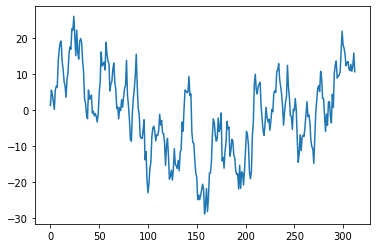

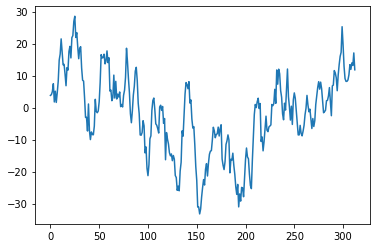

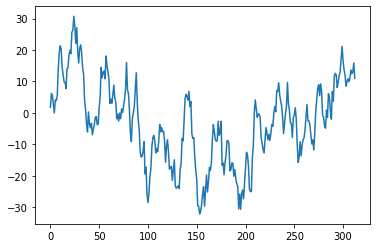

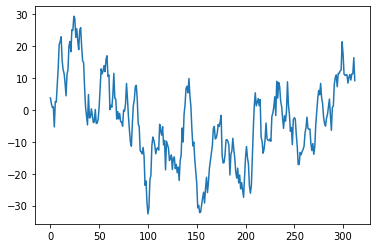

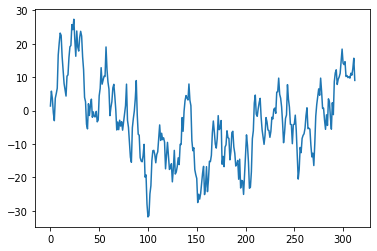

In [ ]:
plt.plot(left[0,0,:])
plt.show()
plt.plot(left[0,1,:])
plt.show()
plt.plot(left[0,2,:])
plt.show()
plt.plot(left[0,3,:])
plt.show()
plt.plot(left[0,4,:])
plt.show()

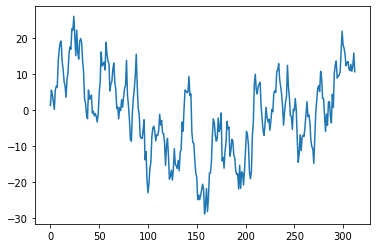

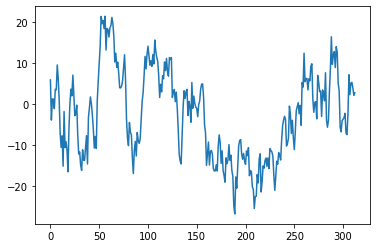

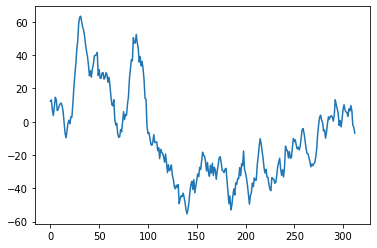

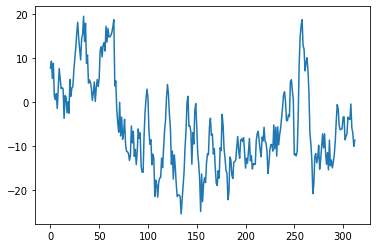

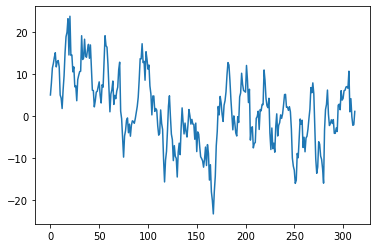

...

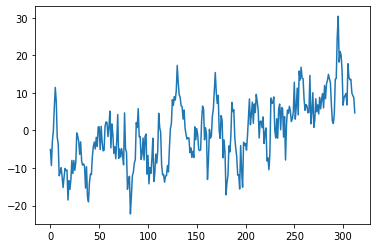

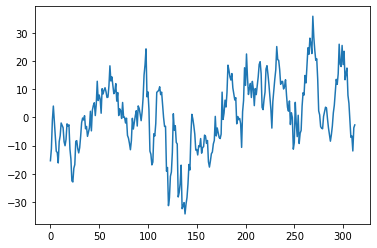

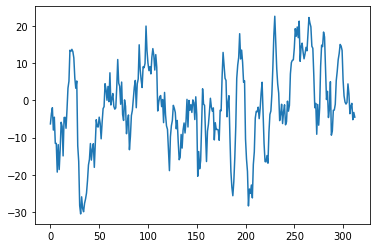

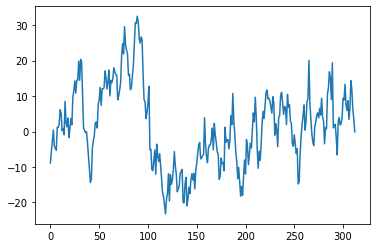

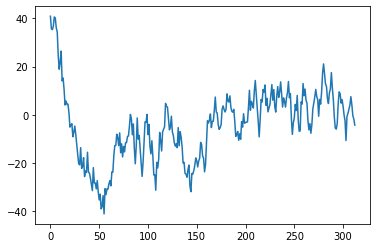

In [ ]:
for sig in left:
  for insig in sig:
    plt.plot(insig)
    break
  plt.show()

In [ ]:
# Variance in signals
for sig in left:
  for insig in sig:
    print(np.var(insig))
    break

129.41566313441913
110.24684753369687
728.5524603918225
98.71341027921369
69.27209960095196
119.88167141260396
121.1082306852834
107.99740916106714
103.02491701979596
130.24047265782247
148.05752673094256
103.11291479149597
124.52911732688858
102.65208520597153
103.24356624542256
123.13669286072447
86.58657580750067
73.24673592168789
82.46698457294855
64.7833680019716
138.77763272057004
107.24942230961935
147.32884499705688
326.73090898628874
208.37536874820236
79.86280863584082
99.26595921395662
139.53227146229946
196.084856657245
125.08226867805989
115.38427089666281
113.18637799344954
110.97699654120699
125.45248270363327
83.88571259337073
82.62987803358601
125.36332088642133
183.96226995873658
108.01037963406786
138.09811224597365
95.93341898337248
95.17026055379831
146.6050973637617
112.44058275603881
95.26880969036927
127.43324519875627
70.9051662865947
77.22684830850922
67.37311899325572
130.52942169525565
102.74627754349967
79.98517665702029
99.2060628033834
61.42403384421874
7

In [ ]:
# Standard Deviation in signals
for sig in left:
  for insig in sig:
    print(np.std(insig))
    break

11.376100524099597
10.499849881483872
26.991710957103525
9.93546225795326
8.32298621895723
10.949048881642824
11.004918476993975
10.392180192869404
10.15011906431624
11.412294802441027
12.167889164967873
10.154452953827496
11.159261504548075
10.13173653457153
10.160884127152645
11.096697385291016
9.305190799091692
8.558430692696406
9.081133440983486
8.048811589419373
11.780391874660623
10.356129697412028
12.137909416248618
18.07569940517624
14.435212805781644
8.93659938879666
9.963230360377935
11.812377891952977
14.003030266954543
11.184018449468862
10.741707075537985
10.63890868432705
10.534562000444394
11.200557249692235
9.158914378536942
9.090097801101262
11.19657630199613
13.563269147176008
10.392804223791954
11.751515317012256
9.794560683531063
9.755524617046401
12.108059190628435
10.6038003921254
9.760574250031054
11.28863345134194
8.420520547246156
8.787880763216421
8.208112998324019
11.424947338839495
10.13638384945537
8.943443221546179
9.960224033794793
7.8373486488875015
8.62

In [ ]:
# Correlation between signals
fzdf = pd.DataFrame(left[:,0]) # Fz signal for left hand movement
c3df = pd.DataFrame(left[:,1])
czdf = pd.DataFrame(left[:,2])
c4df = pd.DataFrame(left[:,3])
pzdf = pd.DataFrame(left[:,4])

In [ ]:
fzdf

,0,1,2,3,4,5,6,7,8,9,...,303,304,305,306,307,308,309,310,311,312
0,1.220703,5.468750,4.345703,2.294922,0.146484,5.468750,6.591797,6.298828,13.574219,16.699219,...,12.255859,12.988281,13.427734,11.474609,10.888672,12.695312,10.742188,12.255859,15.820312,10.595703
1,5.908203,-3.906250,1.269531,1.220703,-1.123047,3.613281,3.466797,9.570312,6.250000,0.976562,...,-7.080078,-7.470703,-2.490234,7.177734,2.294922,5.126953,5.322266,4.052734,2.148438,2.783203
2,12.402344,13.085938,6.982422,3.710938,8.837891,14.697266,13.183594,6.689453,7.470703,9.570312,...,5.908203,5.517578,3.222656,7.714844,6.542969,9.716797,6.640625,-2.001953,-3.515625,-6.835938
3,7.666016,9.228516,5.322266,8.740234,1.269531,0.488281,1.855469,-1.513672,2.783203,7.568359,...,-7.812500,-7.275391,-3.466797,-3.857422,-4.003906,-0.488281,-5.957031,-7.080078,-10.107422,-8.691406
4,5.029297,7.861328,11.425781,12.500000,13.964844,15.087891,11.718750,12.988281,13.232422,11.718750,...,6.933594,7.031250,6.640625,10.693359,1.025391,4.150391,-0.146484,-2.197266,-2.050781,1.123047
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67,-5.078125,-9.326172,-2.880859,-0.195312,6.152344,11.474609,7.666016,-1.855469,-3.564453,-12.060547,...,9.814453,6.787109,17.773438,14.160156,13.525391,13.623047,10.009766,9.277344,8.740234,4.687500
68,-15.380859,-11.132812,-1.074219,4.003906,-1.220703,-6.347656,-12.011719,-12.451172,-16.162109,-8.593750,...,15.576172,17.480469,7.812500,4.980469,-0.976562,-7.080078,-6.591797,-11.914062,-3.710938,-2.685547
69,-6.347656,-3.613281,-2.001953,-8.007812,-4.541016,-11.572266,-11.572266,-19.287109,-11.914062,-18.603516,...,-1.025391,-0.585938,4.394531,1.708984,-3.613281,-1.562500,-0.830078,-5.224609,-3.271484,-4.541016
70,-8.886719,-5.468750,-2.734375,0.439453,-4.101562,-4.736328,-5.322266,1.171875,1.123047,2.099609,...,7.568359,5.957031,8.691406,3.369141,6.396484,14.355469,11.816406,6.298828,3.515625,-0.097656


<AxesSubplot:>

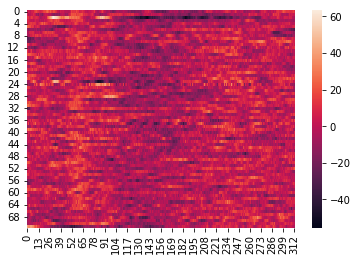

In [ ]:
sns.heatmap(fzdf)

<AxesSubplot:>

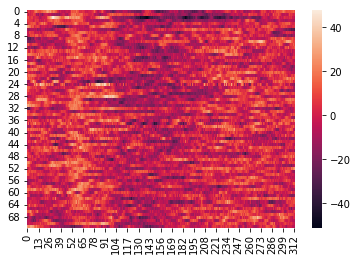

In [ ]:
sns.heatmap(czdf)

<AxesSubplot:>

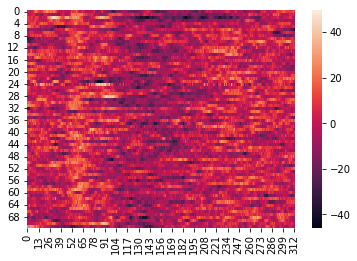

In [ ]:
sns.heatmap(pzdf)

<AxesSubplot:>

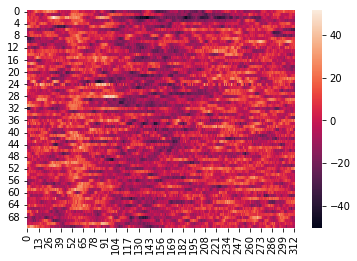

In [ ]:
sns.heatmap(c4df)

<AxesSubplot:>

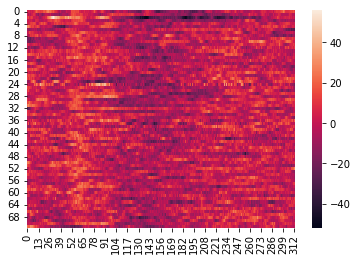

In [ ]:
sns.heatmap(c3df)

## Right hand movement signals analysis

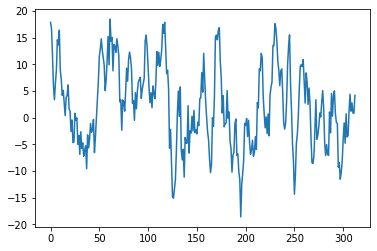

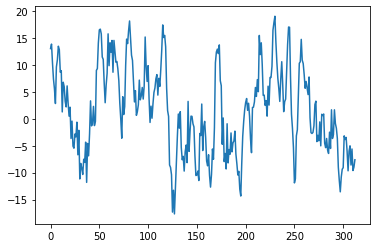

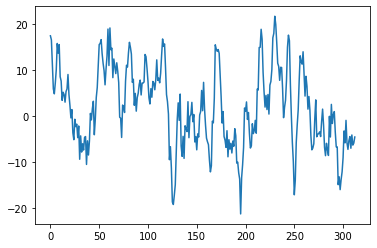

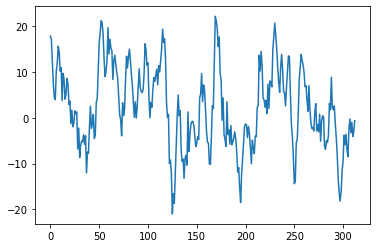

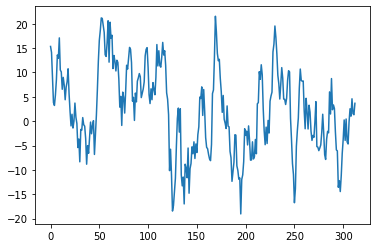

In [ ]:
plt.plot(right[0,0,:])
plt.show()
plt.plot(right[0,1,:])
plt.show()
plt.plot(right[0,2,:])
plt.show()
plt.plot(right[0,3,:])
plt.show()
plt.plot(right[0,4,:])
plt.show()

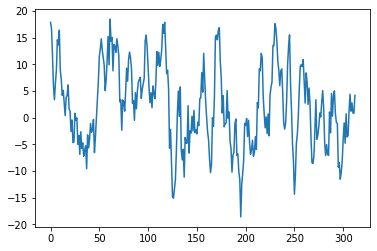

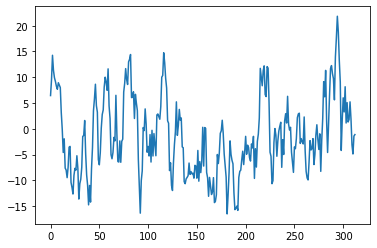

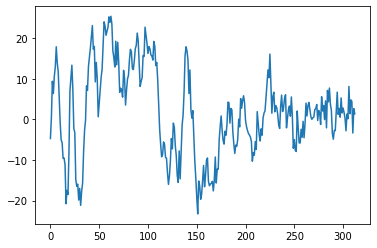

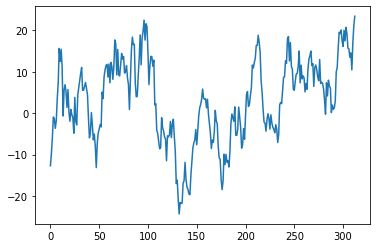

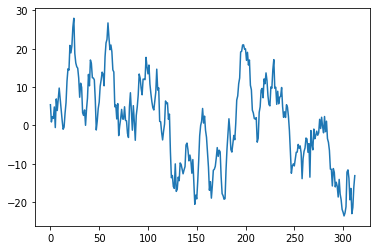

...

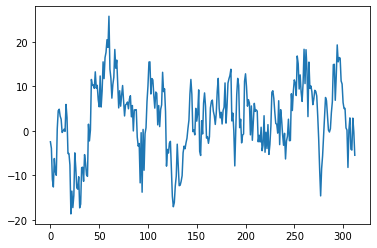

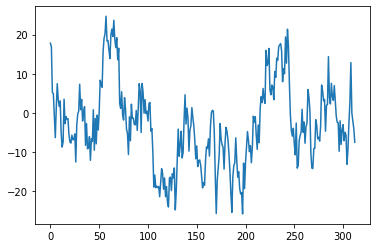

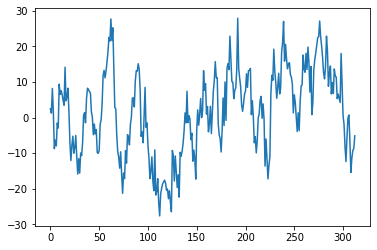

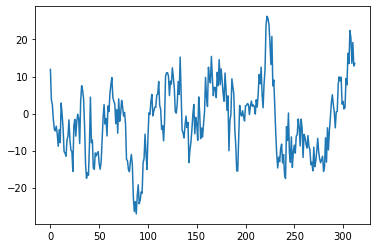

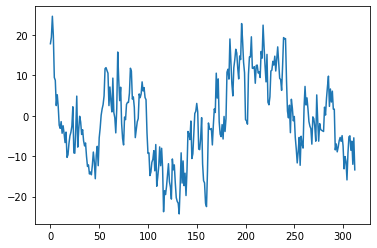

In [ ]:
for sig in right:
  for insig in sig:
    plt.plot(insig)
    break
  plt.show()

In [ ]:
# Correlation between signals
fzdf = pd.DataFrame(right[:,0]) # Fz signal for right hand movement
c3df = pd.DataFrame(right[:,1])
czdf = pd.DataFrame(right[:,2])
c4df = pd.DataFrame(right[:,3])
pzdf = pd.DataFrame(right[:,4])

In [ ]:
fzdf

,0,1,2,3,4,5,6,7,8,9,...,303,304,305,306,307,308,309,310,311,312
0,17.871094,16.650391,11.669922,5.908203,3.369141,6.445312,8.935547,14.599609,13.623047,16.406250,...,0.732422,-3.613281,-3.369141,1.220703,4.394531,1.220703,2.783203,0.878906,0.830078,4.199219
1,6.445312,9.521484,14.257812,11.328125,9.912109,9.179688,8.251953,7.666016,8.935547,8.447266,...,1.123047,5.078125,1.318359,1.806641,5.224609,1.855469,-3.125000,-4.882812,-1.416016,-1.123047
2,-4.736328,0.390625,9.375000,6.347656,10.595703,12.890625,17.871094,13.867188,11.767578,5.175781,...,-2.832031,1.318359,0.146484,8.105469,1.367188,4.785156,4.443359,-3.369141,2.636719,1.367188
3,-12.695312,-9.814453,-5.859375,-0.927734,-1.318359,-3.662109,-1.855469,3.466797,7.324219,15.625000,...,20.703125,19.091797,15.673828,15.478516,13.476562,14.550781,10.449219,16.894531,20.996094,23.388672
4,5.371094,0.878906,2.246094,1.806641,4.785156,-0.585938,6.884766,3.857422,6.689453,9.716797,...,-21.240234,-12.207031,-11.621094,-13.769531,-19.433594,-16.455078,-23.046875,-21.435547,-16.162109,-13.134766
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67,-2.441406,-3.906250,-10.888672,-12.597656,-6.201172,-9.179688,-9.960938,0.439453,4.541016,4.882812,...,0.683594,0.195312,-8.203125,0.292969,2.929688,-4.101562,-4.296875,2.880859,-0.195312,-5.468750
68,17.773438,16.845703,5.273438,4.931641,-0.732422,-6.298828,1.269531,7.470703,3.417969,1.660156,...,-5.615234,-13.085938,-9.228516,-2.587891,2.783203,12.841797,0.000000,-2.001953,-4.003906,-7.470703
69,2.490234,1.269531,8.203125,1.562500,-8.740234,-6.347656,-7.958984,-1.562500,-2.929688,9.423828,...,-12.353516,-5.468750,-0.146484,0.732422,-6.835938,-15.429688,-11.376953,-9.228516,-8.691406,-5.126953
70,11.914062,3.662109,2.343750,-1.660156,-4.199219,-4.687500,-3.417969,-5.517578,-8.837891,-4.345703,...,9.472656,7.763672,16.259766,13.476562,22.412109,20.458984,13.574219,19.189453,12.841797,13.525391


<AxesSubplot:>

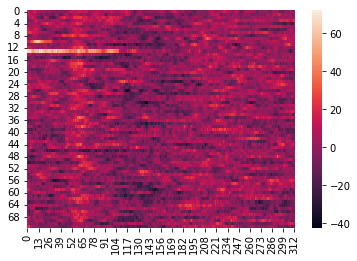

In [ ]:
sns.heatmap(fzdf)

<AxesSubplot:>

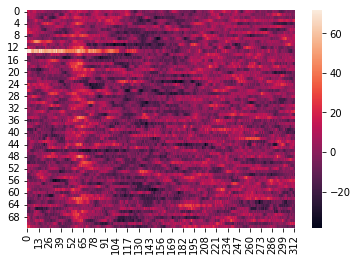

In [ ]:
sns.heatmap(czdf)

<AxesSubplot:>

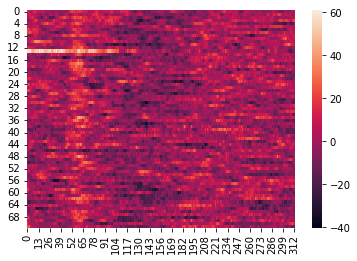

In [ ]:
sns.heatmap(pzdf)

<AxesSubplot:>

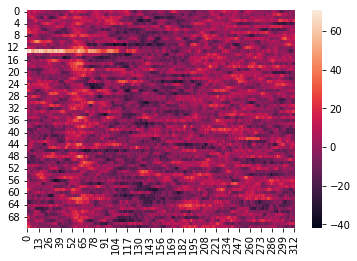

In [ ]:
sns.heatmap(c4df)

<AxesSubplot:>

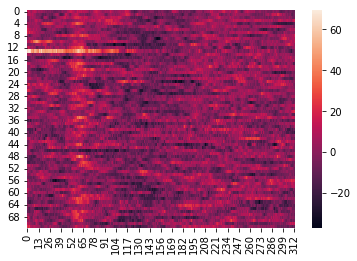

In [ ]:
sns.heatmap(c3df)

## Foot movement signals

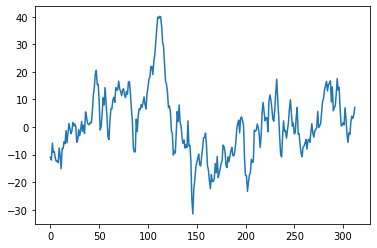

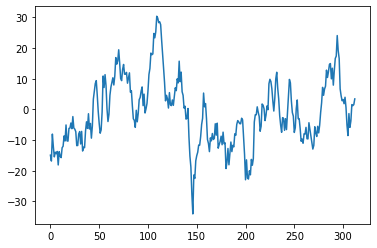

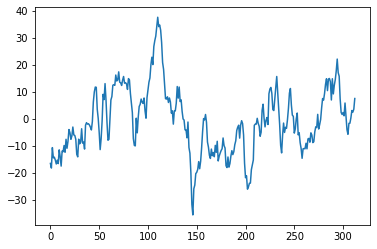

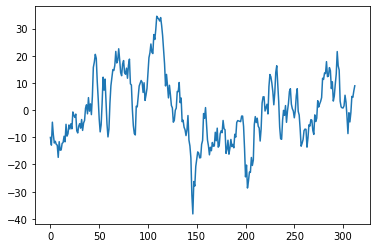

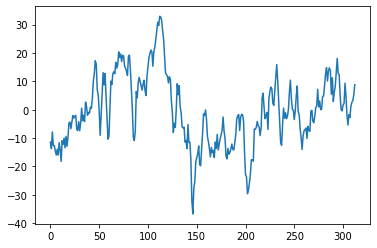

In [ ]:
plt.plot(foot[0,0,:])
plt.show()
plt.plot(foot[0,1,:])
plt.show()
plt.plot(foot[0,2,:])
plt.show()
plt.plot(foot[0,3,:])
plt.show()
plt.plot(foot[0,4,:])
plt.show()

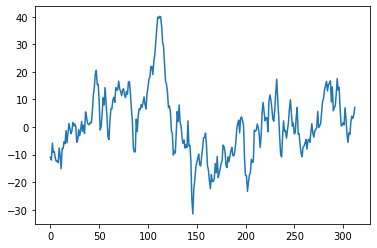

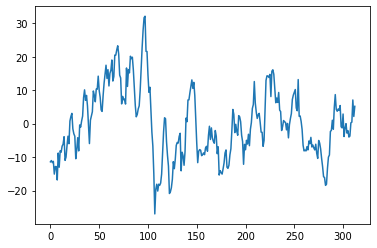

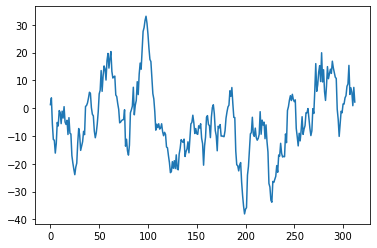

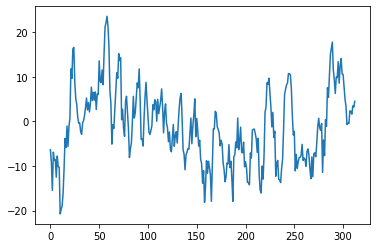

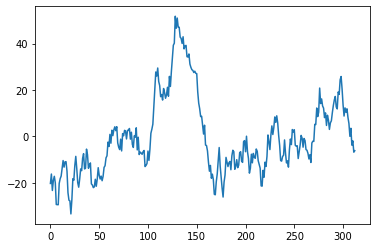

...

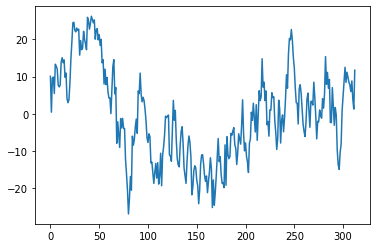

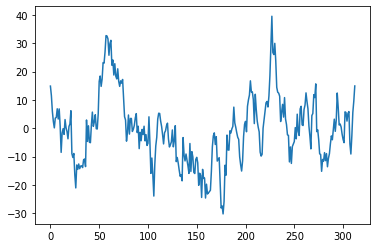

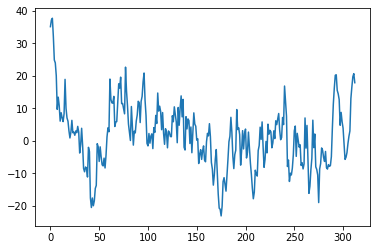

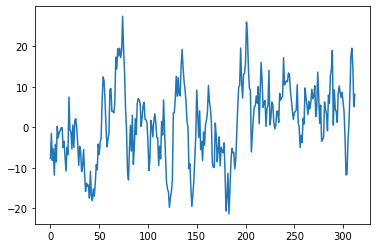

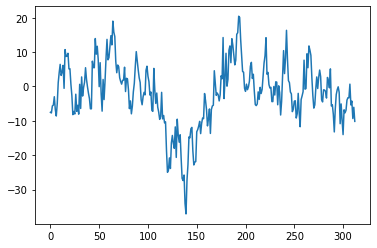

In [ ]:
for sig in foot:
  for insig in sig:
    plt.plot(insig)
    break
  plt.show()

In [ ]:
# Correlation between signals
fzdf = pd.DataFrame(foot[:,0]) # Fz signal for foot movement
c3df = pd.DataFrame(foot[:,1])
czdf = pd.DataFrame(foot[:,2])
c4df = pd.DataFrame(foot[:,3])
pzdf = pd.DataFrame(foot[:,4])

In [ ]:
fzdf

,0,1,2,3,4,5,6,7,8,9,...,303,304,305,306,307,308,309,310,311,312
0,-10.937500,-11.962891,-5.810547,-9.179688,-8.935547,-11.279297,-12.402344,-12.207031,-12.939453,-7.568359,...,3.125000,-2.783203,-5.566406,-2.050781,-2.685547,1.855469,3.955078,3.076172,4.296875,7.128906
1,-11.425781,-11.035156,-11.669922,-11.279297,-15.087891,-12.841797,-12.841797,-16.845703,-8.789062,-13.037109,...,0.000000,-2.832031,-2.099609,-4.003906,-3.710938,0.244141,0.439453,7.080078,2.148438,5.175781
2,1.269531,3.710938,-5.712891,-11.279297,-11.523438,-16.162109,-12.646484,-5.126953,-6.396484,-0.878906,...,4.492188,7.861328,8.691406,15.380859,4.931641,7.324219,5.664062,0.878906,7.470703,2.197266
3,-6.347656,-9.277344,-15.478516,-6.884766,-8.691406,-8.544922,-12.500000,-7.763672,-10.156250,-10.253906,...,3.369141,-0.683594,-0.390625,-0.439453,2.392578,2.294922,1.660156,3.515625,3.222656,4.541016
4,-20.263672,-16.210938,-23.291016,-18.994141,-17.187500,-19.970703,-29.345703,-29.394531,-29.443359,-20.263672,...,10.400391,11.914062,8.203125,5.566406,0.048828,3.515625,-3.759766,-1.904297,-6.787109,-6.152344
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67,10.058594,0.439453,9.570312,9.863281,5.468750,13.330078,12.792969,12.011719,7.666016,7.226562,...,8.447266,11.181641,9.863281,8.496094,7.714844,5.957031,8.837891,3.857422,1.269531,11.718750
68,14.892578,11.523438,5.957031,2.441406,0.146484,3.613281,3.808594,6.884766,3.271484,6.835938,...,5.566406,2.539062,5.273438,5.908203,-5.468750,-9.082031,-2.636719,5.615234,9.619141,14.941406
69,35.156250,37.207031,37.744141,32.177734,24.902344,24.023438,20.068359,9.716797,13.476562,10.888672,...,-5.029297,-3.564453,-0.781250,1.416016,3.076172,13.037109,16.601562,19.726562,20.703125,17.919922
70,-7.714844,-1.513672,-8.203125,-5.371094,-11.865234,-4.199219,-8.593750,0.244141,-2.636719,-1.318359,...,-11.816406,-11.669922,-3.613281,0.634766,8.007812,17.480469,19.531250,15.087891,5.078125,8.105469


<AxesSubplot:>

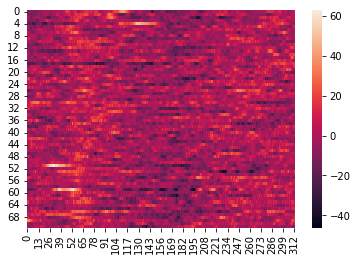

In [ ]:
sns.heatmap(fzdf)

<AxesSubplot:>

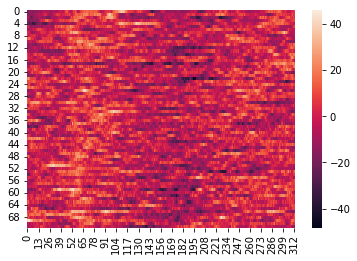

In [ ]:
sns.heatmap(czdf)

<AxesSubplot:>

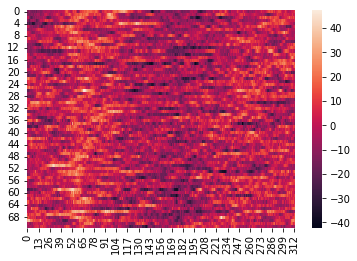

In [ ]:
sns.heatmap(pzdf)

<AxesSubplot:>

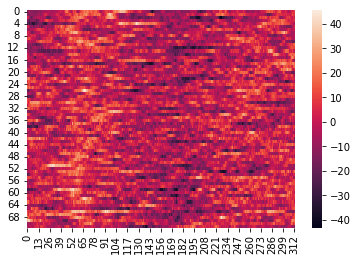

In [ ]:
sns.heatmap(c4df)

<AxesSubplot:>

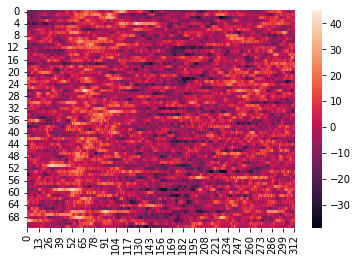

In [ ]:
sns.heatmap(c3df)

## Tongue movement

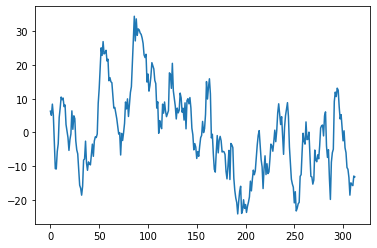

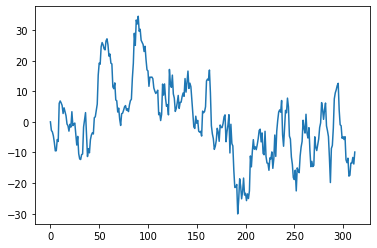

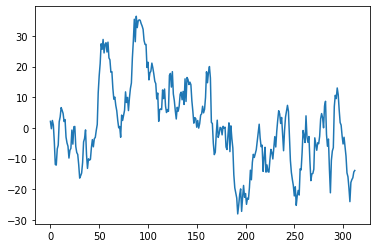

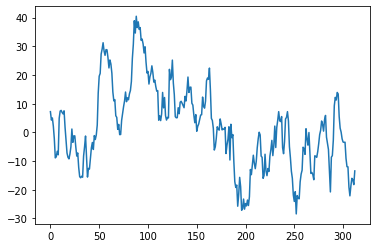

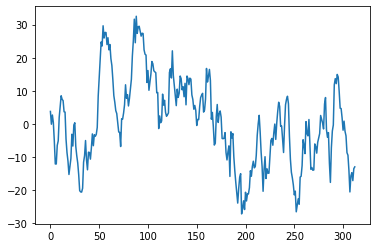

In [ ]:
plt.plot(tongue[0,0,:])
plt.show()
plt.plot(tongue[0,1,:])
plt.show()
plt.plot(tongue[0,2,:])
plt.show()
plt.plot(tongue[0,3,:])
plt.show()
plt.plot(tongue[0,4,:])
plt.show()

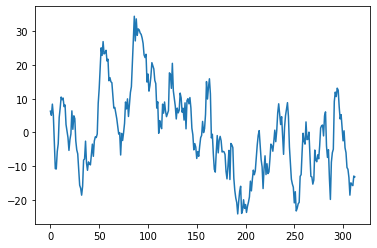

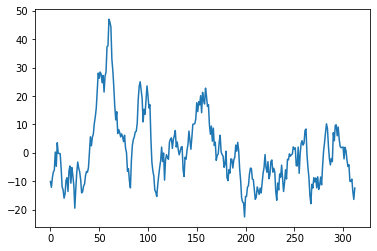

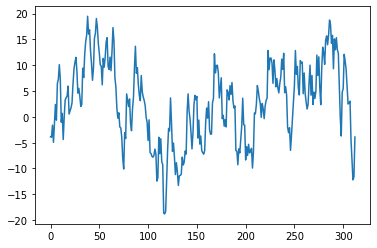

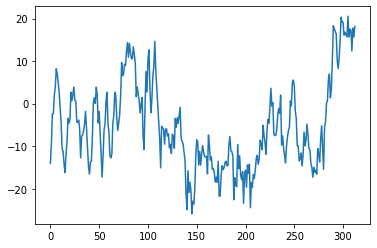

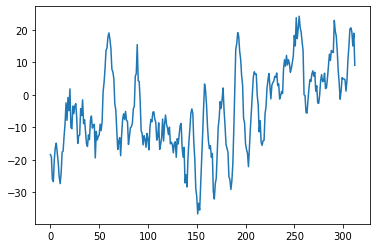

...

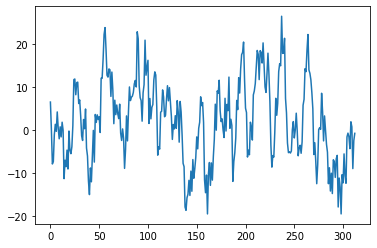

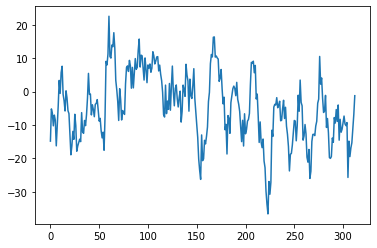

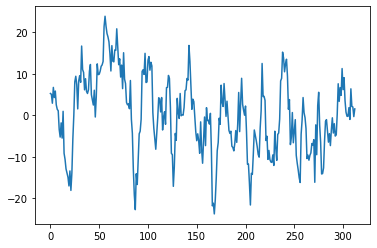

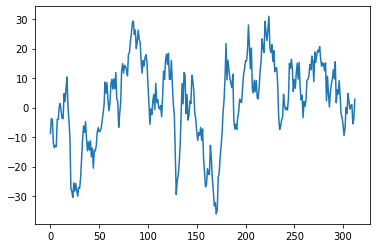

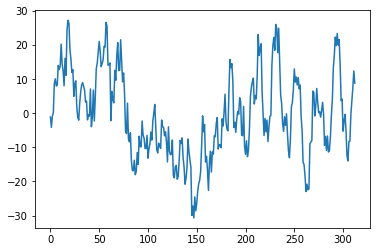

In [ ]:
for sig in tongue:
  for insig in sig:
    plt.plot(insig)
    break
  plt.show()

In [ ]:
# Correlation between signals
fzdf = pd.DataFrame(tongue[:,0]) # Fz signal for tongue movement
c3df = pd.DataFrame(tongue[:,1])
czdf = pd.DataFrame(tongue[:,2])
c4df = pd.DataFrame(tongue[:,3])
pzdf = pd.DataFrame(tongue[:,4])

In [ ]:
fzdf

,0,1,2,3,4,5,6,7,8,9,...,303,304,305,306,307,308,309,310,311,312
0,6.298828,5.078125,8.398438,5.126953,-2.392578,-10.742188,-10.839844,-5.664062,-3.369141,4.443359,...,-6.005859,-10.400391,-10.937500,-13.378906,-18.603516,-14.941406,-15.478516,-15.771484,-12.939453,-13.183594
1,-10.058594,-12.109375,-8.740234,-6.738281,-6.054688,0.292969,-4.736328,3.564453,-0.146484,-0.195312,...,0.732422,-2.587891,-4.785156,-4.150391,-9.960938,-10.058594,-9.228516,-13.574219,-16.357422,-12.353516
2,-3.857422,-3.955078,-1.611328,-4.931641,-1.123047,2.392578,-0.634766,6.445312,7.275391,10.107422,...,9.179688,6.005859,2.490234,2.636719,3.027344,-4.443359,-8.251953,-12.207031,-11.621094,-3.906250
3,-14.062500,-9.521484,-2.441406,-2.392578,2.001953,3.906250,8.203125,7.031250,4.931641,2.539062,...,16.210938,15.673828,20.556641,15.722656,17.529297,17.333984,12.402344,17.773438,15.673828,18.164062
4,-18.408203,-19.189453,-26.025391,-26.708984,-19.873047,-16.210938,-14.892578,-17.919922,-20.849609,-25.341797,...,1.123047,4.492188,10.839844,15.039062,20.214844,20.605469,19.384766,15.039062,18.945312,9.082031
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67,6.542969,0.146484,-7.861328,-7.275391,-1.074219,1.367188,-0.244141,4.248047,0.390625,-2.001953,...,-12.353516,-1.562500,-0.683594,-1.513672,-4.296875,1.953125,0.781250,-8.935547,-2.441406,-0.732422
68,-14.843750,-5.175781,-6.494141,-10.253906,-7.031250,-8.544922,-16.259766,-10.400391,-4.199219,3.369141,...,-10.205078,-9.277344,-25.732422,-14.843750,-19.482422,-16.894531,-15.332031,-11.132812,-6.884766,-1.220703
69,5.273438,5.078125,2.929688,6.738281,4.296875,5.859375,2.539062,1.464844,1.123047,-3.369141,...,0.781250,-0.195312,-0.244141,1.855469,-0.976562,6.396484,2.148438,2.050781,-0.292969,1.562500
70,-8.740234,-3.710938,-4.150391,-12.011719,-13.623047,-12.841797,-13.232422,-4.003906,-4.052734,0.097656,...,0.000000,-2.001953,4.736328,2.294922,-0.488281,0.634766,0.976562,-5.517578,-3.857422,2.832031


<AxesSubplot:>

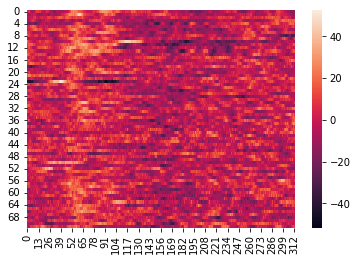

In [ ]:
sns.heatmap(fzdf)

<AxesSubplot:>

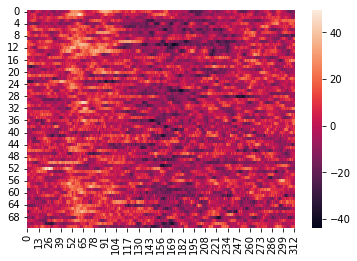

In [ ]:
sns.heatmap(czdf)

<AxesSubplot:>

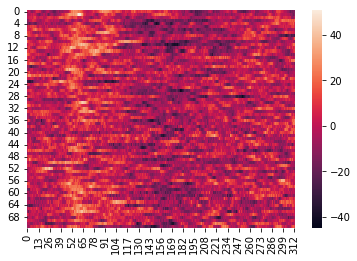

In [ ]:
sns.heatmap(pzdf)

<AxesSubplot:>

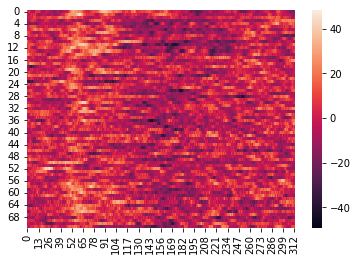

In [ ]:
sns.heatmap(c4df)

<AxesSubplot:>

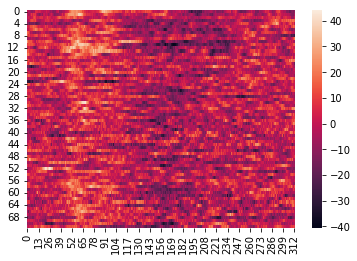

In [ ]:
sns.heatmap(c3df)

In [ ]:
# t => fz cz
# f => fz c4 c3
# r => c3 pz
# l => cz pz c3

## Image Generation from signals

EEG Signal to Image Conversion Trial
https://github.com/tevisgehr/EEG-Classification/blob/master/Initial_EDA.ipynb
Code taken from above link to preprocess data

In [ ]:
def get_fft(snippet):
    Fs = 128.0;  # sampling rate
    snippet_time = len(snippet)/Fs
    Ts = 1.0/Fs; # sampling interval
    t = np.arange(0,snippet_time,Ts) # time vector
    y = snippet
    n = len(y) # length of the signal
    k = np.arange(n)
    T = n/Fs
    frq = k/T # two sides frequency range
    frq = frq[range(int(n/2))] # one side frequency range

    Y = np.fft.fft(y)/n # fft computing and normalization
    Y = Y[range(int(n/2))]
    return frq,abs(Y)

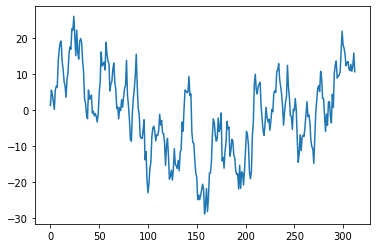

In [ ]:
plt.plot(left[0,0,:])

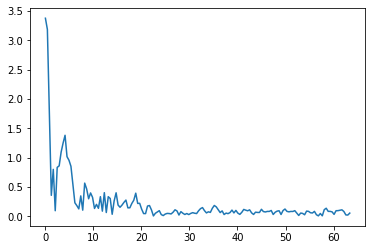

In [ ]:
fft = get_fft(np.hanning(313)*left[0,0,:])
plt.plot(fft[0], fft[1])

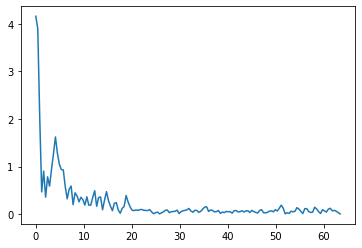

In [ ]:
fft = get_fft(np.hanning(313)*left[0,1,:])
plt.plot(fft[0], fft[1])

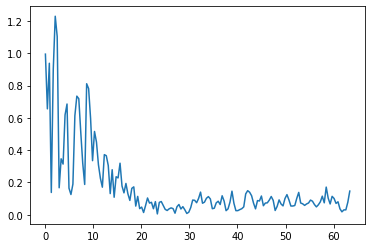

In [ ]:
fft = get_fft(np.hanning(313)*right[0,0,:])
plt.plot(fft[0], fft[1])

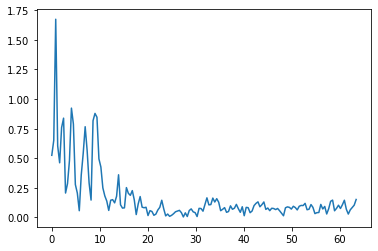

In [ ]:
fft = get_fft(np.hanning(313)*right[0,1,:])
plt.plot(fft[0], fft[1])

In [ ]:
fft[0].shape, fft[1].shape

((156,), (156,))

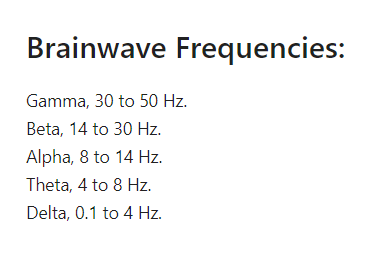

In [ ]:
def theta_alpha_beta_averages(f,Y):
    theta_range = (4,8)
    alpha_range = (8,14)
    beta_range = (14,30)
    gamma_range=(30,50)
    theta = Y[(f>theta_range[0]) & (f<=theta_range[1])].mean()
    alpha = Y[(f>alpha_range[0]) & (f<=alpha_range[1])].mean()
    beta = Y[(f>beta_range[0]) & (f<=beta_range[1])].mean()
    gamma = Y[(f>gamma_range[0]) & (f<=gamma_range[1])].mean()

    return theta, alpha, beta, gamma

In [ ]:
theta_alpha_beta_averages(fft[0], fft[1])

(0.4772549720002278,
 0.423464441586163,
 0.0885858350710753,
 0.07859107634842408)

In [ ]:
theta = []
alpha = []
beta = []
gamma = []
for i in range(len(signals[:,0])-10):
  f, Y = get_fft(signals[i:i+10, 0])
  freq = theta_alpha_beta_averages(f, Y)
  # print(freq)
  # print((freq[0]))
  # break
  theta.append(freq[0])
  alpha.append(freq[1])
  beta.append(freq[2])
  gamma.append(freq[3])

<ipython-input-40-486df618d0fc>:6: RuntimeWarning: Mean of empty slice.
  theta = Y[(f>theta_range[0]) & (f<=theta_range[1])].mean()


(0.0, 15.0)

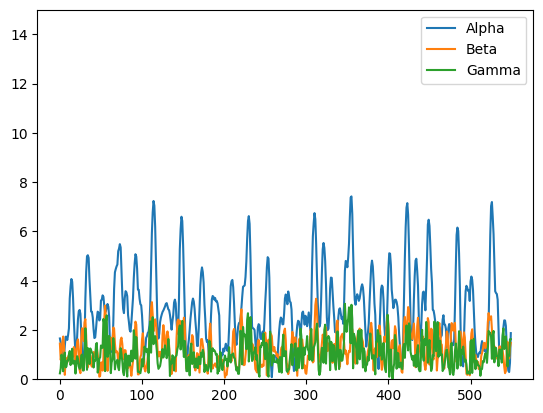

In [ ]:
plt.plot(alpha[92300:92850])
plt.plot(beta[92300:92850])
plt.plot(gamma[92300:92850])
plt.legend(['Alpha', 'Beta', 'Gamma'])
plt.ylim(top=15, bottom=0)

(0.0, 15.0)

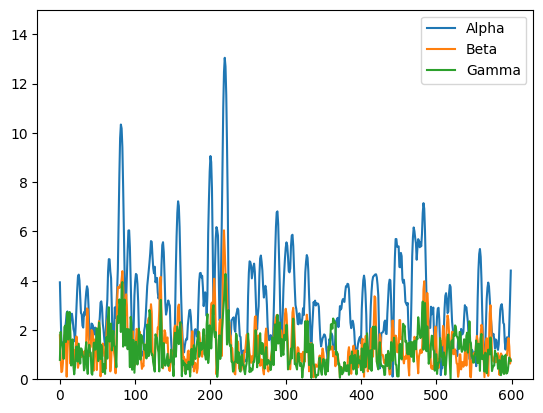

In [ ]:
plt.plot(alpha[300:900])
plt.plot(beta[300:900])
plt.plot(gamma[300:900])
plt.legend(['Alpha', 'Beta', 'Gamma'])
plt.ylim(top=15, bottom=0)

In [ ]:
def make_frames(df):
  frames = []
  for i in df:
      frame = []
      for channel in i:
          f,Y =  get_fft(channel)
          theta, alpha, beta, gamma = theta_alpha_beta_averages(f,Y)
          frame.append([theta, alpha, beta])

      frames.append(frame)
  return np.array(frames).reshape(df.shape[0], -1)

In [ ]:
left_frames = make_frames(left)
right_frames = make_frames(right)
foot_frames = make_frames(foot)
tongue_frames = make_frames(tongue)

In [ ]:
left_frames.shape, right_frames.shape, foot_frames.shape, tongue_frames.shape

((72, 66), (72, 66), (72, 66), (72, 66))

In [ ]:
# electrodes = np.array([(0.0, 4.0),
#                        (-4.0,2.0), (-2.0,2.0), (0.0,2.0), (2.0,2.0), (4.0,2.0),
#                        (-6.0, 0.0), (-4.0, 0.0), (-2.0,0.0), (0.0,0.0), (2.0,0.0), (4.0,0.0), (6.0, 0.0),
#                        (-4.0,-2.0), (-2.0,-2.0), (0.0,-2.0), (2.0,-2.0), (4.0,-2.0),
#                        (-2.0, -4.0), (0.0, -4.0), (2.0, -4.0),
#                        (0.0, -6.0)])

electrodes = np.array([(0.0, 2.67),
                       (-2.67,1.33), (-1.33,1.33), (0.0,1.33), (1.33,1.33), (2.67,1.33),
                       (-4.0, 0.0), (-2.67, 0.0), (-1.33,0.0), (0.0,0.0), (1.33,0.0), (2.67,0.0), (4.0, 0.0),
                       (-2.67,-1.33), (-1.33,-1.33), (0.0,-1.33), (1.33,-1.33), (2.67,-1.33),
                       (-1.33, -2.67), (0.0, -2.67), (1.33, -2.67),
                       (0.0, -4.0)])

In [ ]:
electrodes.shape

(22, 2)

In [ ]:
from scipy.interpolate import griddata
from sklearn.preprocessing import scale

def gen_images(locs, features, n_gridpoints=64, normalize=True, edgeless=False):
    """
    Generates EEG images given electrode locations in 2D space and multiple feature values for each electrode

    :param locs: An array with shape [n_electrodes, 2] containing X, Y
                        coordinates for each electrode.
    :param features: Feature matrix as [n_samples, n_features]
                                Features are as columns.
                                Features corresponding to each frequency band are concatenated.
                                (alpha1, alpha2, ..., beta1, beta2,...)
    :param n_gridpoints: Number of pixels in the output images
    :param normalize:   Flag for whether to normalize each band over all samples
    :param edgeless:    If True generates edgeless images by adding artificial channels
                        at four corners of the image with value = 0 (default=False).
    :return:            Tensor of size [samples, colors, W, H] containing generated
                        images.
    """
    feat_array_temp = []
    nElectrodes = locs.shape[0]     # Number of electrodes
    # Test whether the feature vector length is divisible by number of electrodes
    assert features.shape[1] % nElectrodes == 0
    n_colors = features.shape[1] / nElectrodes
    for c in range(int(n_colors)):
        feat_array_temp.append(features[:, c * nElectrodes : nElectrodes * (c+1)])
    nSamples = features.shape[0]
    # Interpolate the values
    grid_x, grid_y = np.mgrid[
                     min(locs[:, 0]):max(locs[:, 0]):n_gridpoints*1j,
                     min(locs[:, 1]):max(locs[:, 1]):n_gridpoints*1j
                     ]
    temp_interp = []
    for c in range(int(n_colors)):
        temp_interp.append(np.zeros([nSamples, n_gridpoints, n_gridpoints]))
    # Generate edgeless images
    if edgeless:
        min_x, min_y = np.min(locs, axis=0)
        max_x, max_y = np.max(locs, axis=0)
        locs = np.append(locs, np.array([[min_x, min_y], [min_x, max_y],[max_x, min_y],[max_x, max_y]]),axis=0)
        for c in range(int(n_colors)):
            feat_array_temp[c] = np.append(feat_array_temp[c], np.zeros((nSamples, 4)), axis=1)
    # Interpolating
    for i in range(nSamples):
        for c in range(int(n_colors)):
            temp_interp[c][i, :, :] = griddata(locs, feat_array_temp[c][i, :], (grid_x, grid_y),
                                    method='cubic', fill_value=np.nan)
        print('Interpolating {0}/{1}\r'.format(i+1, nSamples), end='\r')
    # Normalizing
    for c in range(int(n_colors)):
        if normalize:
            temp_interp[c][~np.isnan(temp_interp[c])] = \
                scale(temp_interp[c][~np.isnan(temp_interp[c])])
        temp_interp[c] = np.nan_to_num(temp_interp[c])
    return np.swapaxes(np.asarray(temp_interp), 0, 1)     # swap axes to have [samples, colors, W, H]

In [ ]:
left_images = gen_images(np.array(electrodes), left_frames, normalize=False)
right_images = gen_images(np.array(electrodes), right_frames, normalize=False)
foot_images = gen_images(np.array(electrodes), foot_frames, normalize=False)
tongue_images = gen_images(np.array(electrodes), tongue_frames, normalize=False)

In [ ]:
left_images_1 = left_images + -1*left_images.min()
left_images_1 = left_images_1/left_images_1.max()
left_images_1 = (left_images_1 * 255.0).astype('u1')

right_images_1 = left_images + -1*left_images.min()
right_images_1 = right_images_1/right_images_1.max()
right_images_1 = (right_images_1 * 255.0).astype('u1')

foot_images_1 = left_images + -1*left_images.min()
foot_images_1 = foot_images_1/foot_images_1.max()
foot_images_1 = (foot_images_1 * 255.0).astype('u1')

tongue_images_1 = left_images + -1*left_images.min()
tongue_images_1 = tongue_images_1/tongue_images_1.max()
tongue_images_1 = (tongue_images_1 * 255.0).astype('u1')

In [ ]:
left_images_1.shape

(72, 3, 64, 64)

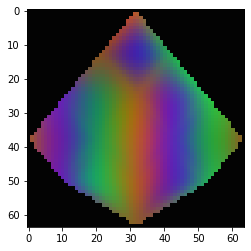

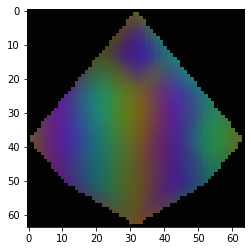

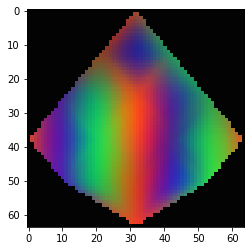

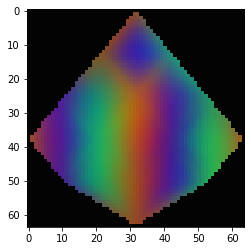

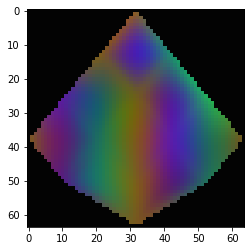

...

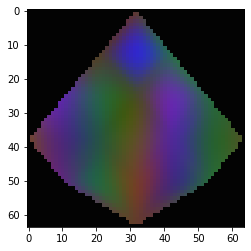

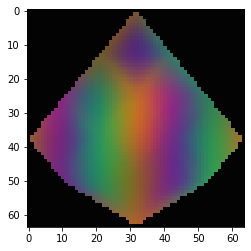

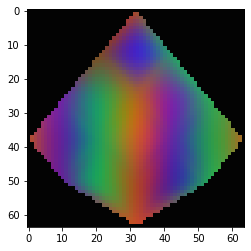

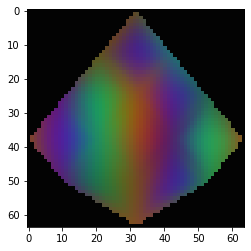

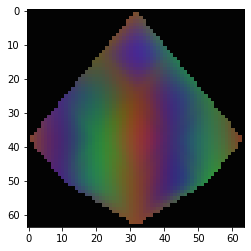

In [ ]:
for i in left_images_1:
  plt.imshow(i.T)
  plt.show()

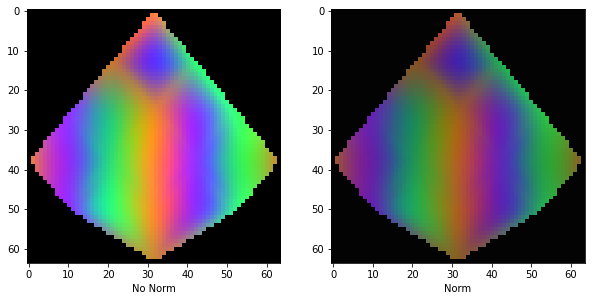

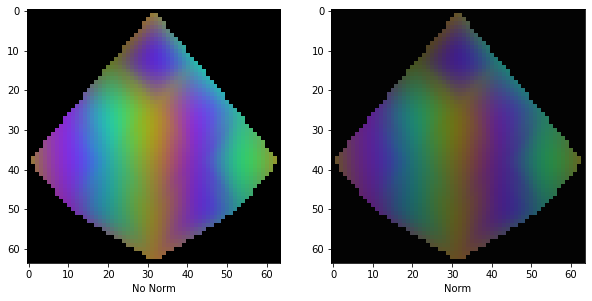

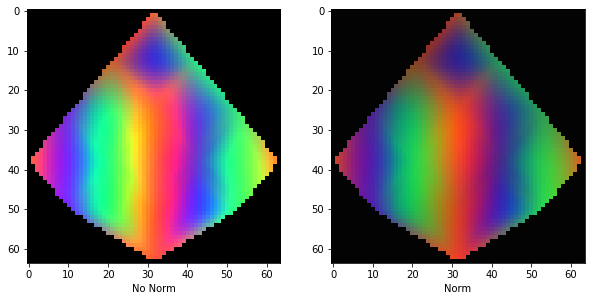

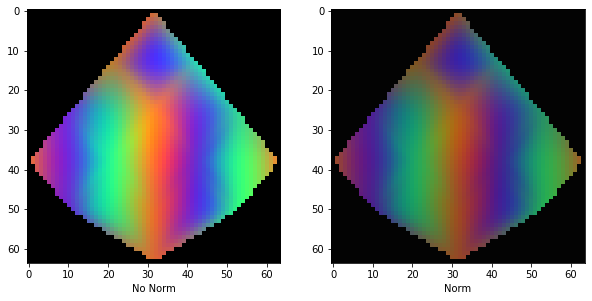

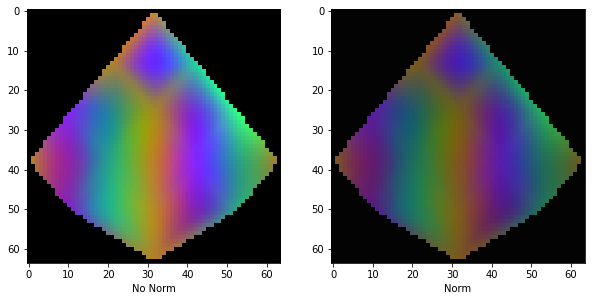

...

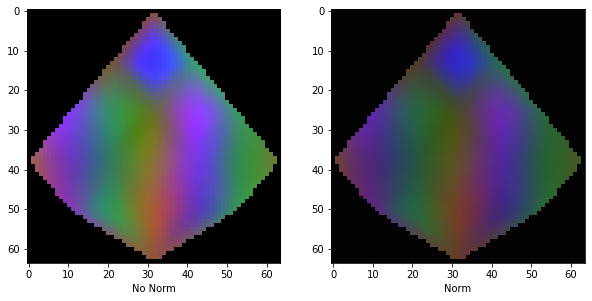

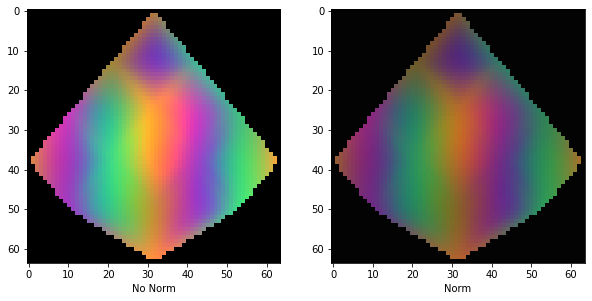

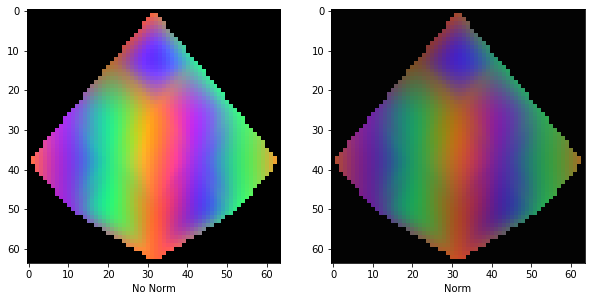

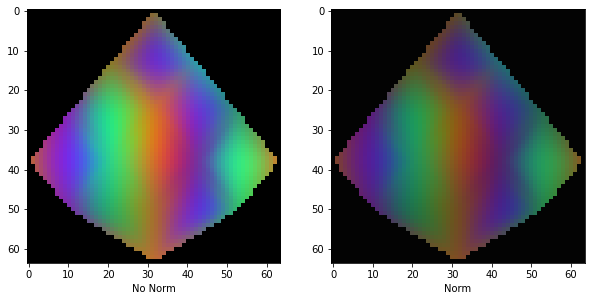

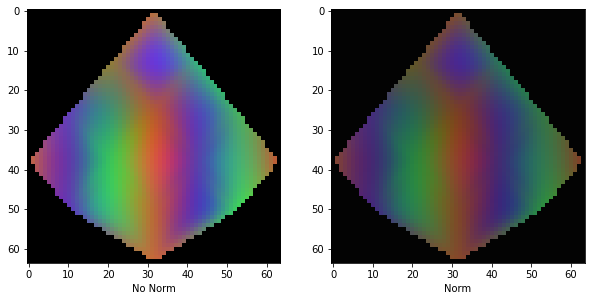

In [ ]:
for i in range(len(left_images_1)):
  fig, ax = plt.subplots(1, 2, figsize=(10,10))
  ax[0].set_xlabel('No Norm')
  ax[0].imshow(left_images[i].T)
  ax[1].set_xlabel('Norm')
  ax[1].imshow(left_images_1[i].T)
  plt.show()

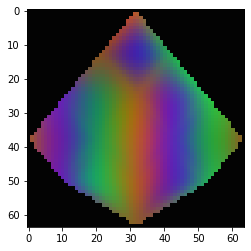

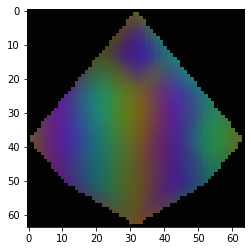

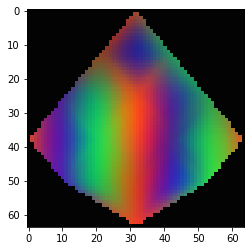

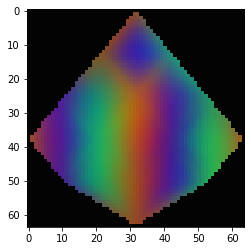

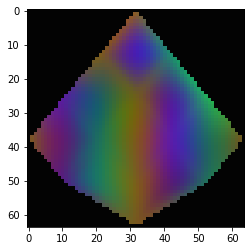

...

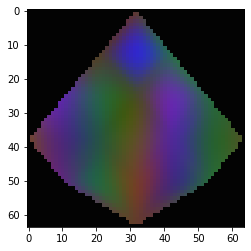

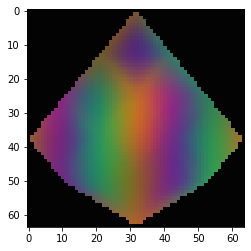

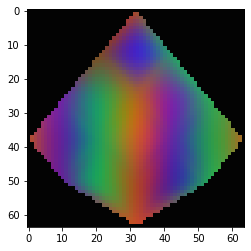

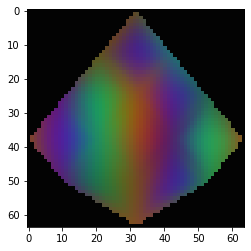

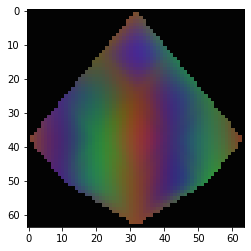

In [ ]:
for i in right_images_1:
  plt.imshow(i.T)
  plt.show()

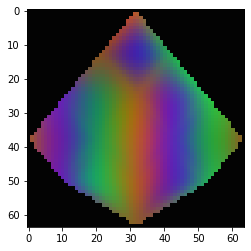

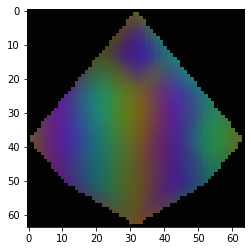

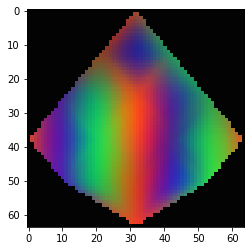

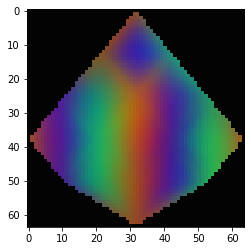

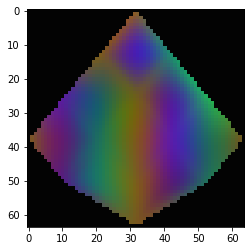

...

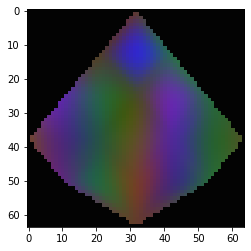

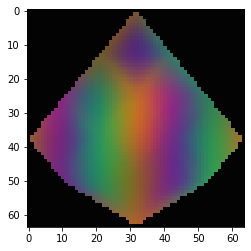

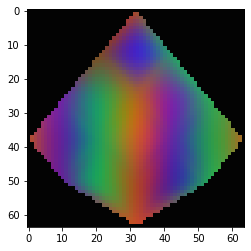

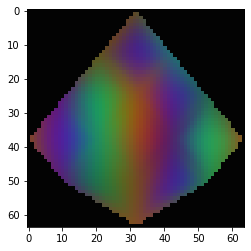

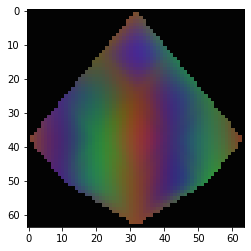

In [ ]:
for i in foot_images_1:
  plt.imshow(i.T)
  plt.show()

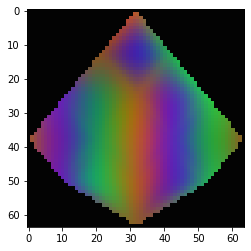

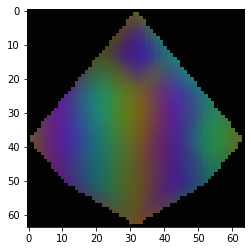

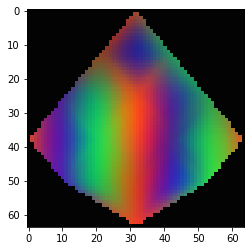

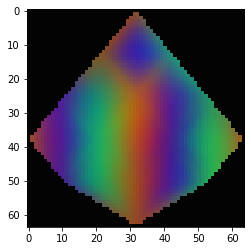

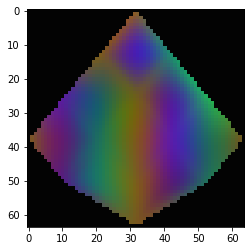

...

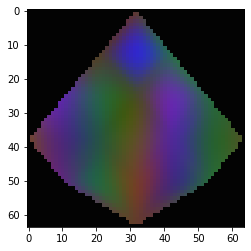

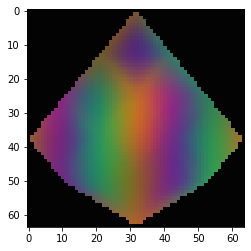

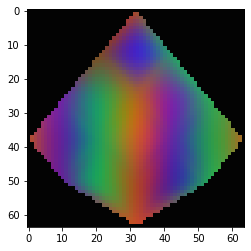

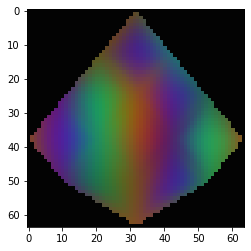

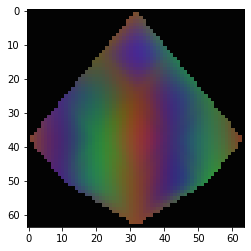

In [ ]:
for i in tongue_images_1:
  plt.imshow(i.T)
  plt.show()

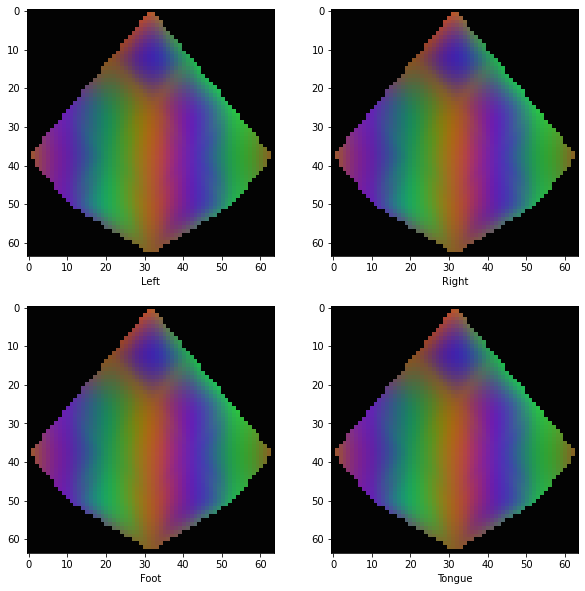

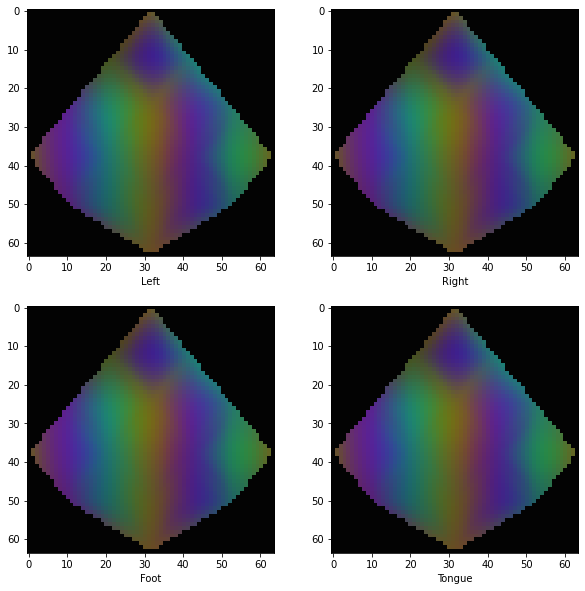

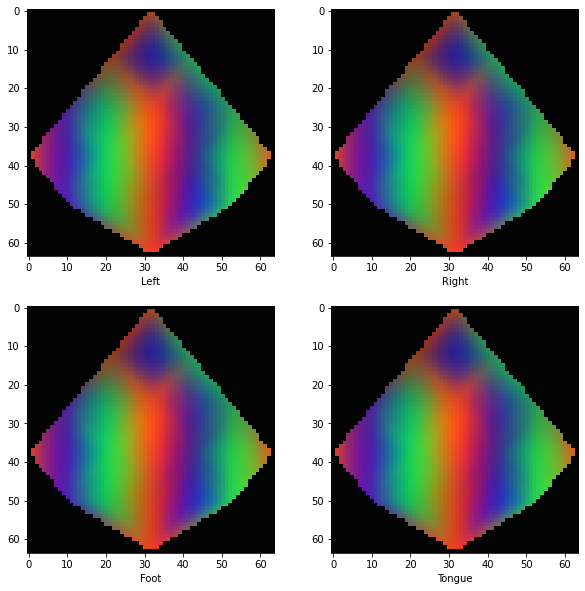

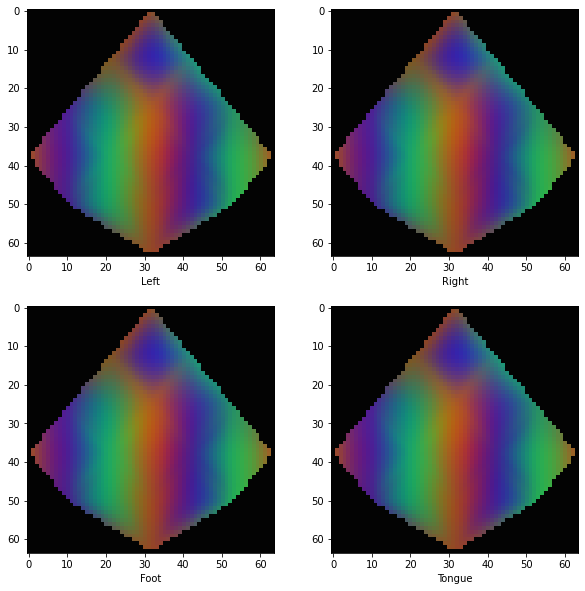

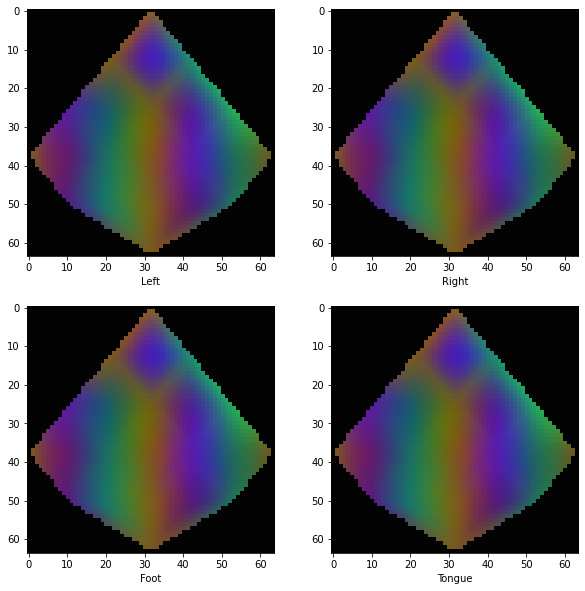

...

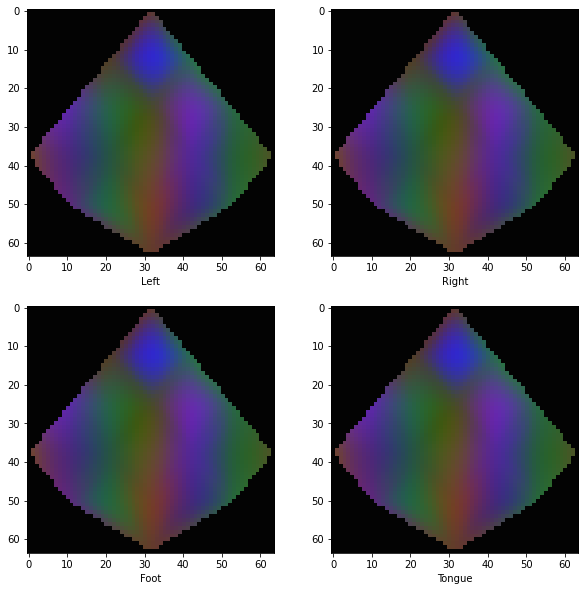

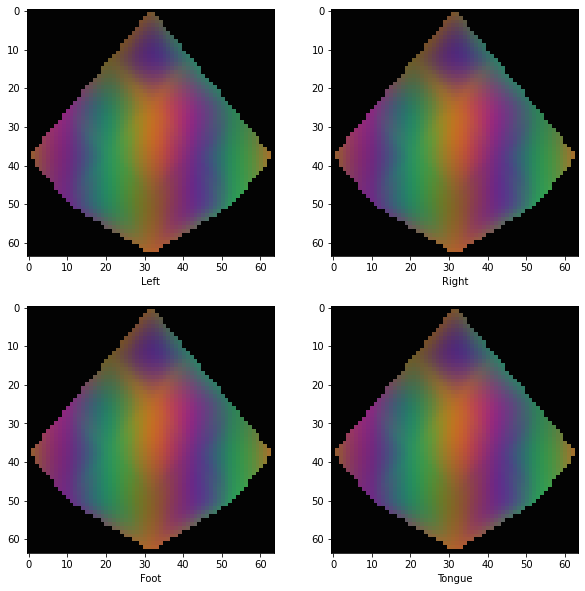

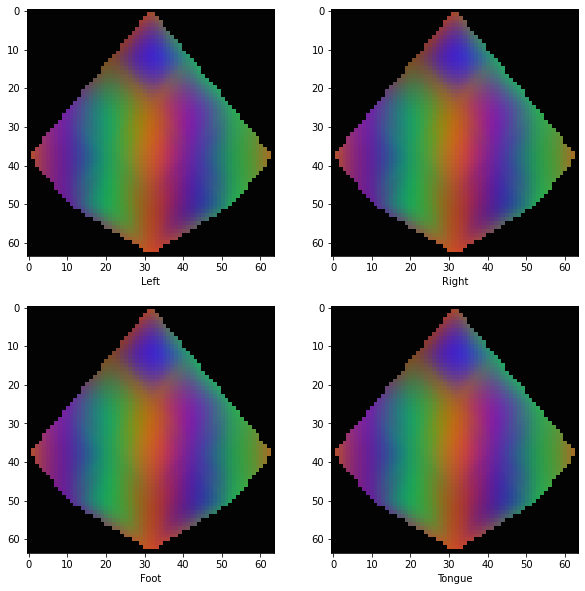

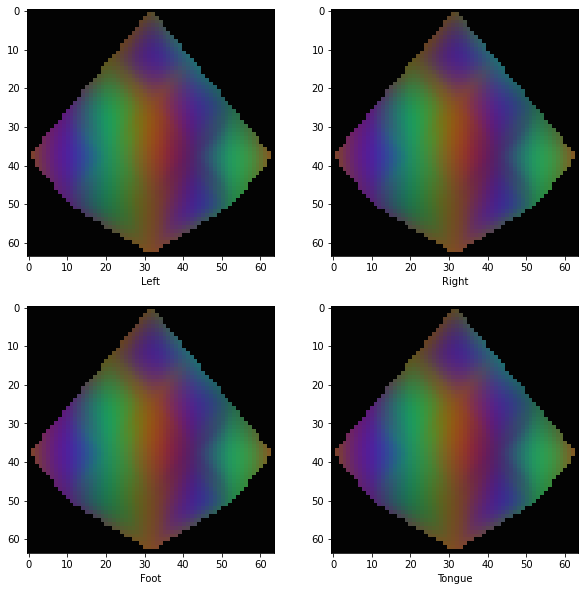

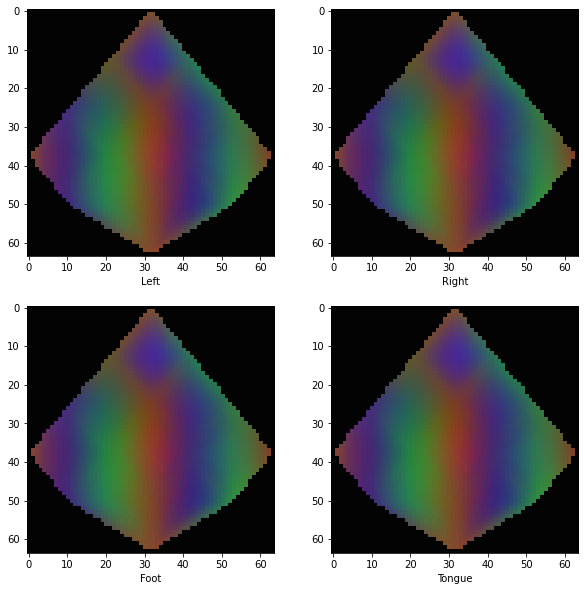

In [ ]:
for i in range(72):
  fig, ax = plt.subplots(2, 2, figsize=(10,10))
  ax[0,0].set_xlabel('Left')
  ax[0,0].imshow(left_images_1[i].T)
  ax[0,1].set_xlabel('Right')
  ax[0,1].imshow(right_images_1[i].T)
  ax[1,0].set_xlabel('Foot')
  ax[1,0].imshow(foot_images_1[i].T)
  ax[1,1].set_xlabel('Tongue')
  ax[1,1].imshow(tongue_images_1[i].T)
  plt.show()

# Generate Classification Dataset for modelling

In [ ]:
from scipy.interpolate import griddata
from sklearn.preprocessing import scale
import numpy as np

def generate_bci_image_dataset(file_path, electrode_locations, image_size=64):
  # Parameters:
  # # file_path: String or Iterable containing paths to bci signals npz files
  # # electrode_locations: Relative positions of electrodes that map signal locations of the brain
  # # image_size: No. of pixels defining a side of a square image
  # Returns:
  # # 2D Array containing randomized signals and labels

  def segment_data(signals, etype, epos, edur):
    left = [] # 769
    right = [] # 770
    foot = [] # 771
    tongue = [] # 772

    for i in range(len(etype)):
      channels = []
      for sig in signals.T:
        channels.append(sig[epos[i,0] : epos[i,0] + edur[i,0]])
      if etype[i,0] == 769:
        left.append(channels[:22])
      elif etype[i,0] == 770:
        right.append(channels[:22])
      elif etype[i,0] == 771:
        foot.append(channels[:22])
      elif etype[i,0] == 772:
        tongue.append(channels[:22])
    return [np.array(left), np.array(right), np.array(foot), np.array(tongue)]

  def get_fft(snippet):
    Fs = 128.0;  # sampling rate
    snippet_time = len(snippet)/Fs
    Ts = 1.0/Fs; # sampling interval
    t = np.arange(0,snippet_time,Ts) # time vector
    y = snippet
    n = len(y) # length of the signal
    k = np.arange(n)
    T = n/Fs
    frq = k/T # two sides frequency range
    frq = frq[range(int(n/2))] # one side frequency range

    Y = np.fft.fft(y)/n # fft computing and normalization
    Y = Y[range(int(n/2))]
    return frq,abs(Y)

  def theta_alpha_beta_averages(f,Y):
    theta_range = (4,8)
    alpha_range = (8,12)
    beta_range = (12,40)
    gamma_range=(40,60)
    theta = Y[(f>theta_range[0]) & (f<=theta_range[1])].mean()
    alpha = Y[(f>alpha_range[0]) & (f<=alpha_range[1])].mean()
    beta = Y[(f>beta_range[0]) & (f<=beta_range[1])].mean()
    gamma = Y[(f>gamma_range[0]) & (f<=gamma_range[1])].mean()
    return theta, alpha, beta, gamma

  def make_frames(df):
    frames = []
    for i in df:
        frame = []
        for channel in i:
            f,Y =  get_fft(channel)
            theta, alpha, beta, gamma = theta_alpha_beta_averages(f,Y)
            frame.append([theta, alpha, beta])

        frames.append(frame)
    return np.array(frames).reshape(df.shape[0], -1)

  def gen_images(locs, features, n_gridpoints=64, normalize=True, edgeless=False):
    """
    Generates EEG images given electrode locations in 2D space and multiple feature values for each electrode

    :param locs: An array with shape [n_electrodes, 2] containing X, Y
                        coordinates for each electrode.
    :param features: Feature matrix as [n_samples, n_features]
                                Features are as columns.
                                Features corresponding to each frequency band are concatenated.
                                (alpha1, alpha2, ..., beta1, beta2,...)
    :param n_gridpoints: Number of pixels in the output images
    :param normalize:   Flag for whether to normalize each band over all samples
    :param edgeless:    If True generates edgeless images by adding artificial channels
                        at four corners of the image with value = 0 (default=False).
    :return:            Tensor of size [samples, colors, W, H] containing generated
                        images.
    """
    feat_array_temp = []
    nElectrodes = locs.shape[0]     # Number of electrodes
    # Test whether the feature vector length is divisible by number of electrodes
    assert features.shape[1] % nElectrodes == 0
    n_colors = features.shape[1] / nElectrodes
    for c in range(int(n_colors)):
        feat_array_temp.append(features[:, c * nElectrodes : nElectrodes * (c+1)])
    nSamples = features.shape[0]
    # Interpolate the values
    grid_x, grid_y = np.mgrid[
                     min(locs[:, 0]):max(locs[:, 0]):n_gridpoints*1j,
                     min(locs[:, 1]):max(locs[:, 1]):n_gridpoints*1j
                     ]
    temp_interp = []
    for c in range(int(n_colors)):
        temp_interp.append(np.zeros([nSamples, n_gridpoints, n_gridpoints]))
    # Generate edgeless images
    if edgeless:
        min_x, min_y = np.min(locs, axis=0)
        max_x, max_y = np.max(locs, axis=0)
        locs = np.append(locs, np.array([[min_x, min_y], [min_x, max_y],[max_x, min_y],[max_x, max_y]]),axis=0)
        for c in range(int(n_colors)):
            feat_array_temp[c] = np.append(feat_array_temp[c], np.zeros((nSamples, 4)), axis=1)
    # Interpolating
    for i in range(nSamples):
        for c in range(int(n_colors)):
            temp_interp[c][i, :, :] = griddata(locs, feat_array_temp[c][i, :], (grid_x, grid_y),
                                    method='cubic', fill_value=np.nan)
        print('Interpolating {0}/{1}\r'.format(i+1, nSamples), end='\r')
    # Normalizing
    for c in range(int(n_colors)):
        if normalize:
            temp_interp[c][~np.isnan(temp_interp[c])] = \
                scale(temp_interp[c][~np.isnan(temp_interp[c])])
        temp_interp[c] = np.nan_to_num(temp_interp[c])
    return np.swapaxes(np.asarray(temp_interp), 0, 1)     # swap axes to have [samples, colors, W, H]

  def generate_dataset(data):
    signals = data['s']
    etype = data['etyp']
    epos = data['epos']
    edur = data['edur']

    left, right, foot, tongue = segment_data(signals, etype, epos, edur)

    left_frames = make_frames(left)
    right_frames = make_frames(right)
    foot_frames = make_frames(foot)
    tongue_frames = make_frames(tongue)

    left_images = gen_images(np.array(electrode_locations), left_frames,  normalize=False, n_gridpoints=image_size)
    right_images = gen_images(np.array(electrode_locations), right_frames, normalize=False, n_gridpoints=image_size)
    foot_images = gen_images(np.array(electrode_locations), foot_frames, normalize=False, n_gridpoints=image_size)
    tongue_images = gen_images(np.array(electrode_locations), tongue_frames, normalize=False, n_gridpoints=image_size)

    label_data = []
    for index, sets in enumerate([left_images, right_images, foot_images, tongue_images]):
      sets_ = sets
      sets_ = sets_ + -1*sets.min()
      sets_ = sets_/sets_.max()
      sets_ = (sets_ * 255.0).astype('u1')
      for i in range(len(sets_)):
        label_data.append(np.array([sets_[i].T, index], dtype=object))

    label_data = np.array(label_data)

    label_signals = []
    for index, sets in enumerate([left, right, foot, tongue]):
      for sigset in sets:
        label_signals.append(np.array([sigset, index], dtype=object))

    label_signals = np.array(label_signals)

    img_train, img_test = [], []
    for i in range(4):
      seg = label_data[72*i : 72*(i+1)]
      img_train.append(seg[:54])
      img_test.append(seg[54:])

    img_train = np.array(img_train).reshape(-1,2)
    img_test = np.array(img_test).reshape(-1,2)

    np.random.shuffle(img_train)
    np.random.shuffle(img_test)

    images = np.array([img_train, img_test], dtype=object)

    sig_train, sig_test = [], []
    for i in range(4):
      seg = label_data[72*i : 72*(i+1)]
      sig_train.append(seg[:54])
      sig_test.append(seg[54:])

    sig_train = np.array(sig_train).reshape(-1,2)
    sig_test = np.array(sig_test).reshape(-1,2)

    np.random.shuffle(sig_train)
    np.random.shuffle(sig_test)

    signals = np.array([sig_train, sig_test], dtype=object)

    return [images, signals]

  if type(file_path) is str:
    data = np.load(file_path)
    data = generate_dataset(data)
    return data

  else:
    print('Needs rework! Do not use!')
    # concat_data = []
    # for path in file_path:
    #   data = np.load(path)
    #   gen_data = generate_dataset(data)
    #   if not len(concat_data) == 0:
    #     concat_data[0] = np.concatenate([concat_data[0], gen_data[0]])
    #     concat_data[1] = np.concatenate([concat_data[1], gen_data[1]])
    #   else: concat_data = gen_data
    # return concat_data


In [ ]:
# electrodes = np.array([(0.0, 4.0),
#                        (-4.0,2.0), (-2.0,2.0), (0.0,2.0), (2.0,2.0), (4.0,2.0),
#                        (-6.0, 0.0), (-4.0, 0.0), (-2.0,0.0), (0.0,0.0), (2.0,0.0), (4.0,0.0), (6.0, 0.0),
#                        (-4.0,-2.0), (-2.0,-2.0), (0.0,-2.0), (2.0,-2.0), (4.0,-2.0),
#                        (-2.0, -4.0), (0.0, -4.0), (2.0, -4.0),
#                        (0.0, -6.0)])

electrodes = np.array([(0.0, 2.67),
                       (-2.67,1.33), (-1.33,1.33), (0.0,1.33), (1.33,1.33), (2.67,1.33),
                       (-4.0, 0.0), (-2.67, 0.0), (-1.33,0.0), (0.0,0.0), (1.33,0.0), (2.67,0.0), (4.0, 0.0),
                       (-2.67,-1.33), (-1.33,-1.33), (0.0,-1.33), (1.33,-1.33), (2.67,-1.33),
                       (-1.33, -2.67), (0.0, -2.67), (1.33, -2.67),
                       (0.0, -4.0)])

# electrodes = np.array([                                       (0.0, 2.83),
#                                     (-2.33,1.5), (-1.33,1.5), (0.0, 1.5), (1.33,1.5), (2.33,1.5),
#                       (-3.83, 0.0), (-2.83, 0.0), (-1.5,0.0), (0.0, 0.00), (1.5,0.0), (2.83,0.0), (3.83, 0.0),
#                                   (-2.08,-1.5), (-1.33,-1.5), (0.0, -1.5), (1.33,-1.5), (2.08,-1.5),
#                                                 (-1.0, -2.5), (0.0, -2.5), (1.0, -2.5),
#                                                               (0.0, -3.0)])

In [ ]:
images = generate_bci_image_dataset(
    # [
    '/content/drive/MyDrive/MP Datasets/A01T.npz',
    # '/content/drive/MyDrive/MP Datasets/A02T.npz',
    # '/content/drive/MyDrive/MP Datasets/A03T.npz',
    # '/content/drive/MyDrive/MP Datasets/A04T.npz',
    # '/content/drive/MyDrive/MP Datasets/A05T.npz',
    # '/content/drive/MyDrive/MP Datasets/A06T.npz',
    # '/content/drive/MyDrive/MP Datasets/A07T.npz',
    # '/content/drive/MyDrive/MP Datasets/A08T.npz',
    # '/content/drive/MyDrive/MP Datasets/A09T.npz'
    # ],
     electrodes, image_size=128)
images[0].shape, images[1].shape

((2,), (2,))

In [ ]:
images[0][0].shape, images[0][1].shape

((216, 2), (72, 2))

In [ ]:
def get_optimal_model_lr(model, loss, optimizer, batch_size, epochs):
  callback = tf.keras.callbacks.LearningRateScheduler(lambda epoch: 1e-5*10**(epoch/20))

  model.compile(loss=loss, metrics=['accuracy'], optimizer=optimizer)

  history = model.fit(x_train, y_train, batch_size=batch_size, epochs=epochs, verbose=1, callbacks=[callback])

  plt.semilogx(history.history["lr"], history.history["loss"])
  plt.axis([1e-5, 5, 0, 4])

# CNN Models

In [ ]:
train, test = images[0][:3*int(len(images[0])/4)], images[0][3*int(len(images[0])/4):]

In [ ]:
train.shape, test.shape

((1944, 2), (648, 2))

In [ ]:
x_train, y_train = np.array([x for x in train[:, 0]]), train[:, 1]
x_test, y_test = np.array([x for x in test[:, 0]]), test[:, 1]

In [ ]:
x_train, x_test = x_train.astype(np.float32), x_test.astype(np.float32)
y_train, y_test = y_train.astype(np.float32), y_test.astype(np.float32)

In [ ]:
from sklearn.preprocessing import OneHotEncoder
y_train = OneHotEncoder().fit_transform(y_train.reshape(-1,1)).toarray()
y_test = OneHotEncoder().fit_transform(y_test.reshape(-1,1)).toarray()

In [ ]:
x_train.shape

(1944, 128, 128, 3)

In [ ]:
y_train.shape

(1944, 4)

In [ ]:
y_train[0]

array([0., 0., 0., 1.])

## v1 (AlexNet Custom)

In [ ]:
def get_model_v1():
  model = tf.keras.models.Sequential()
  model.add(tf.keras.layers.Conv2D(96, kernel_size=3, padding="same", activation="relu", input_shape=(128,128,3)))
  model.add(tf.keras.layers.MaxPooling2D(pool_size=(3,3), strides=2, padding="same"))
  model.add(tf.keras.layers.Conv2D(256, kernel_size=5, padding="same", activation="relu",))
  model.add(tf.keras.layers.MaxPooling2D(pool_size=(3,3), strides=2, padding="same"))
  model.add(tf.keras.layers.Conv2D(384, kernel_size=3, padding="same", activation="relu",))
  model.add(tf.keras.layers.Conv2D(16, kernel_size=1, padding="same", activation="relu"))
  model.add(tf.keras.layers.Conv2D(384, kernel_size=3, padding="same", activation="relu",))
  model.add(tf.keras.layers.Conv2D(16, kernel_size=1, padding="same", activation="relu"))
  model.add(tf.keras.layers.Conv2D(256, kernel_size=3, padding="same", activation="relu",))
  model.add(tf.keras.layers.MaxPooling2D(pool_size=(3,3), strides=2, padding="same"))
  model.add(tf.keras.layers.Flatten())
  # model.add(tf.keras.layers.Dropout(0.5))
  model.add(tf.keras.layers.Dense(512, activation='relu'))
  # model.add(tf.keras.layers.Dropout(0.2))
  model.add(tf.keras.layers.Dense(4, activation='softmax'))
  return model

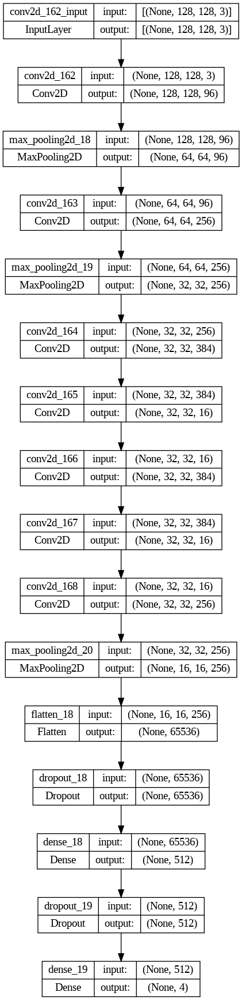

In [ ]:
tf.keras.utils.plot_model(get_model_v1(), show_shapes=True)

Epoch 1/100
7/7 [==============================] - 4s 102ms/step - loss: 1.9311 - accuracy: 0.2269 - lr: 1.0000e-04
Epoch 2/100
7/7 [==============================] - 1s 91ms/step - loss: 1.3869 - accuracy: 0.2407 - lr: 1.1220e-04
Epoch 3/100
7/7 [==============================] - 1s 88ms/step - loss: 1.3596 - accuracy: 0.3657 - lr: 1.2589e-04
Epoch 4/100
7/7 [==============================] - 1s 91ms/step - loss: 1.2269 - accuracy: 0.4583 - lr: 1.4125e-04
Epoch 5/100
7/7 [==============================] - 1s 89ms/step - loss: 0.9381 - accuracy: 0.4954 - lr: 1.5849e-04
Epoch 6/100
7/7 [==============================] - 1s 89ms/step - loss: 0.7071 - accuracy: 0.5787 - lr: 1.7783e-04
Epoch 7/100
7/7 [==============================] - 1s 88ms/step - loss: 0.7520 - accuracy: 0.6620 - lr: 1.9953e-04
Epoch 8/100
7/7 [==============================] - 1s 87ms/step - loss: 0.7420 - accuracy: 0.6065 - lr: 2.2387e-04
Epoch 9/100
7/7 [==============================] - 1s 87ms/step - loss: 0.6757 

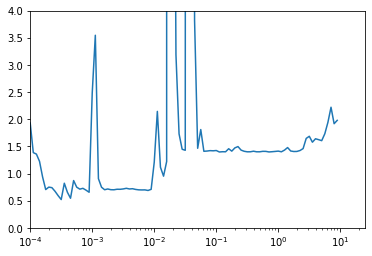

In [ ]:
get_optimal_model_lr(get_model_v1(), 'categorical_crossentropy', 'adam', 32, 100)

In [ ]:
model = get_model_v1()
model.compile(loss='categorical_crossentropy', metrics=["accuracy"], optimizer=tf.keras.optimizers.Adam(2e-4))
model.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_42 (Conv2D)          (None, 128, 128, 96)      2688      
                                                                 
 max_pooling2d_18 (MaxPoolin  (None, 64, 64, 96)       0         
 g2D)                                                            
                                                                 
 conv2d_43 (Conv2D)          (None, 64, 64, 256)       614656    
                                                                 
 max_pooling2d_19 (MaxPoolin  (None, 32, 32, 256)      0         
 g2D)                                                            
                                                                 
 conv2d_44 (Conv2D)          (None, 32, 32, 384)       885120    
                                                                 
 conv2d_45 (Conv2D)          (None, 32, 32, 16)       

In [ ]:
history = model.fit(x_train, y_train, batch_size=50, epochs=100, verbose=1, validation_data=(x_test, y_test))

Epoch 1/100
5/5 [==============================] - 6s 802ms/step - loss: 3.5421 - accuracy: 0.1944 - val_loss: 2.3308 - val_accuracy: 0.2500
Epoch 2/100
5/5 [==============================] - 1s 153ms/step - loss: 1.6442 - accuracy: 0.2685 - val_loss: 1.3906 - val_accuracy: 0.2917
Epoch 3/100
5/5 [==============================] - 1s 149ms/step - loss: 1.3907 - accuracy: 0.2963 - val_loss: 1.3701 - val_accuracy: 0.2778
Epoch 4/100
5/5 [==============================] - 1s 150ms/step - loss: 1.3633 - accuracy: 0.4306 - val_loss: 1.3592 - val_accuracy: 0.4306
Epoch 5/100
5/5 [==============================] - 1s 151ms/step - loss: 1.3265 - accuracy: 0.3981 - val_loss: 1.2620 - val_accuracy: 0.4028
Epoch 6/100
5/5 [==============================] - 1s 155ms/step - loss: 1.1958 - accuracy: 0.5231 - val_loss: 1.0758 - val_accuracy: 0.5139
Epoch 7/100
5/5 [==============================] - 1s 174ms/step - loss: 0.9765 - accuracy: 0.5556 - val_loss: 0.8987 - val_accuracy: 0.4583
Epoch 8/100
5

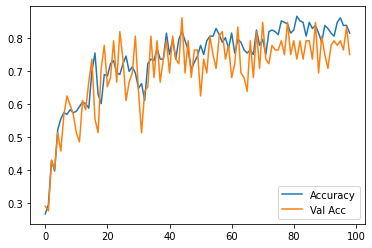

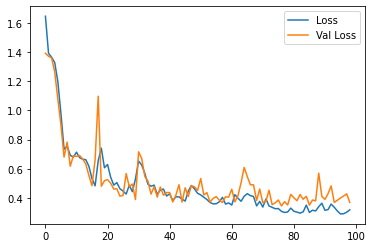

In [ ]:
plt.plot(history.history['accuracy'][1:])
plt.plot(history.history['val_accuracy'][1:])
plt.legend(['Accuracy', 'Val Acc'])
plt.show()

plt.plot(history.history['loss'][1:])
plt.plot(history.history['val_loss'][1:])
plt.legend(['Loss', 'Val Loss'])
plt.show()

## v2 (Resnet Custom)

In [ ]:
def resnet_layer(x, kernel_size=3, filters=28, split=False):
  if split:
    f_x = tf.keras.layers.Conv2D(filters, kernel_size=kernel_size, strides=2, padding="same")(x)
  else:
    f_x = tf.keras.layers.Conv2D(filters, kernel_size=kernel_size, strides=1, padding="same")(x)
  f_x = tf.keras.layers.BatchNormalization()(f_x)
  f_x = tf.keras.layers.Activation(tf.keras.activations.relu)(f_x)

  f_x = tf.keras.layers.Conv2D(filters, kernel_size=kernel_size, strides=1, padding="same")(f_x)
  f_x = tf.keras.layers.BatchNormalization()(f_x)
  f_x = tf.keras.layers.Activation(tf.keras.activations.relu)(f_x)

  if split:
    x = tf.keras.layers.Conv2D(filters, kernel_size=kernel_size, strides=2, padding="same")(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation(tf.keras.activations.relu)(x)

  f_x = tf.keras.layers.Add()([f_x, x])
  return f_x

def resnet():
  inputs = tf.keras.layers.Input(shape=(128, 128, 3))

  x = resnet_layer(inputs, kernel_size=3, filters=64, split=True)
  x = resnet_layer(x, kernel_size=3, filters=64, split=False)
  x = resnet_layer(x, kernel_size=3, filters=64, split=False)
  x = resnet_layer(x, kernel_size=3, filters=64, split=False)

  x = tf.keras.layers.MaxPooling2D(pool_size=(3,3), strides=2, padding="same")(x)

  y = tf.keras.layers.Flatten()(x)

  y = tf.keras.layers.Dropout(0.5)(y)

  outputs = tf.keras.layers.Dense(4, activation='softmax')(y)

  model = tf.keras.models.Model(inputs = inputs, outputs = outputs)

  return model

Epoch 1/100
9/9 [==============================] - 26s 107ms/step - loss: 186.7432 - accuracy: 0.2731 - lr: 1.0000e-04
Epoch 2/100
9/9 [==============================] - 1s 83ms/step - loss: 67.7108 - accuracy: 0.2778 - lr: 1.1220e-04
Epoch 3/100
9/9 [==============================] - 1s 85ms/step - loss: 52.8690 - accuracy: 0.3657 - lr: 1.2589e-04
Epoch 4/100
9/9 [==============================] - 1s 84ms/step - loss: 95.8056 - accuracy: 0.3843 - lr: 1.4125e-04
Epoch 5/100
9/9 [==============================] - 1s 83ms/step - loss: 118.6883 - accuracy: 0.2824 - lr: 1.5849e-04
Epoch 6/100
9/9 [==============================] - 1s 84ms/step - loss: 101.8132 - accuracy: 0.2685 - lr: 1.7783e-04
Epoch 7/100
9/9 [==============================] - 1s 86ms/step - loss: 134.0923 - accuracy: 0.3611 - lr: 1.9953e-04
Epoch 8/100
9/9 [==============================] - 1s 89ms/step - loss: 91.6501 - accuracy: 0.4167 - lr: 2.2387e-04
Epoch 9/100
9/9 [==============================] - 1s 88ms/step - 

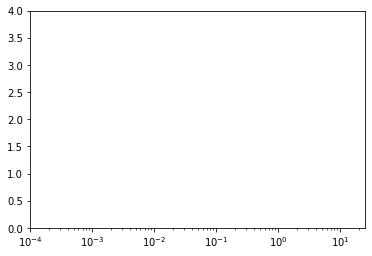

In [ ]:
get_optimal_model_lr(resbeats(), 'categorical_crossentropy', 'adam', 25, 100)

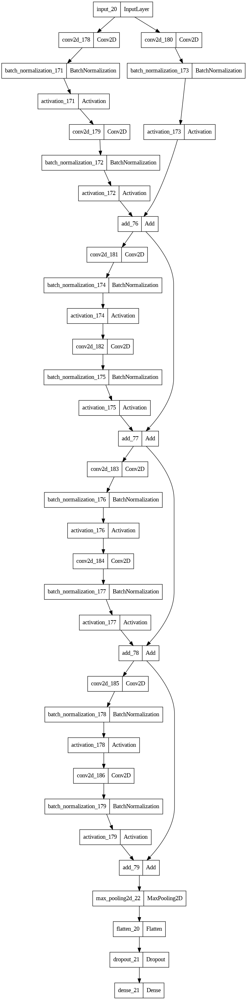

In [ ]:
tf.keras.utils.plot_model(resnet())

In [ ]:
model = resnet()
model.compile(loss='categorical_crossentropy', metrics=["accuracy"], optimizer=tf.keras.optimizers.Adam(1e-5))
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 64, 64, 64)   1792        ['input_1[0][0]']                
                                                                                                  
 batch_normalization (BatchNorm  (None, 64, 64, 64)  256         ['conv2d[0][0]']                 
 alization)                                                                                       
                                                                                              

In [ ]:
history = model.fit(x_train, y_train, batch_size=25, epochs=100, verbose=1, validation_data=(x_test, y_test))

Epoch 1/100
9/9 [==============================] - 27s 196ms/step - loss: 22.9653 - accuracy: 0.3009 - val_loss: 52.7343 - val_accuracy: 0.2778
Epoch 2/100
9/9 [==============================] - 1s 98ms/step - loss: 8.4869 - accuracy: 0.3657 - val_loss: 29.6099 - val_accuracy: 0.2778
Epoch 3/100
9/9 [==============================] - 1s 97ms/step - loss: 4.3027 - accuracy: 0.3472 - val_loss: 26.8975 - val_accuracy: 0.2778
Epoch 4/100
9/9 [==============================] - 1s 105ms/step - loss: 3.0253 - accuracy: 0.4815 - val_loss: 16.4343 - val_accuracy: 0.2361
Epoch 5/100
9/9 [==============================] - 1s 105ms/step - loss: 2.0061 - accuracy: 0.5093 - val_loss: 13.4642 - val_accuracy: 0.2361
Epoch 6/100
9/9 [==============================] - 1s 105ms/step - loss: 1.9704 - accuracy: 0.5139 - val_loss: 15.8090 - val_accuracy: 0.2361
Epoch 7/100
9/9 [==============================] - 1s 96ms/step - loss: 2.0805 - accuracy: 0.4676 - val_loss: 11.0121 - val_accuracy: 0.2361
Epoch 8

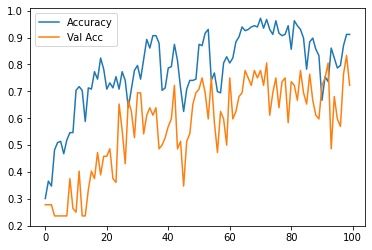

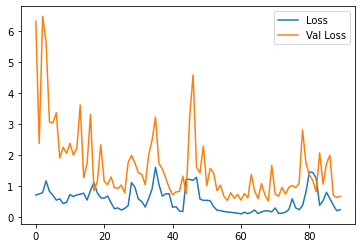

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.legend(['Accuracy', 'Val Acc'])
plt.show()

plt.plot(history.history['loss'][10:])
plt.plot(history.history['val_loss'][10:])
plt.legend(['Loss', 'Val Loss'])
plt.show()

In [ ]:
model_check = resbeats()

In [ ]:
model_check.compile(loss='categorical_crossentropy', metrics=["accuracy"], optimizer=tf.keras.optimizers.Adam(1e-4))
model_check.fit(x_train, y_train, batch_size=25, epochs=100, verbose=0, validation_data=(x_test, y_test))

In [ ]:
model_check.predict(np.array([x_train[0]])), y_train[0]

1/1 [==============================] - 1s 643ms/step


(array([[9.7384363e-16, 1.0472653e-27, 1.0860713e-27, 1.0000000e+00]],
       dtype=float32), array([0., 0., 0., 1.]))

In [ ]:
len([layer.output for layer in model_check.layers if 'conv2d' in layer.name])

9

In [ ]:
in_models = tf.keras.Model(inputs=model_check.input, outputs=[layer.output for layer in model_check.layers if 'conv2d' in layer.name])

In [ ]:
x_train[0].shape, y_train[0].shape

((128, 128, 3), (4,))

In [ ]:
outputs = in_models.predict(np.array([x_train[0]]))

1/1 [==============================] - 0s 304ms/step


In [ ]:
len(outputs)

9

(32, 64, 64)


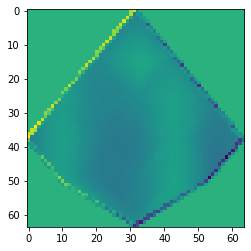

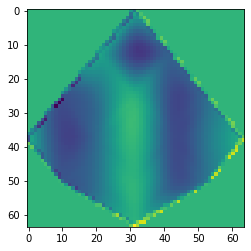

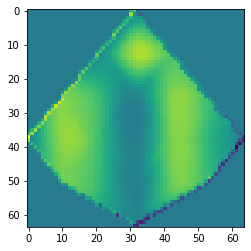

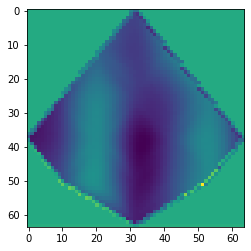

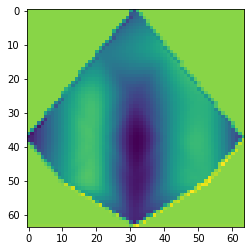

...

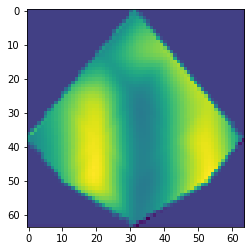

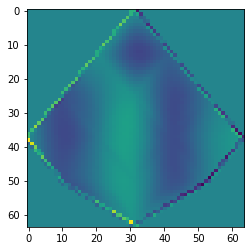

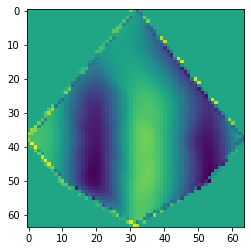

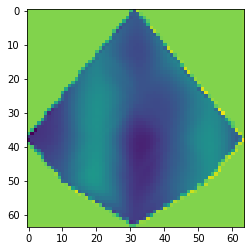

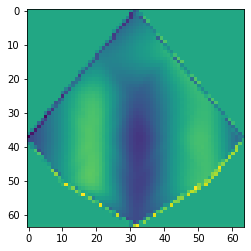

(32, 64, 64)


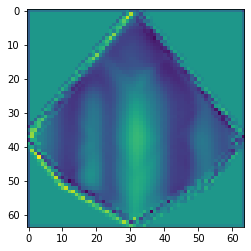

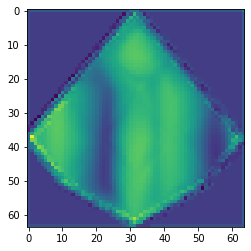

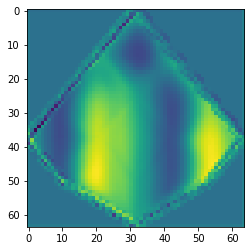

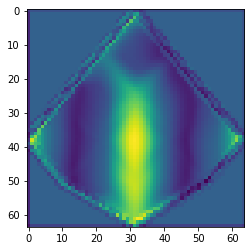

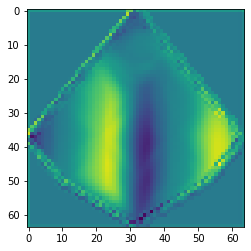

...

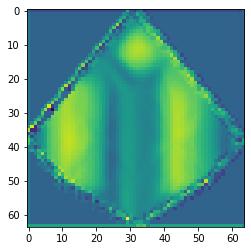

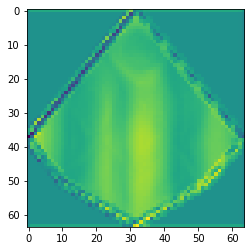

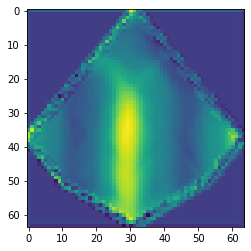

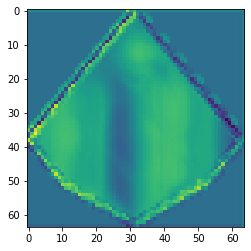

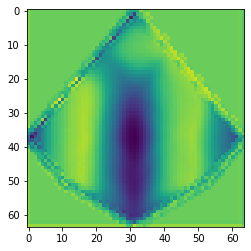

(32, 64, 64)


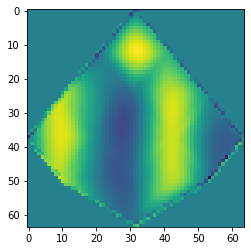

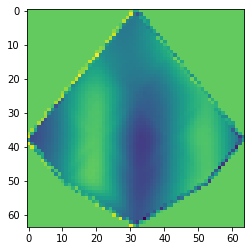

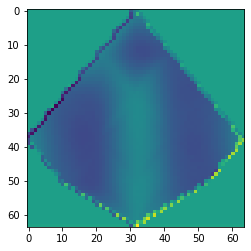

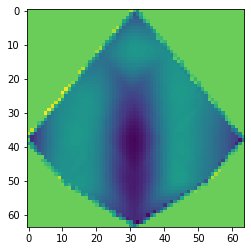

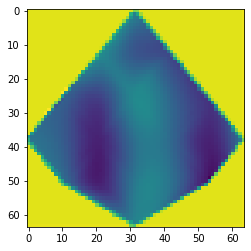

...

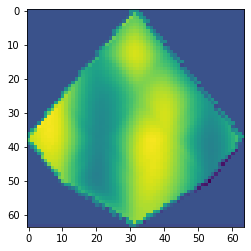

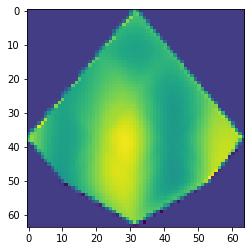

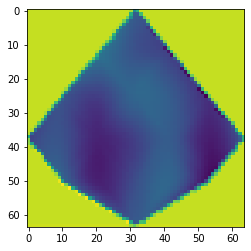

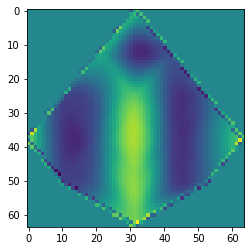

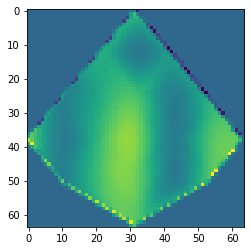

(32, 64, 64)


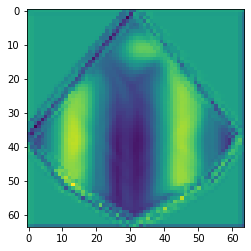

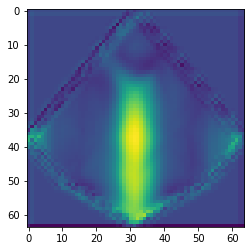

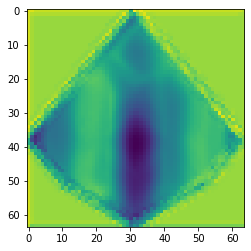

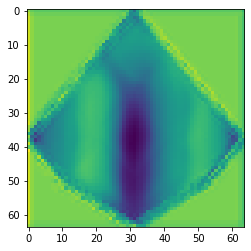

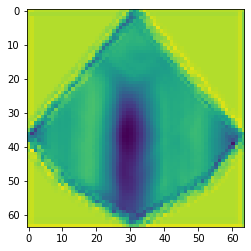

...

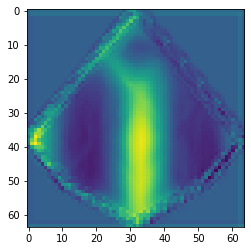

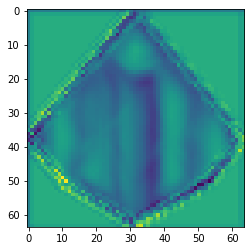

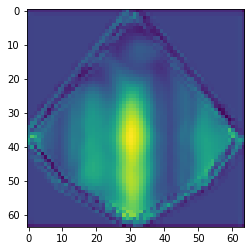

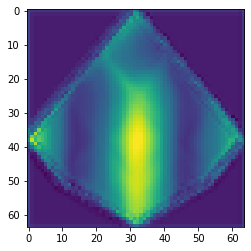

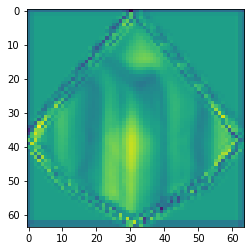

(32, 64, 64)


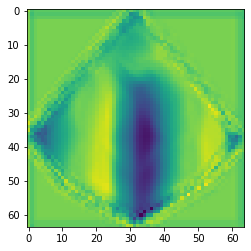

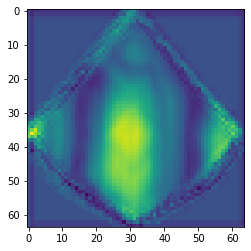

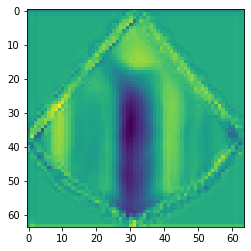

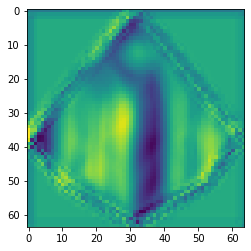

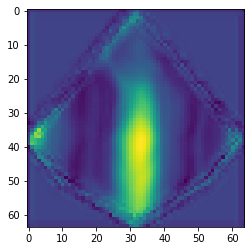

...

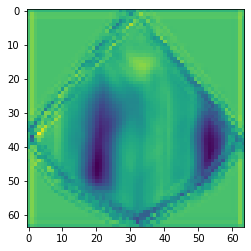

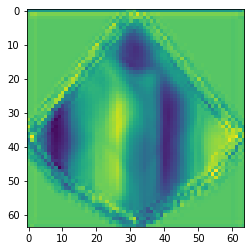

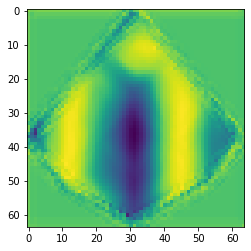

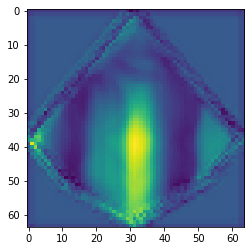

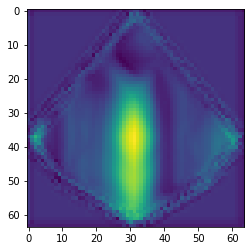

(32, 64, 64)


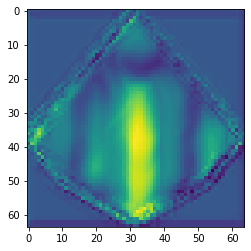

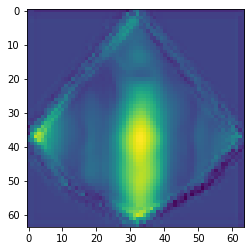

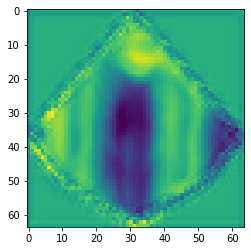

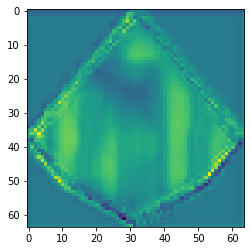

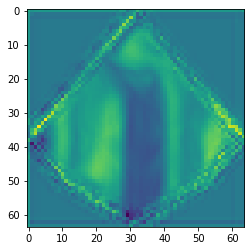

...

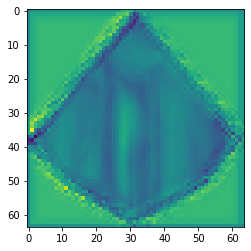

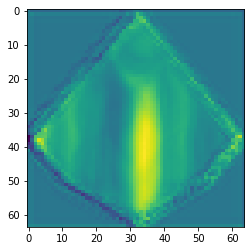

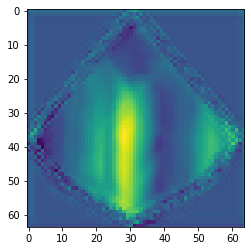

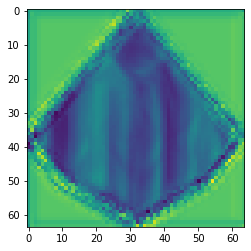

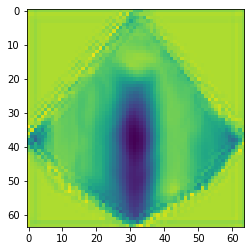

(32, 64, 64)


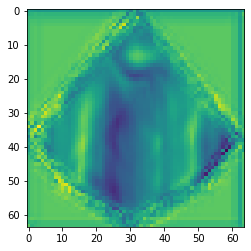

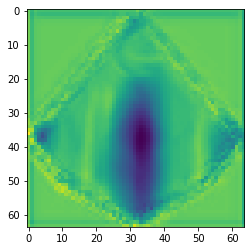

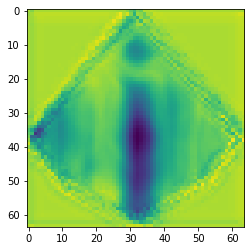

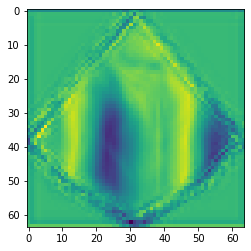

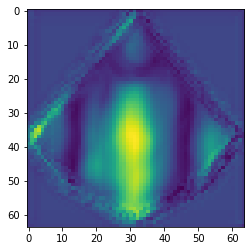

...

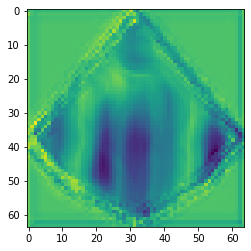

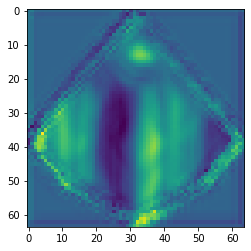

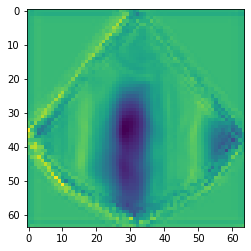

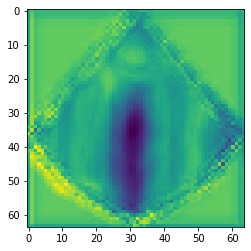

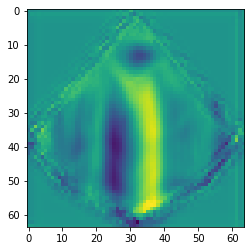

(32, 64, 64)


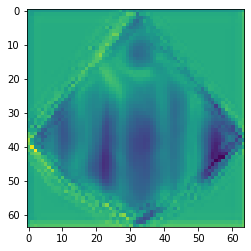

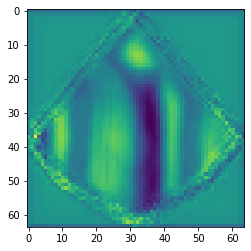

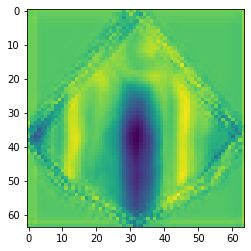

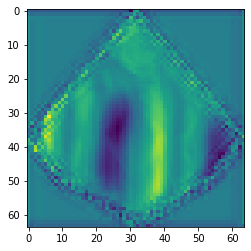

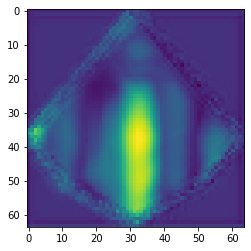

...

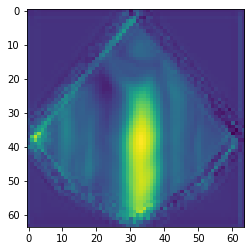

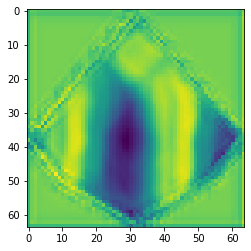

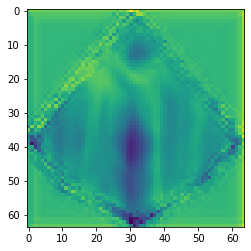

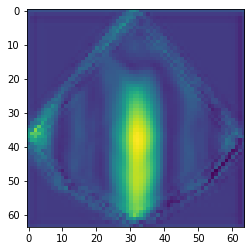

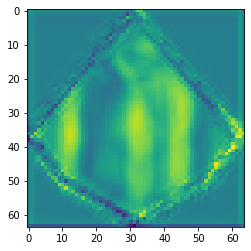

(32, 64, 64)


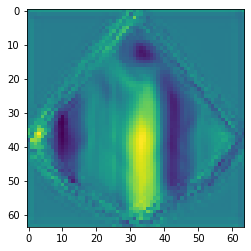

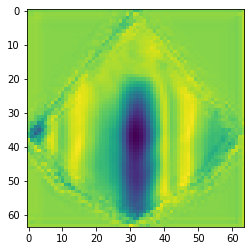

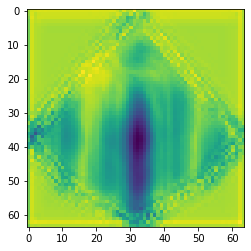

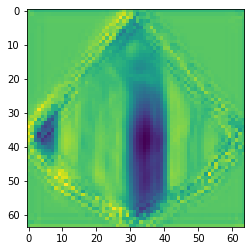

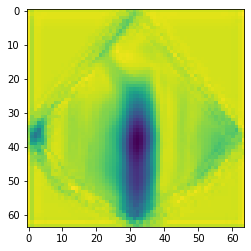

...

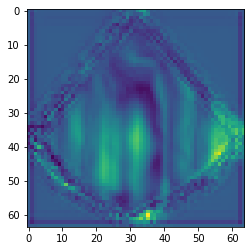

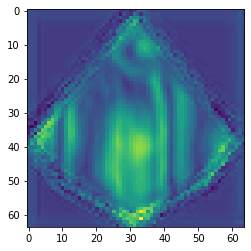

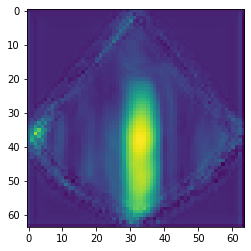

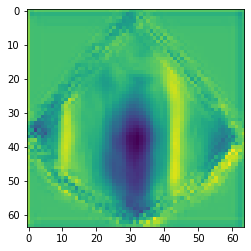

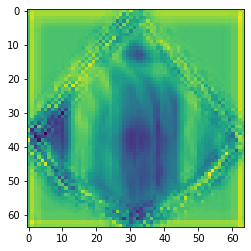

In [ ]:
for op in outputs:
  print(op[0].T.shape)
  for im in op[0].T:
    plt.imshow(im.T)
    plt.show()

## Individual Test Candidate Models

## v1

In [ ]:
def get_accuracy(datasets):
  models = []
  for dataset in datasets:
    print(dataset)
    train, test = generate_bci_image_dataset(dataset, electrodes, image_size=128)[0]
    x_train, y_train = np.array([x for x in train[:, 0]]), train[:, 1]
    x_test, y_test = np.array([x for x in test[:, 0]]), test[:, 1]
    x_train, x_test = x_train.astype(np.float32), x_test.astype(np.float32)
    y_train, y_test = y_train.astype(np.float32), y_test.astype(np.float32)
    ohe = OneHotEncoder().fit(y_train.reshape(-1,1))
    y_train = ohe.transform(y_train.reshape(-1,1)).toarray()
    y_test = ohe.transform(y_test.reshape(-1,1)).toarray()

    model = ''
    eval = 0
    history = ''
    loop_model = ''
    retry = True
    best = 0
    tries = 1
    hist = ''

    while retry:
      try:
        model_ = get_model_v1()
        model_.compile(loss="categorical_crossentropy", metrics=["accuracy", "categorical_accuracy", tf.keras.metrics.Precision(name='precision'), tf.keras.metrics.Recall(name='recall')], optimizer=tf.keras.optimizers.Adam(2e-4))
        history = model_.fit(x_train, y_train, batch_size=50, epochs=200, verbose=0, validation_data=(x_test, y_test))

        true_labels = ohe.inverse_transform(y_test).reshape(1,-1)[0]
        predicted_labels = ohe.inverse_transform(model_.predict(x_test)).reshape(1,-1)[0]

        print('Kappa: ', cohen_kappa_score(true_labels, predicted_labels))

        eval = model_.evaluate(x_test, y_test)[1]
        if eval > best:
          loop_model = model_
          best = eval
          hist = history
        if eval > 0.75:
          retry = False
          model = loop_model
        if tries >= 5:
          model = loop_model
          eval = best
          history = hist
          break
        tries = tries + 1
      except Exception as e:
        print(e)

    for graph in ["loss", "accuracy", "categorical_accuracy", 'precision', 'recall']:
      plt.plot(history.history[graph][1:])
      plt.plot(history.history[f'val_{graph}'][1:])
      plt.legend([graph, f'Val {graph}'])
      plt.show()

    print('\n')

    print(eval)

    print('\n')

    models.append(model)

  return models

/content/drive/MyDrive/MP Datasets/A01T.npz


3/3 [==============================] - 0s 19ms/step
Kappa:  0.7592592592592593
3/3 [==============================] - 0s 20ms/step - loss: 0.4580 - accuracy: 0.8194 - categorical_accuracy: 0.8194 - precision: 0.8194 - recall: 0.8194


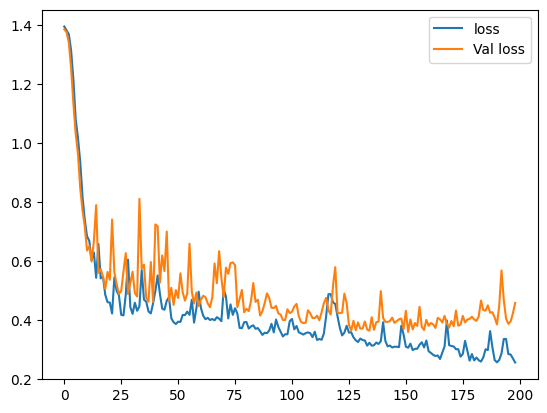

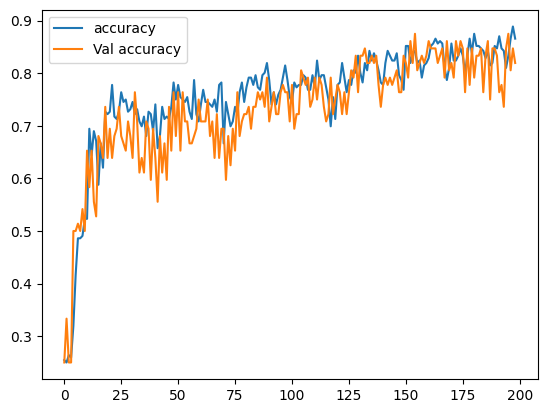

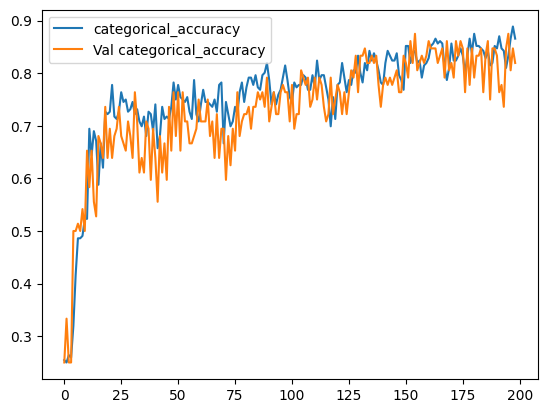

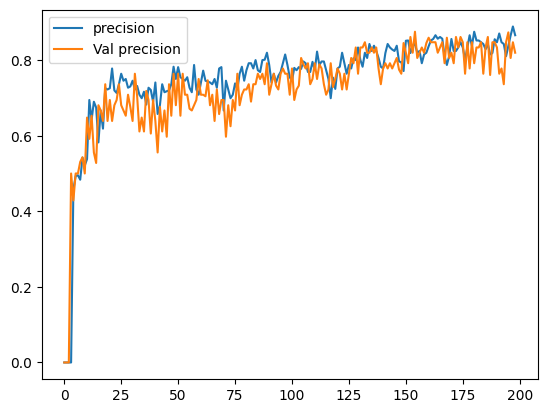

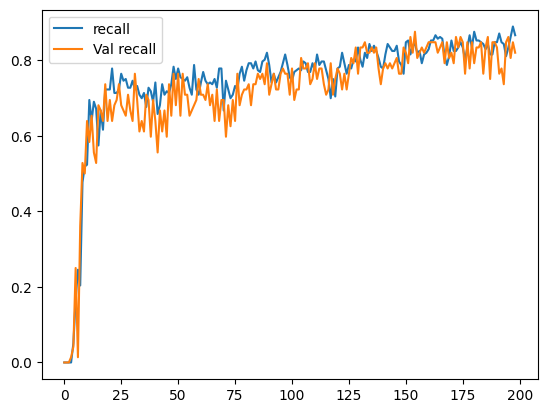



0.8194444179534912


/content/drive/MyDrive/MP Datasets/A02T.npz
3/3 [==============================] - 0s 19ms/step
Kappa:  0.37037037037037035
3/3 [==============================] - 0s 32ms/step
Kappa:  0.7962962962962963
3/3 [==============================] - 0s 34ms/step - loss: 0.3727 - accuracy: 0.8472 - categorical_accuracy: 0.8472 - precision: 0.8594 - recall: 0.7639


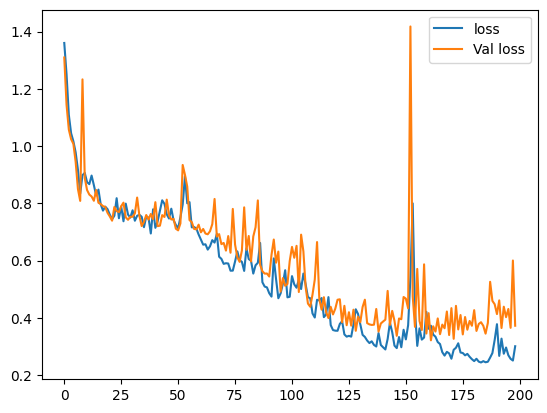

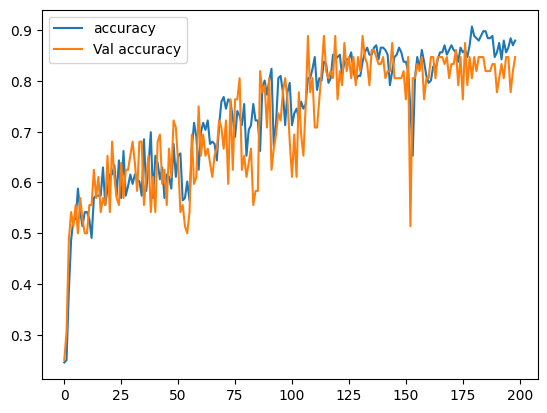

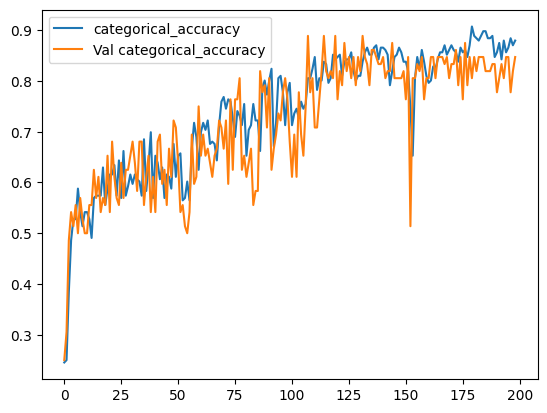

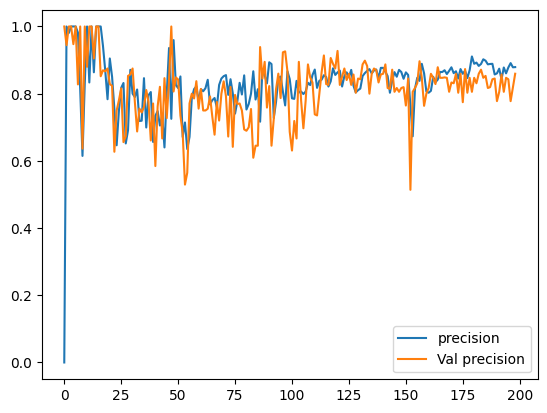

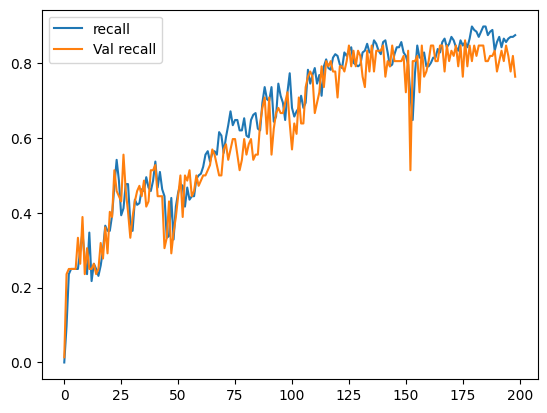



0.8472222089767456


/content/drive/MyDrive/MP Datasets/A03T.npz
3/3 [==============================] - 0s 20ms/step
Kappa:  0.31481481481481477
3/3 [==============================] - 0s 38ms/step
Kappa:  0.4814814814814815
3/3 [==============================] - 0s 33ms/step
Kappa:  0.35185185185185186
3/3 [==============================] - 0s 33ms/step
Kappa:  0.38888888888888884
3/3 [==============================] - 0s 33ms/step
Kappa:  0.40740740740740744
3/3 [==============================] - 0s 42ms/step - loss: 1.2698 - accuracy: 0.5556 - categorical_accuracy: 0.5556 - precision: 0.5909 - recall: 0.5417


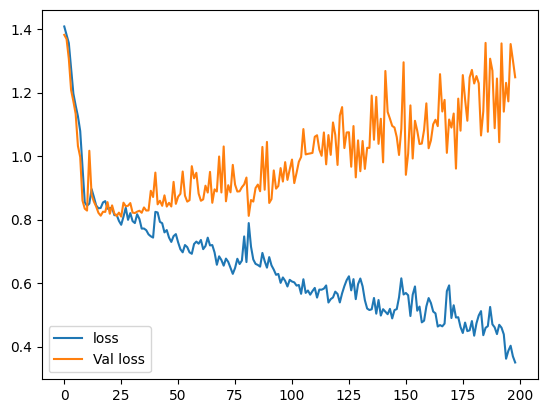

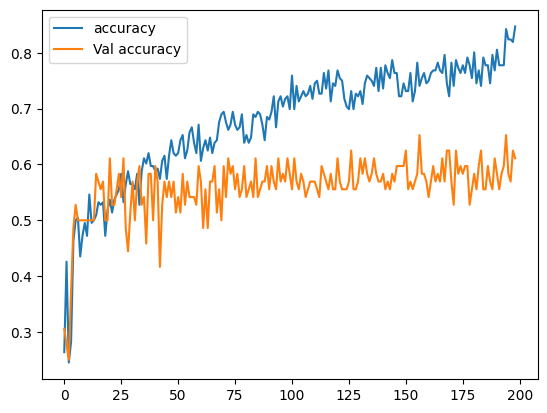

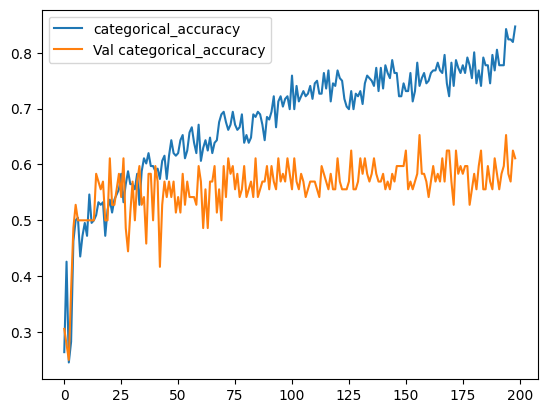

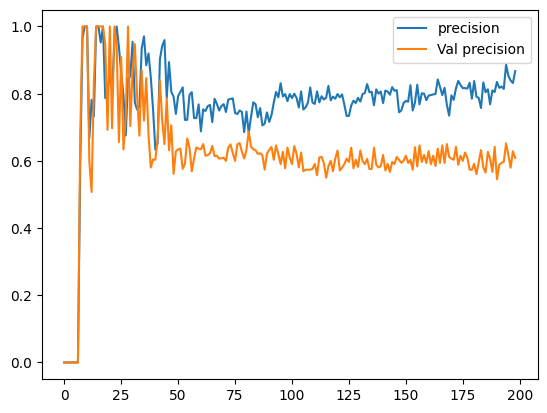

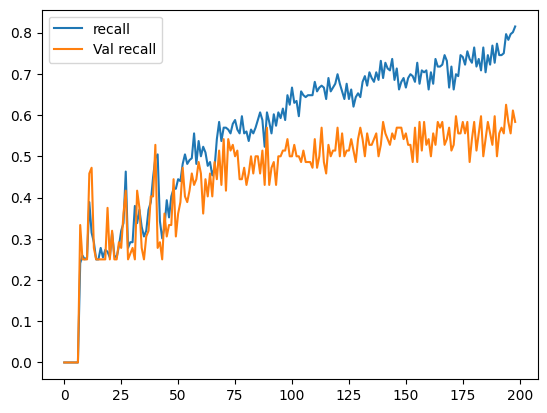



0.6111111044883728


/content/drive/MyDrive/MP Datasets/A04T.npz
3/3 [==============================] - 0s 19ms/step
Kappa:  0.8333333333333334
3/3 [==============================] - 0s 22ms/step - loss: 0.5104 - accuracy: 0.8750 - categorical_accuracy: 0.8750 - precision: 0.8750 - recall: 0.8750


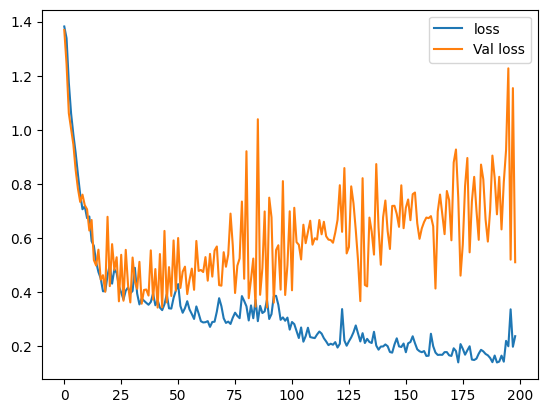

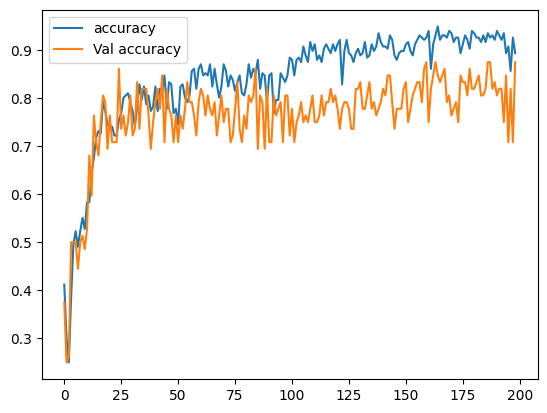

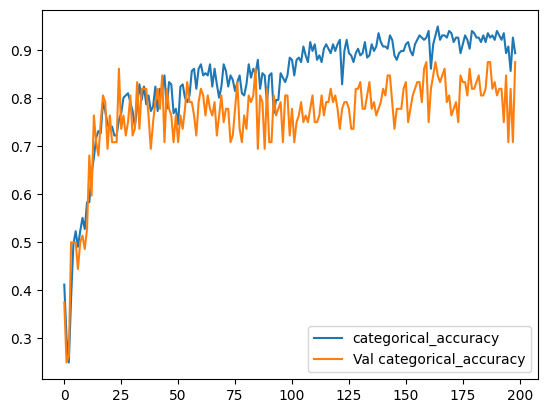

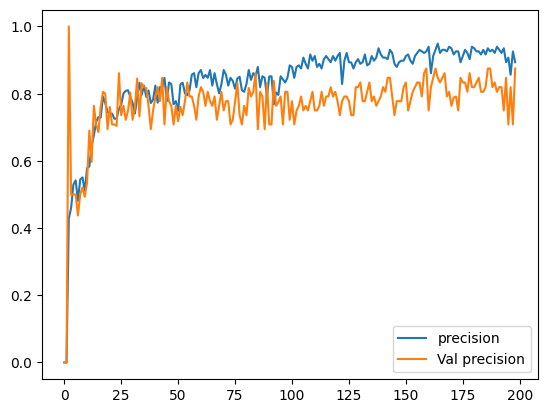

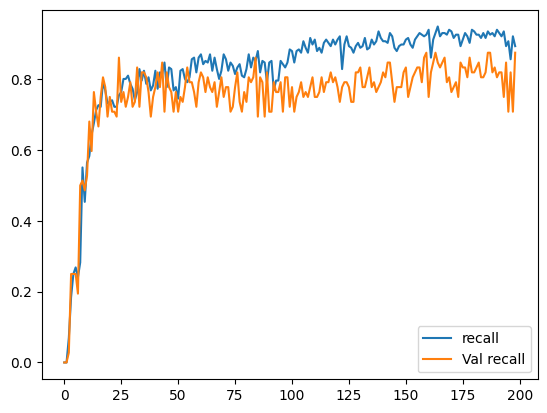



0.875


/content/drive/MyDrive/MP Datasets/A05T.npz
3/3 [==============================] - 0s 33ms/step
Kappa:  0.31481481481481477
3/3 [==============================] - 0s 35ms/step
Kappa:  0.2592592592592593
3/3 [==============================] - 0s 19ms/step
Kappa:  0.20370370370370372
3/3 [==============================] - 0s 33ms/step
Kappa:  0.09259259259259256
3/3 [==============================] - 0s 20ms/step
Kappa:  0.2777777777777778
3/3 [==============================] - 0s 24ms/step - loss: 1.4582 - accuracy: 0.4583 - categorical_accuracy: 0.4583 - precision: 0.5455 - recall: 0.4167


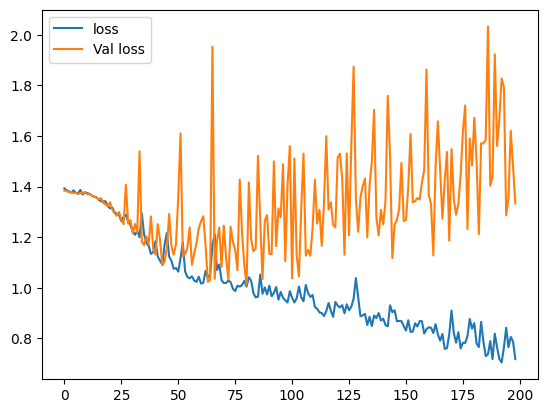

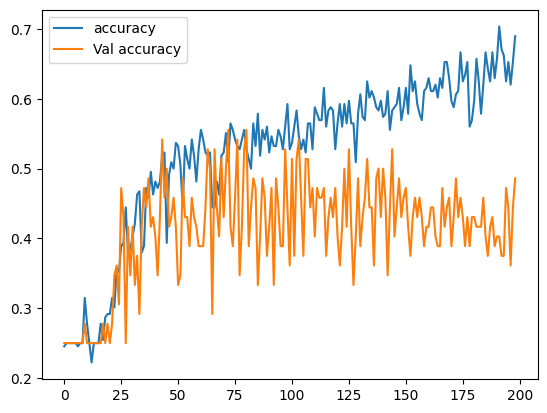

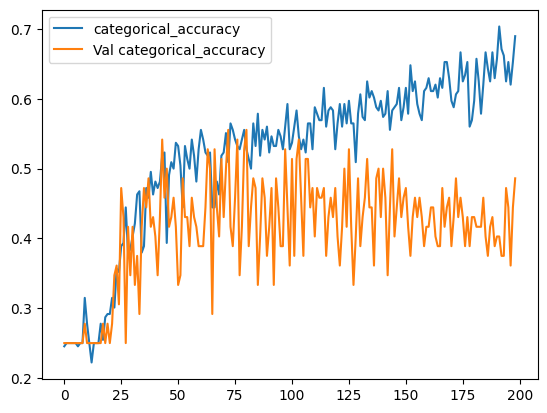

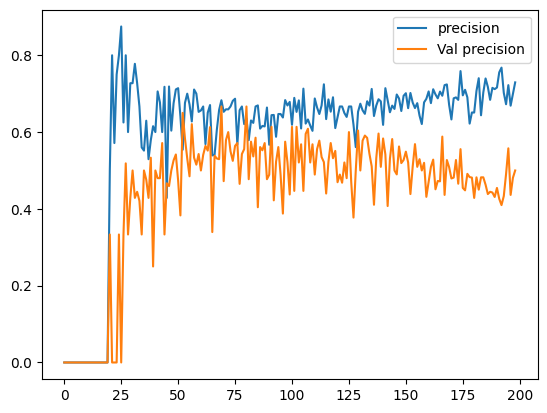

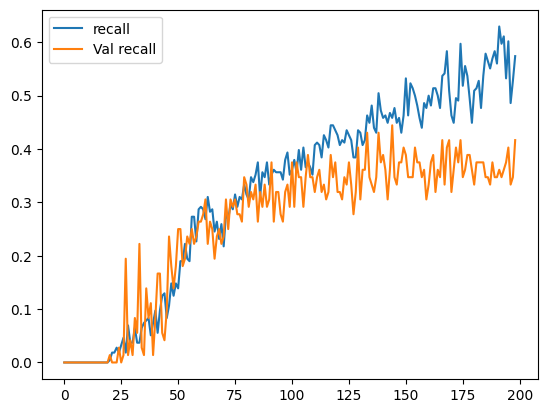



0.4861111044883728


/content/drive/MyDrive/MP Datasets/A06T.npz
3/3 [==============================] - 0s 22ms/step
Kappa:  0.9814814814814815
3/3 [==============================] - 0s 23ms/step - loss: 0.0465 - accuracy: 0.9861 - categorical_accuracy: 0.9861 - precision: 0.9861 - recall: 0.9861


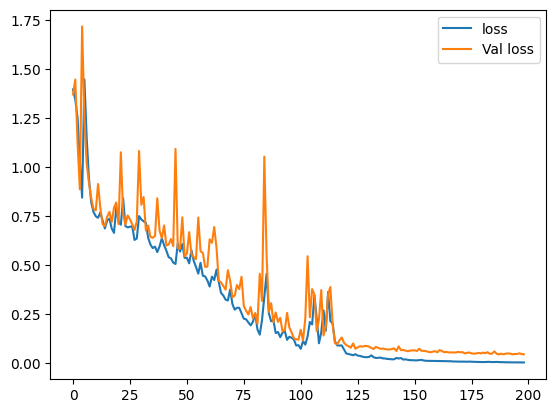

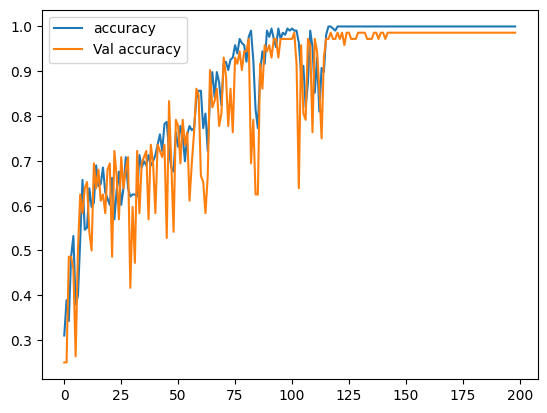

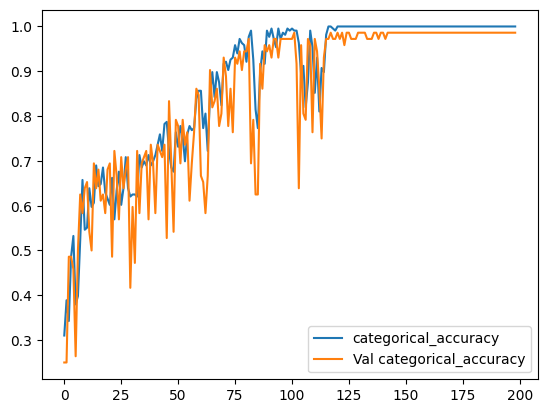

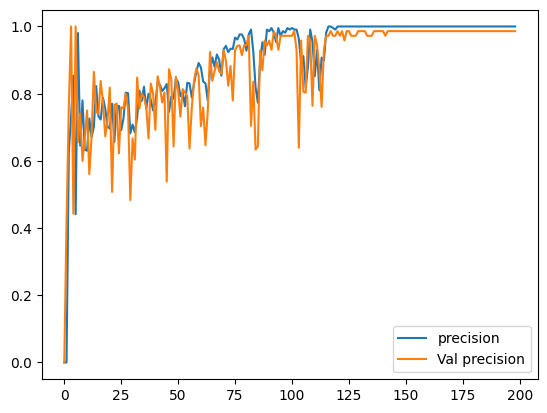

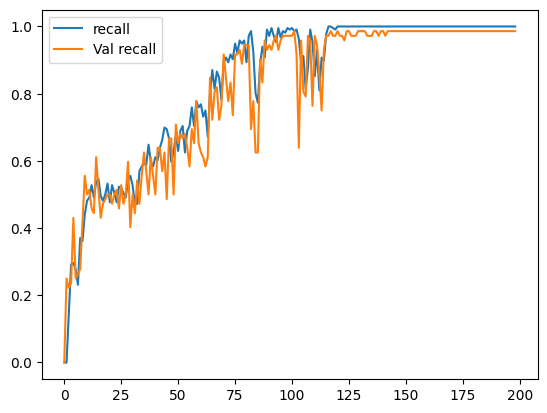



0.9861111044883728


/content/drive/MyDrive/MP Datasets/A07T.npz
3/3 [==============================] - 0s 34ms/step
Kappa:  0.4814814814814815
3/3 [==============================] - 0s 19ms/step
Kappa:  0.5555555555555556
3/3 [==============================] - 0s 23ms/step - loss: 1.6245 - accuracy: 0.6667 - categorical_accuracy: 0.6667 - precision: 0.6667 - recall: 0.6667


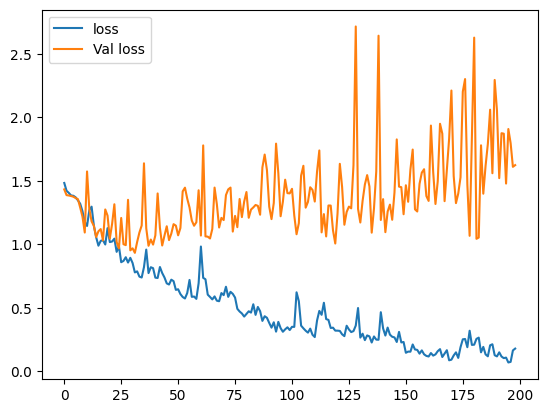

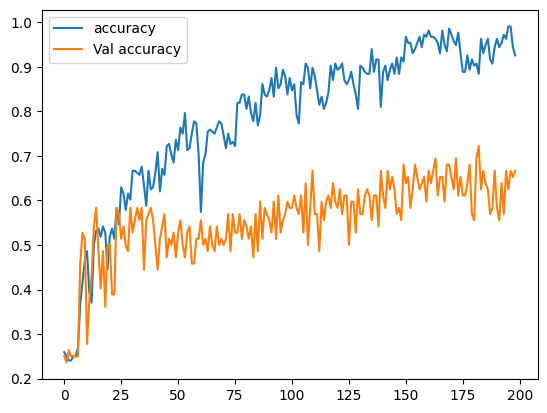

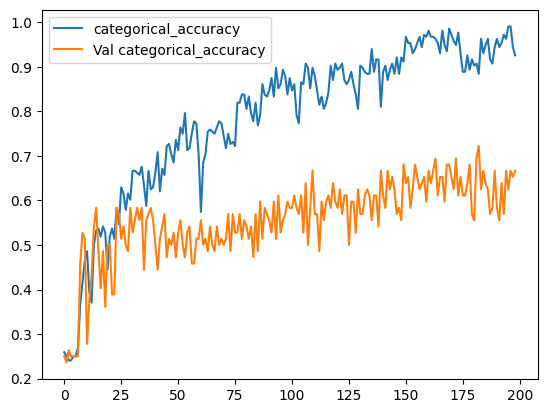

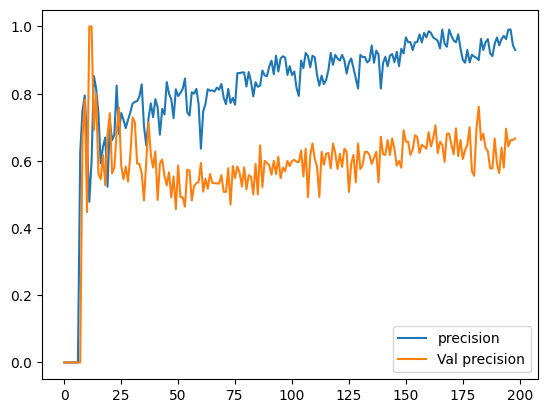

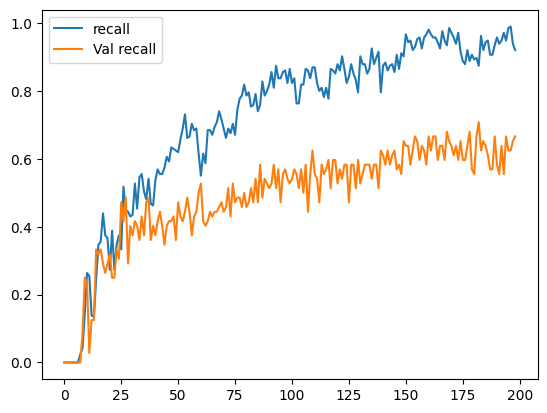



0.6666666865348816


/content/drive/MyDrive/MP Datasets/A08T.npz
3/3 [==============================] - 0s 33ms/step
Kappa:  0.962962962962963
3/3 [==============================] - 0s 32ms/step - loss: 0.2614 - accuracy: 0.9722 - categorical_accuracy: 0.9722 - precision: 0.9722 - recall: 0.9722


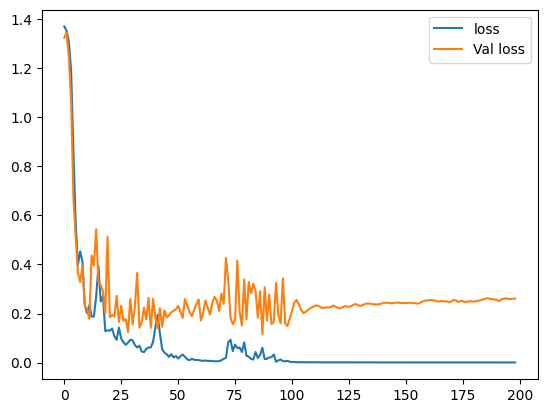

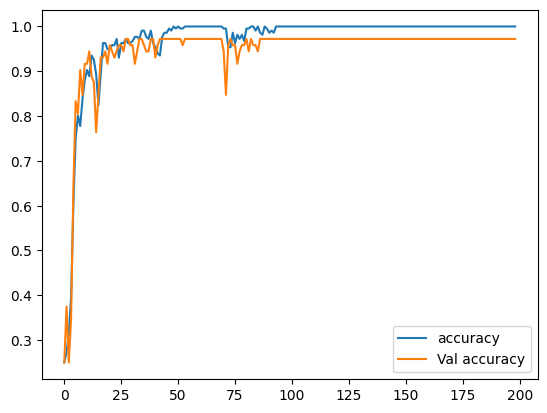

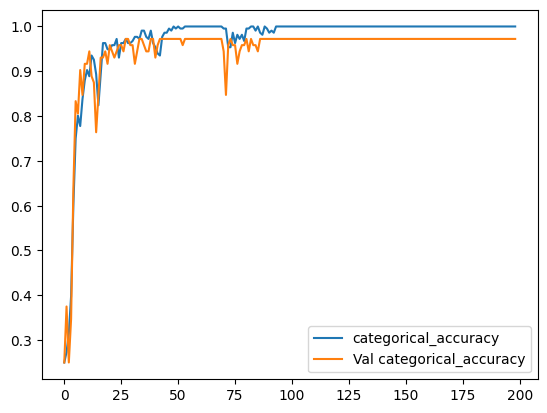

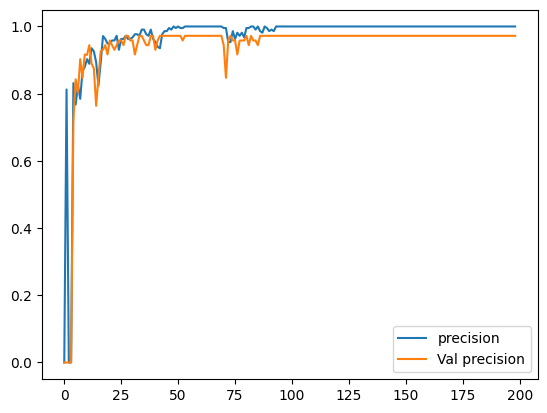

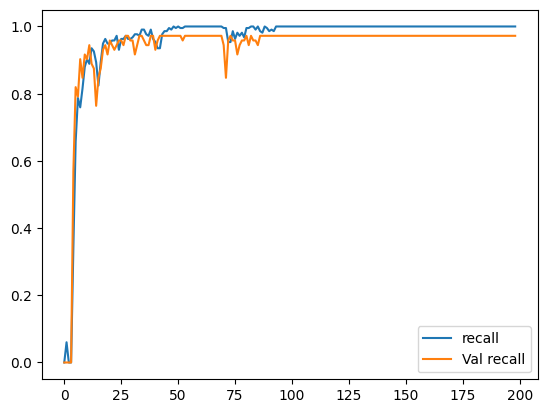



0.9722222089767456


/content/drive/MyDrive/MP Datasets/A09T.npz
3/3 [==============================] - 0s 33ms/step
Kappa:  0.31481481481481477
3/3 [==============================] - 0s 19ms/step
Kappa:  0.0
3/3 [==============================] - 0s 32ms/step
Kappa:  0.0
3/3 [==============================] - 0s 33ms/step
Kappa:  0.2777777777777778
3/3 [==============================] - 0s 20ms/step
Kappa:  0.35185185185185186
3/3 [==============================] - 0s 21ms/step - loss: 2.2695 - accuracy: 0.5139 - categorical_accuracy: 0.5139 - precision: 0.5152 - recall: 0.4722


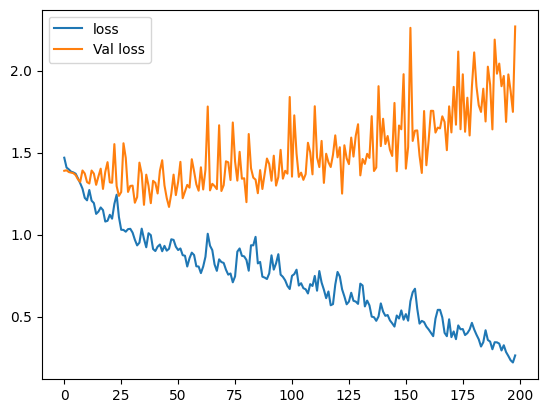

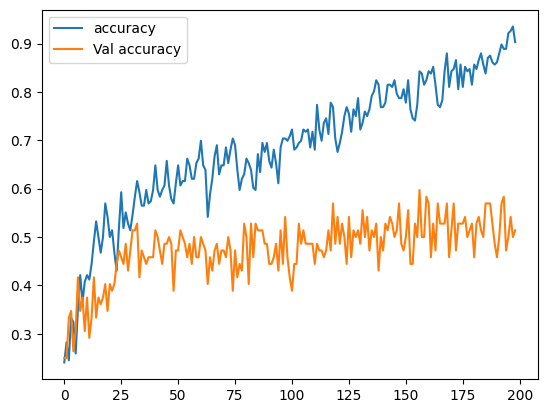

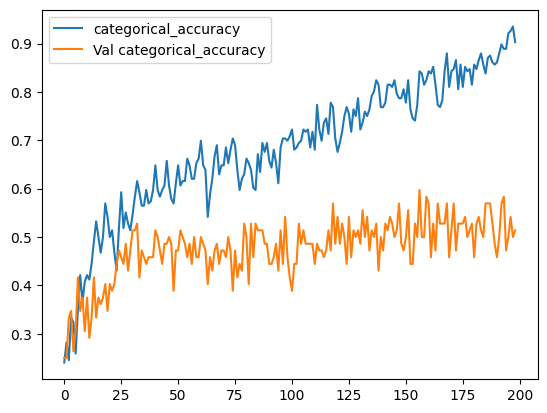

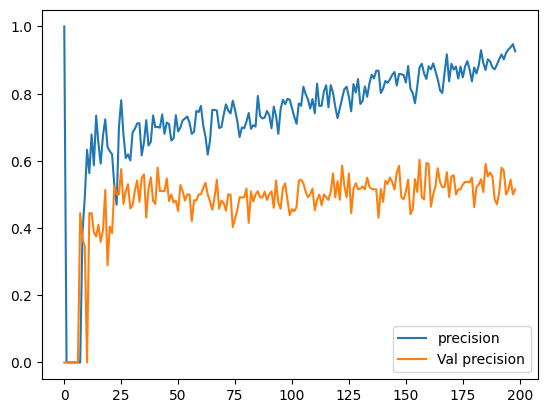

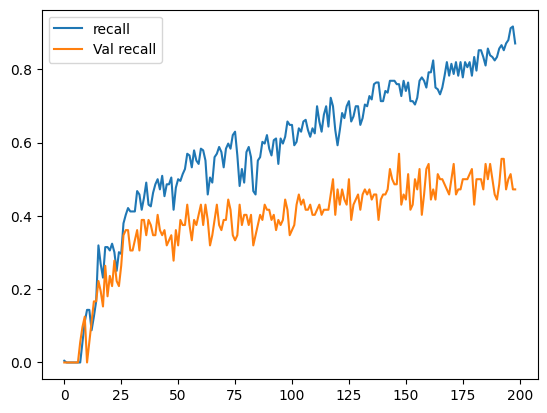



0.5138888955116272




In [ ]:
models = get_accuracy([
    '/content/drive/MyDrive/MP Datasets/A01T.npz',
    '/content/drive/MyDrive/MP Datasets/A02T.npz',
    '/content/drive/MyDrive/MP Datasets/A03T.npz',
    '/content/drive/MyDrive/MP Datasets/A04T.npz',
    '/content/drive/MyDrive/MP Datasets/A05T.npz',
    '/content/drive/MyDrive/MP Datasets/A06T.npz',
    '/content/drive/MyDrive/MP Datasets/A07T.npz',
    '/content/drive/MyDrive/MP Datasets/A08T.npz',
    '/content/drive/MyDrive/MP Datasets/A09T.npz'
    ])

## v2

In [ ]:
def get_accuracy(datasets):
  models = []
  for dataset in datasets:
    print(dataset)
    train, test = train, test = generate_bci_image_dataset(dataset, electrodes, image_size=128)[0]
    x_train, y_train = np.array([x for x in train[:, 0]]), train[:, 1]
    x_test, y_test = np.array([x for x in test[:, 0]]), test[:, 1]
    x_train, x_test = x_train.astype(np.float32), x_test.astype(np.float32)
    y_train, y_test = y_train.astype(np.float32), y_test.astype(np.float32)
    ohe = OneHotEncoder().fit(y_train.reshape(-1,1))
    y_train = ohe.transform(y_train.reshape(-1,1)).toarray()
    y_test = ohe.transform(y_test.reshape(-1,1)).toarray()

    model = ''
    eval = 0
    history = ''
    loop_model = ''
    retry = True
    best = 0
    tries = 1
    hist = ''

    while retry:
      try:
        model_ = resnet()
        model_.compile(loss="categorical_crossentropy", metrics=["accuracy", "categorical_accuracy", tf.keras.metrics.Precision(name='precision'), tf.keras.metrics.Recall(name='recall')], optimizer=tf.keras.optimizers.Adam(1e-5))
        history = model_.fit(x_train, y_train, batch_size=50, epochs=200, verbose=0, validation_data=(x_test, y_test))

        true_labels = ohe.inverse_transform(y_test).reshape(1,-1)[0]
        predicted_labels = ohe.inverse_transform(model_.predict(x_test)).reshape(1,-1)[0]

        print('Kappa: ', cohen_kappa_score(true_labels, predicted_labels))

        eval = model_.evaluate(x_test, y_test)[1]
        if eval > best:
          loop_model = model_
          best = eval
          hist = history
        if eval > 0.65:
          retry = False
          model = loop_model
        if tries >= 5:
          model = loop_model
          eval = best
          history = hist
          break
        tries = tries + 1
      except:
        pass

    for graph in ["loss", "accuracy", 'categorical_accuracy', 'precision', 'recall']:
      plt.plot(history.history[graph][1:])
      plt.plot(history.history[f'val_{graph}'][1:])
      plt.legend([graph, f'Val {graph}'])
      plt.show()

    print('\n')

    print(eval)

    print('\n')

    models.append(model)

  return models

/content/drive/MyDrive/MP Datasets/A01T.npz
3/3 [==============================] - 0s 49ms/step
Kappa:  0.6666666666666667
3/3 [==============================] - 0s 25ms/step - loss: 0.7541 - accuracy: 0.7500 - categorical_accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500


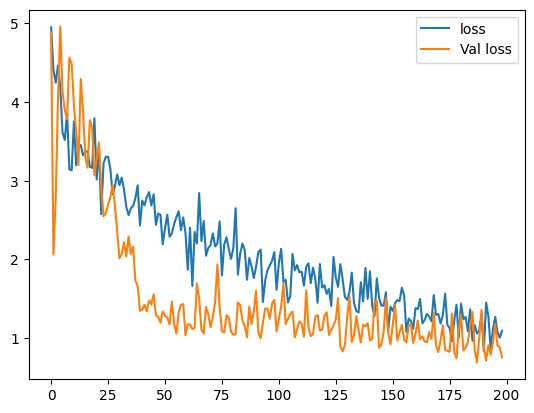

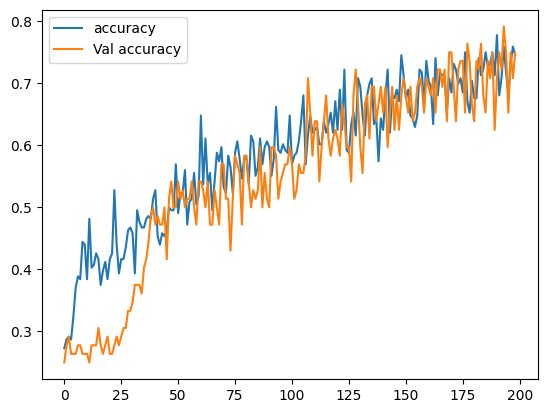

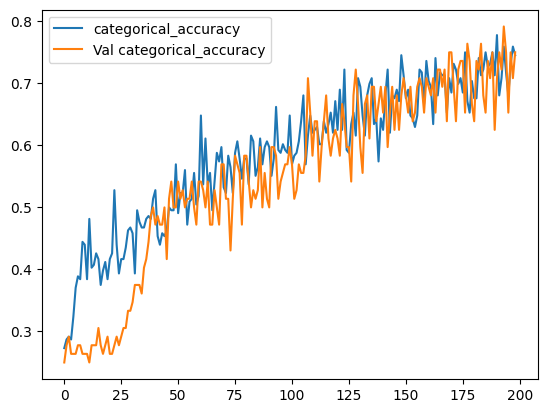

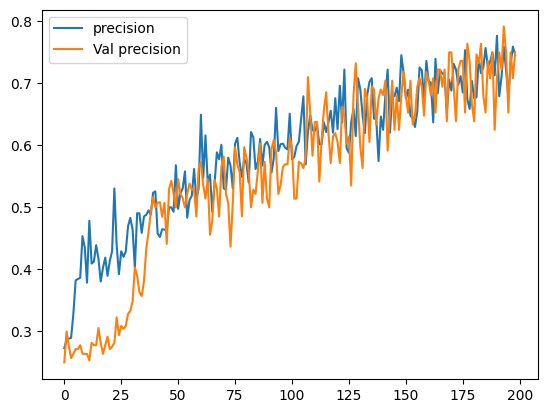

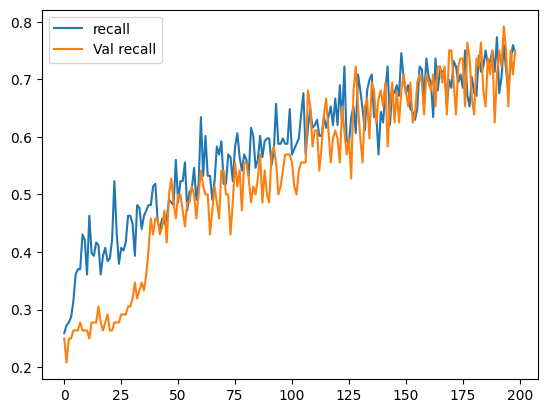



0.75


/content/drive/MyDrive/MP Datasets/A02T.npz
3/3 [==============================] - 0s 38ms/step
Kappa:  0.6851851851851851
3/3 [==============================] - 0s 35ms/step - loss: 0.9652 - accuracy: 0.7639 - categorical_accuracy: 0.7639 - precision: 0.7746 - recall: 0.7639


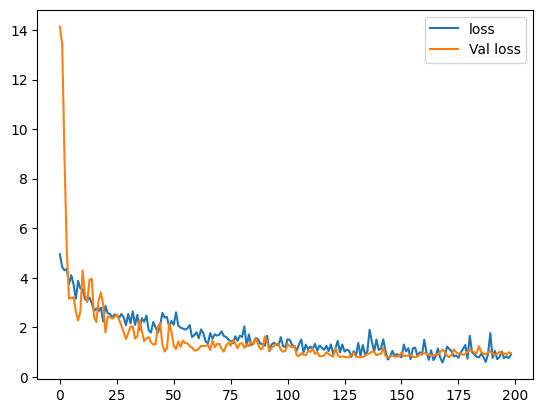

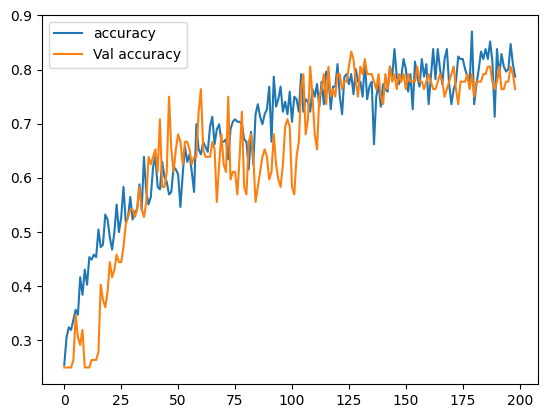

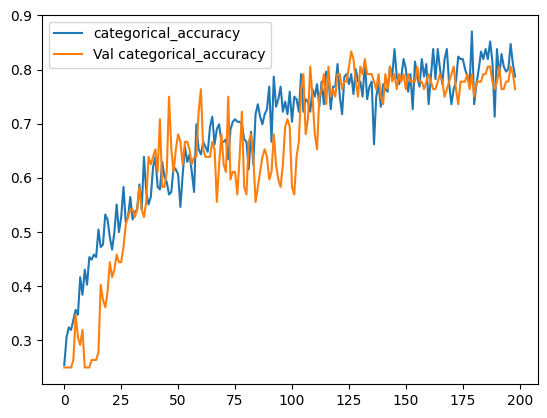

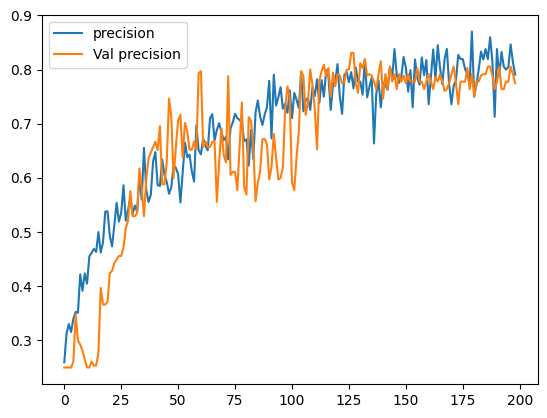

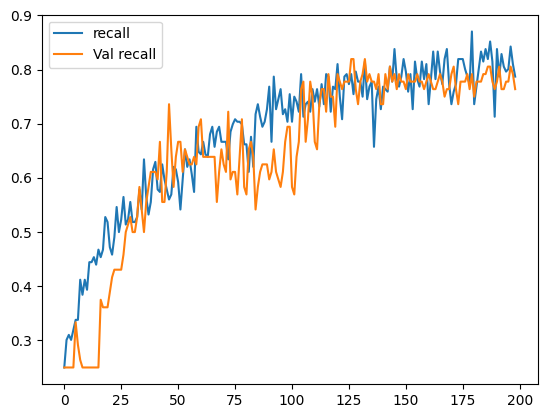



0.7638888955116272


/content/drive/MyDrive/MP Datasets/A03T.npz
3/3 [==============================] - 0s 38ms/step
Kappa:  0.40740740740740744
3/3 [==============================] - 1s 32ms/step
Kappa:  0.42592592592592593
3/3 [==============================] - 0s 28ms/step - loss: 2.1295 - accuracy: 0.5694 - categorical_accuracy: 0.5694 - precision: 0.5775 - recall: 0.5694


3/3 [==============================] - 0s 37ms/step
Kappa:  0.4444444444444444
3/3 [==============================] - 0s 37ms/step - loss: 1.9822 - accuracy: 0.5833 - categorical_accuracy: 0.5833 - precision: 0.5915 - recall: 0.5833


3/3 [==============================] - 0s 20ms/step
Kappa:  0.40740740740740744
3/3 [==============================] - 0s 38ms/step
Kappa:  0.4629629629629629
3/3 [==============================] - 0s 35ms/step - loss: 1.6880 - accuracy: 0.5972 - categorical_accuracy: 0.5972 - precision: 0.5857 - recall: 0.5694


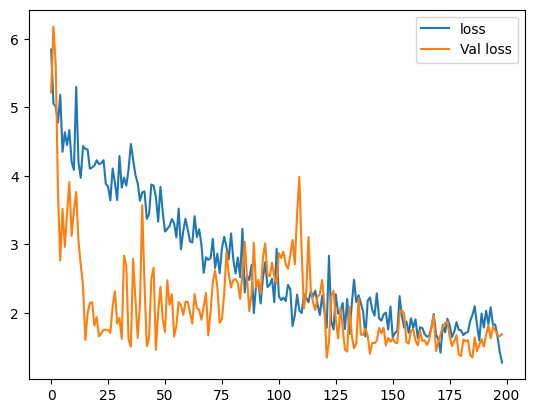

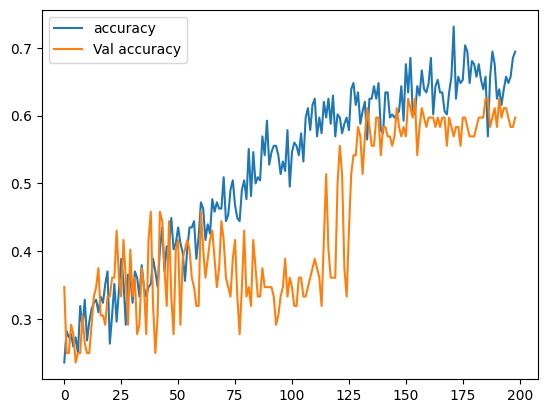

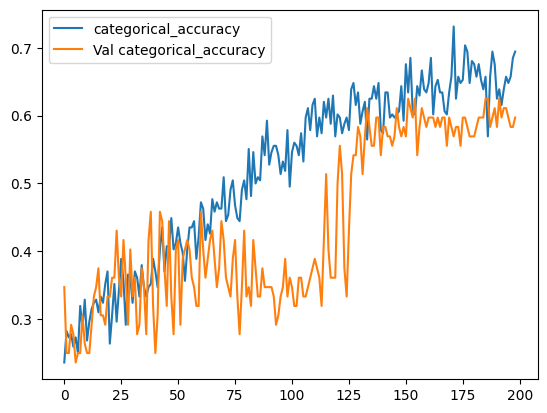

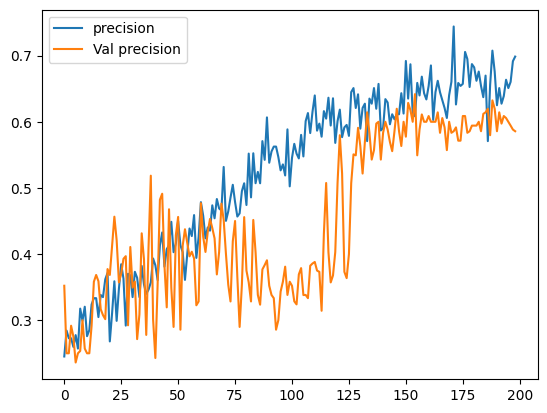

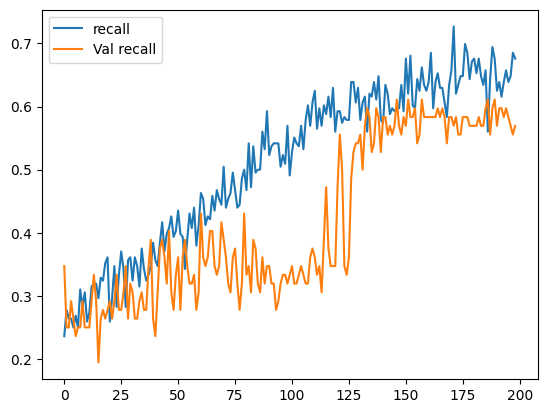



0.5972222089767456


/content/drive/MyDrive/MP Datasets/A04T.npz
3/3 [==============================] - 0s 38ms/step
Kappa:  0.7407407407407407
3/3 [==============================] - 0s 35ms/step - loss: 0.5555 - accuracy: 0.8056 - categorical_accuracy: 0.8056 - precision: 0.8056 - recall: 0.8056


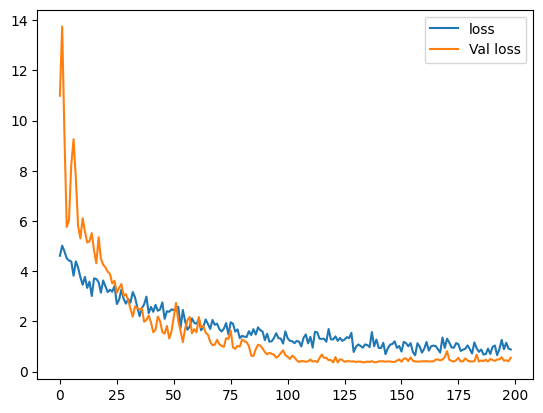

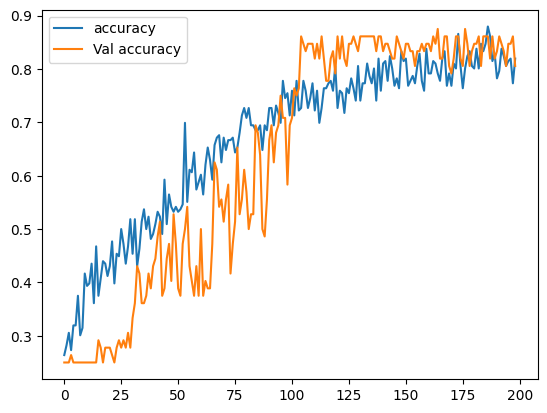

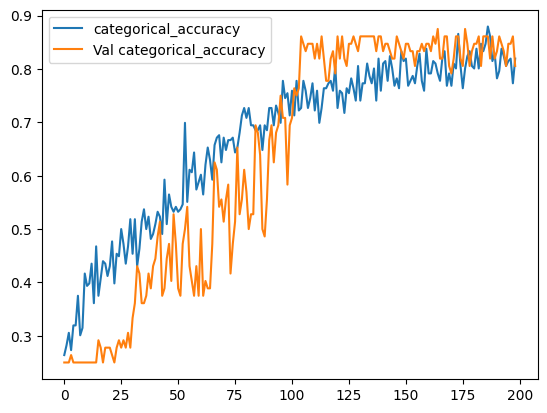

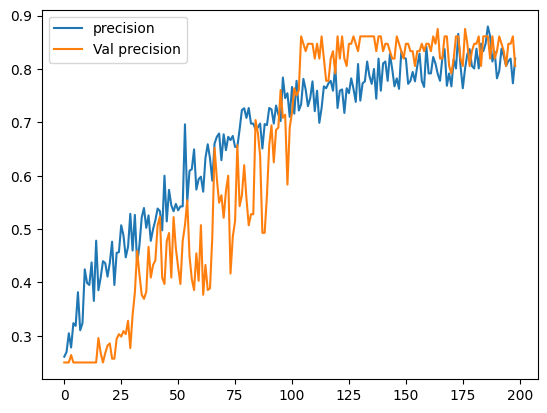

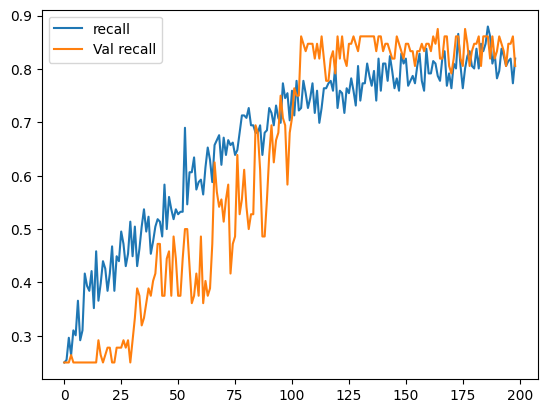



0.8055555820465088


/content/drive/MyDrive/MP Datasets/A05T.npz
3/3 [==============================] - 0s 23ms/step
Kappa:  0.2592592592592593
3/3 [==============================] - 0s 39ms/step
Kappa:  0.2777777777777778
3/3 [==============================] - 0s 38ms/step
Kappa:  0.18518518518518523
3/3 [==============================] - 0s 38ms/step
Kappa:  0.2962962962962963
3/3 [==============================] - 0s 39ms/step
Kappa:  0.2962962962962963
3/3 [==============================] - 0s 35ms/step - loss: 1.9536 - accuracy: 0.4722 - categorical_accuracy: 0.4722 - precision: 0.4615 - recall: 0.4167


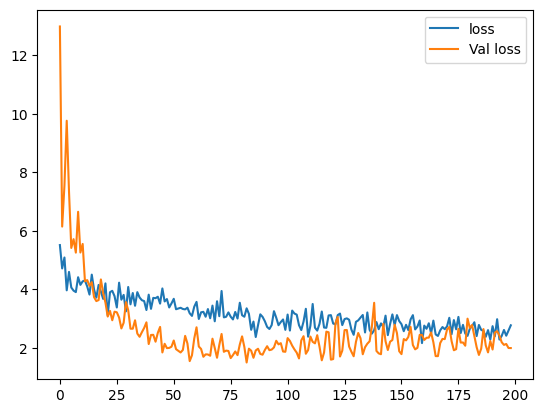

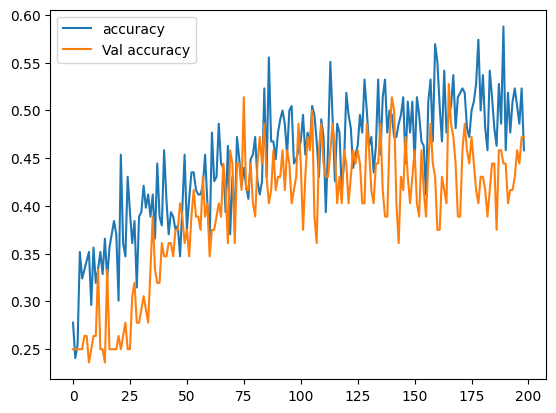

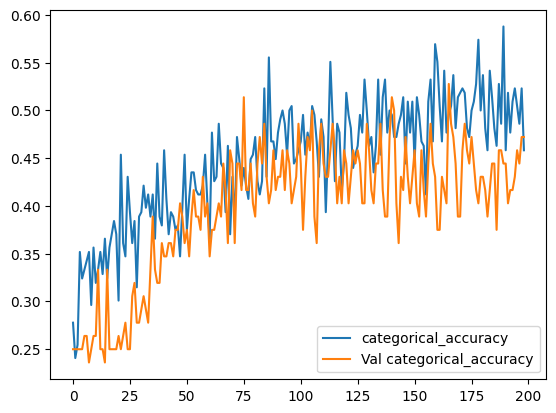

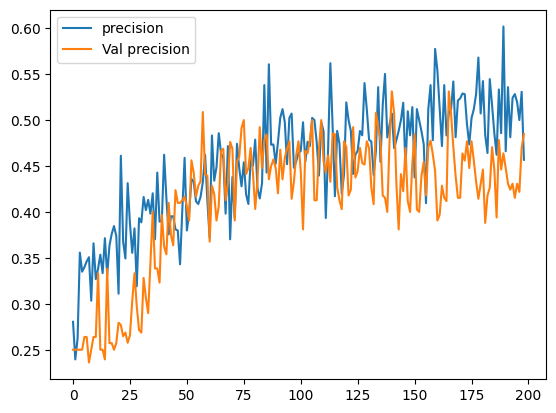

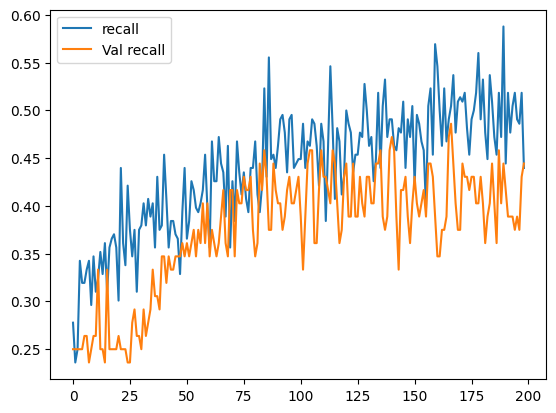



0.4722222089767456


/content/drive/MyDrive/MP Datasets/A06T.npz
3/3 [==============================] - 0s 24ms/step
Kappa:  0.8333333333333334
3/3 [==============================] - 0s 24ms/step - loss: 0.3587 - accuracy: 0.8750 - categorical_accuracy: 0.8750 - precision: 0.8732 - recall: 0.8611


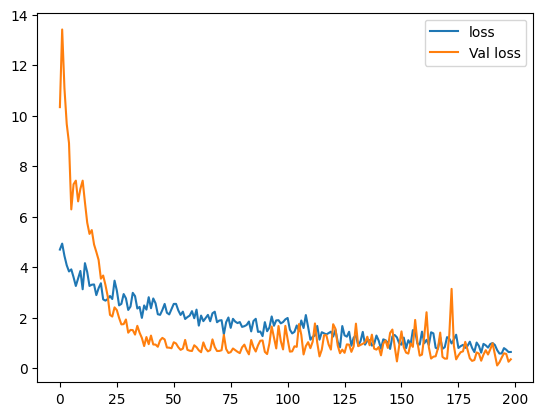

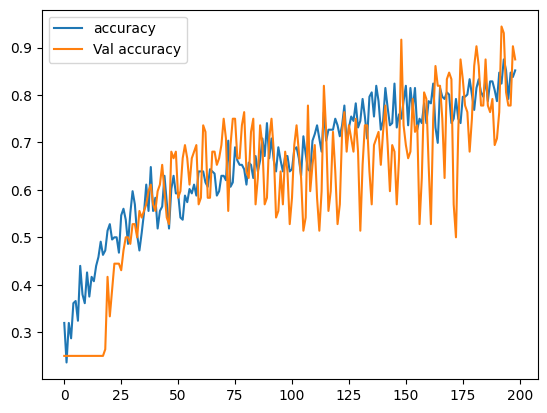

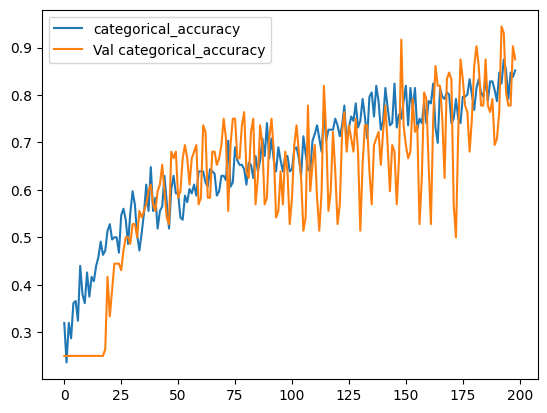

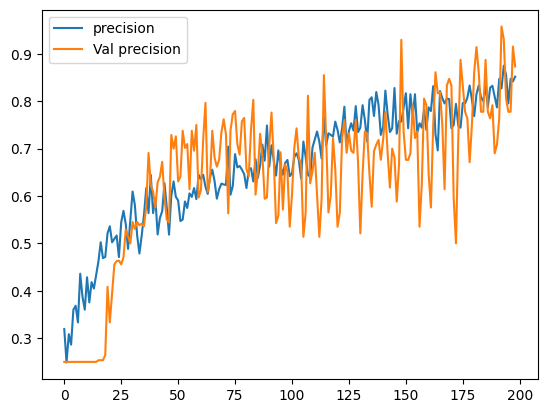

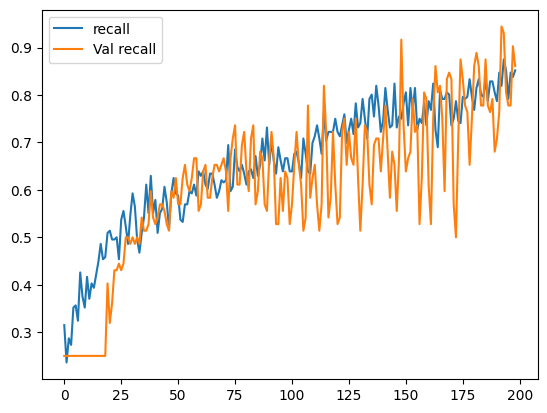



0.875


/content/drive/MyDrive/MP Datasets/A07T.npz
3/3 [==============================] - 1s 38ms/step
Kappa:  0.8148148148148149
3/3 [==============================] - 0s 42ms/step - loss: 0.9171 - accuracy: 0.8611 - categorical_accuracy: 0.8611 - precision: 0.8611 - recall: 0.8611


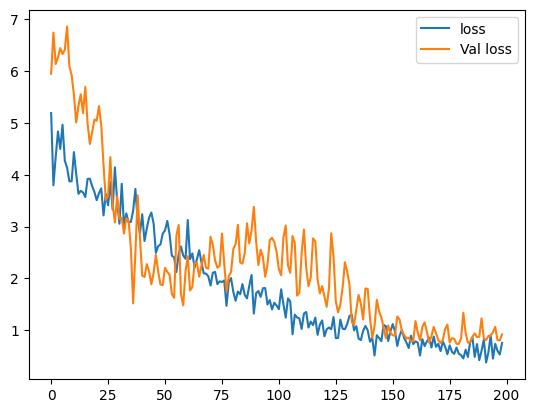

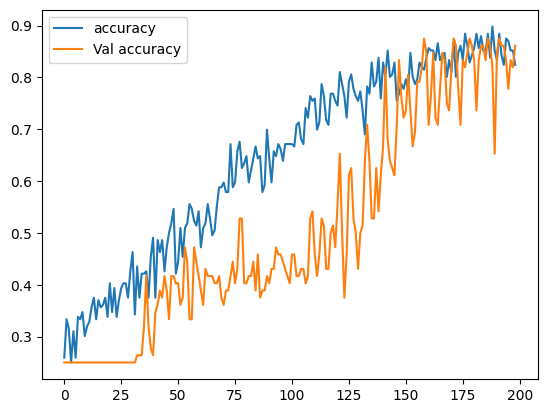

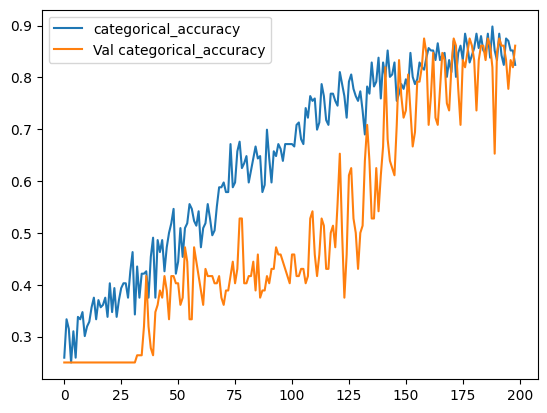

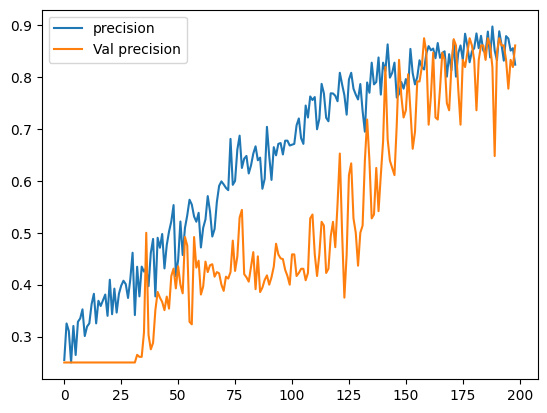

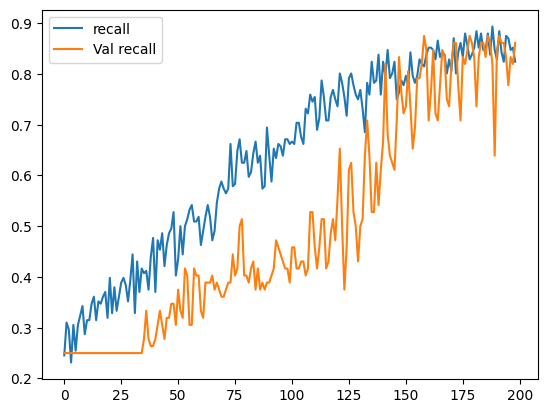



0.8611111044883728


/content/drive/MyDrive/MP Datasets/A08T.npz
3/3 [==============================] - 0s 23ms/step
Kappa:  1.0
3/3 [==============================] - 0s 24ms/step - loss: 0.0083 - accuracy: 1.0000 - categorical_accuracy: 1.0000 - precision: 1.0000 - recall: 1.0000


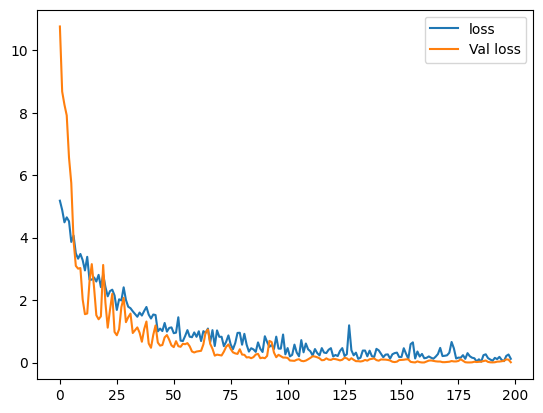

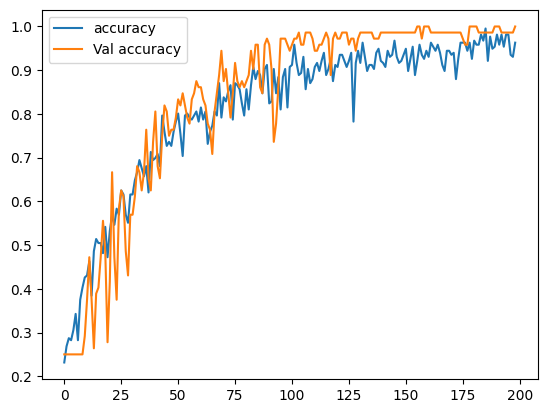

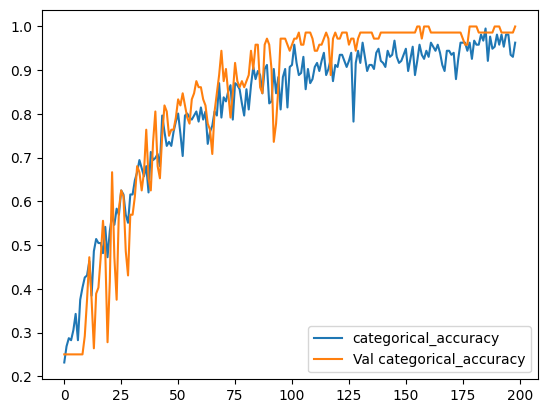

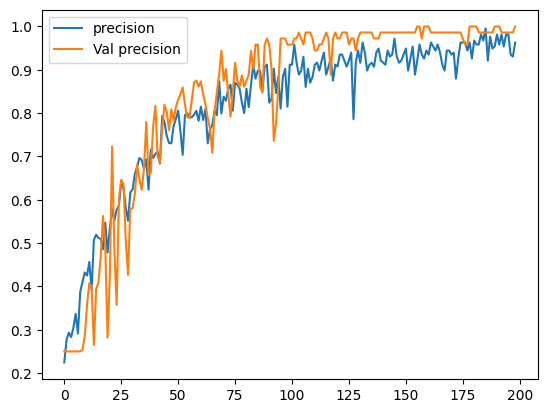

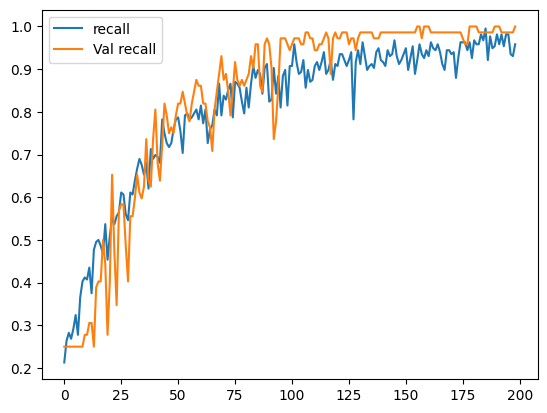



1.0


/content/drive/MyDrive/MP Datasets/A09T.npz
3/3 [==============================] - 0s 38ms/step
Kappa:  0.8703703703703703
3/3 [==============================] - 0s 37ms/step - loss: 0.3097 - accuracy: 0.9028 - categorical_accuracy: 0.9028 - precision: 0.9028 - recall: 0.9028


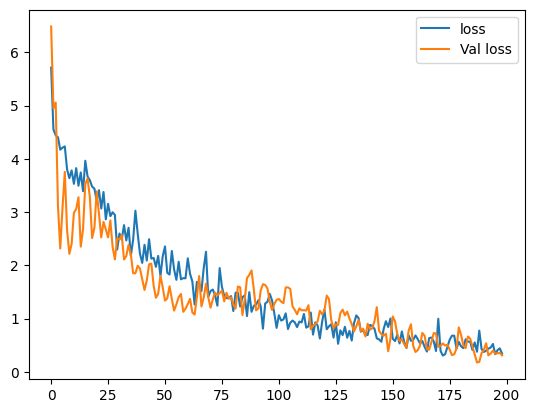

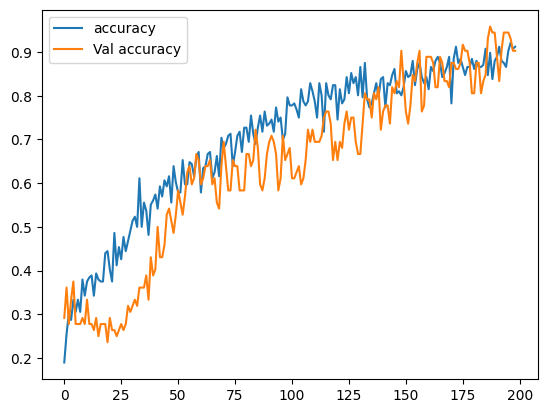

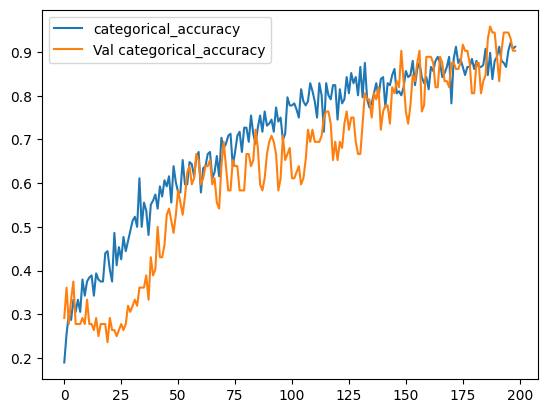

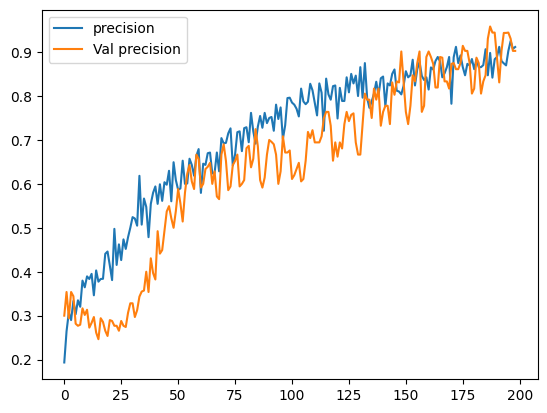

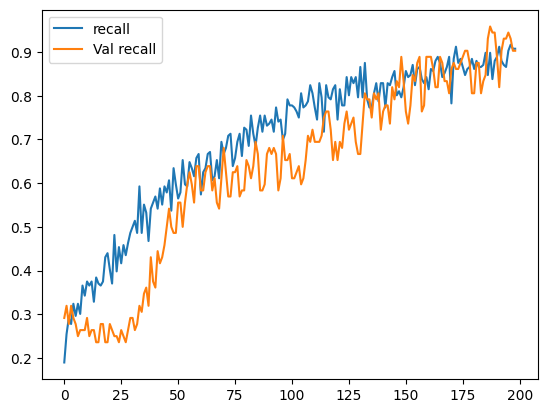



0.9027777910232544




In [ ]:
models = get_accuracy([
    '/content/drive/MyDrive/MP Datasets/A01T.npz',
    '/content/drive/MyDrive/MP Datasets/A02T.npz',
    '/content/drive/MyDrive/MP Datasets/A03T.npz',
    '/content/drive/MyDrive/MP Datasets/A04T.npz',
    '/content/drive/MyDrive/MP Datasets/A05T.npz',
    '/content/drive/MyDrive/MP Datasets/A06T.npz',
    '/content/drive/MyDrive/MP Datasets/A07T.npz',
    '/content/drive/MyDrive/MP Datasets/A08T.npz',
    '/content/drive/MyDrive/MP Datasets/A09T.npz'
    ])

# Analysis and Report Dashboard

## 1. Signal Analysis

The EEG signal for each patient is recorded for 672528 timesteps, divided into multiple trials.

The signal recorded is of voltages from groups of neurons located at different points on the head using electrodes. A part of the signal recorded from one such electrode is as follows:

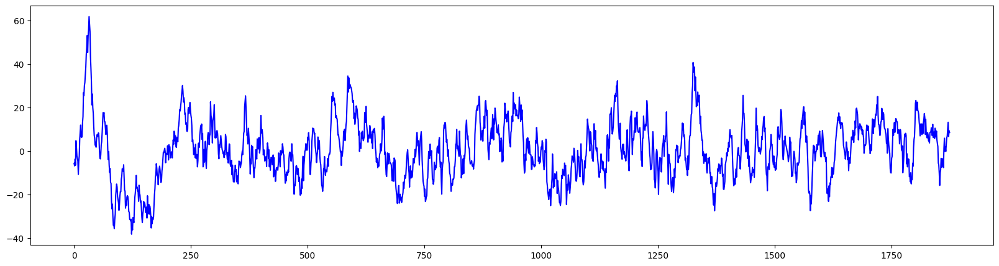

These are voltage spikes observed at an electrode. These can be caused due to a multitude of factors, some of them being:
1. The cues given to the patient during the experiment.
2. Their senses of smell, sight, touch.
3. Other stimulus they recieve from their environment.
4. Even their own thoughts.


## 2. Signal compositional analysis

Any brain works by firing groups of neurons in a specific order.

Each such process of generation of an action from voluntarily or involutarily thinking about it to the actual performancce of the action, there are certain paths through the neurons that the brain considers going through to reach the goal state.

Each path therefore emits a path of action potential voltages that surge through the electrodes and are recorded.

Most commonly known frequencies in brainwaves are -

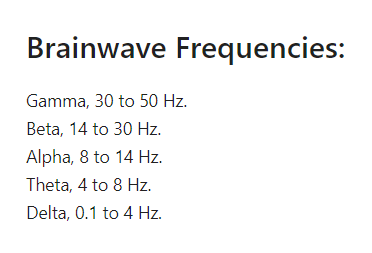

## 3. Signal Decomposition

According to the known frequencies, we can decompose the signals and analyse them accordingly.

The alpha beta and gamma waves can therefore be used to map actions and thoughts and therefore classify them accordingly.

We can check their patterns in different electrodes accordingly. Each excited neuron group creates a noticeable spike in the decomposed signal while in rest state, everything is relatively calm. We can see this in the images below.

1. Neurons in rest state

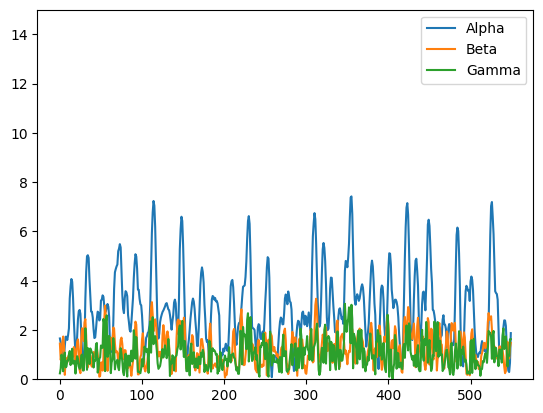

2. Neurons in excited state

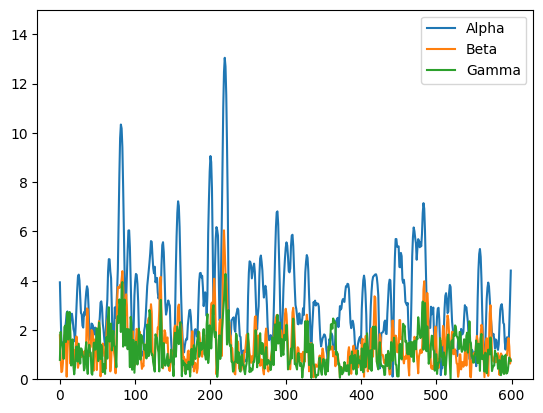

# 4. Image Generation

The alpha, beta, and gamma waves are then used to subsequently generate image maps or brainwave projections which capture the movement of the neural patterns in the brain corresponding to movements.

One such projection for a movement is seen below.

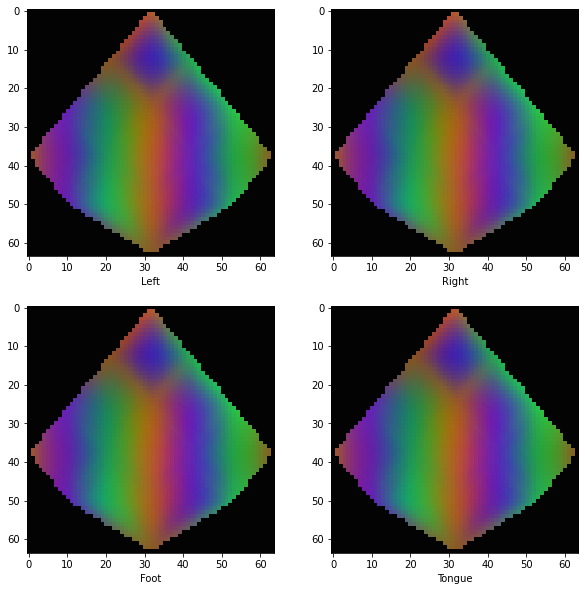

These projections are then used to analyse and understand the patterns using neural networks mostly convolutional neural networks such as AlexNet and ResNet.

The results are shown below for both models that were experimented upon.

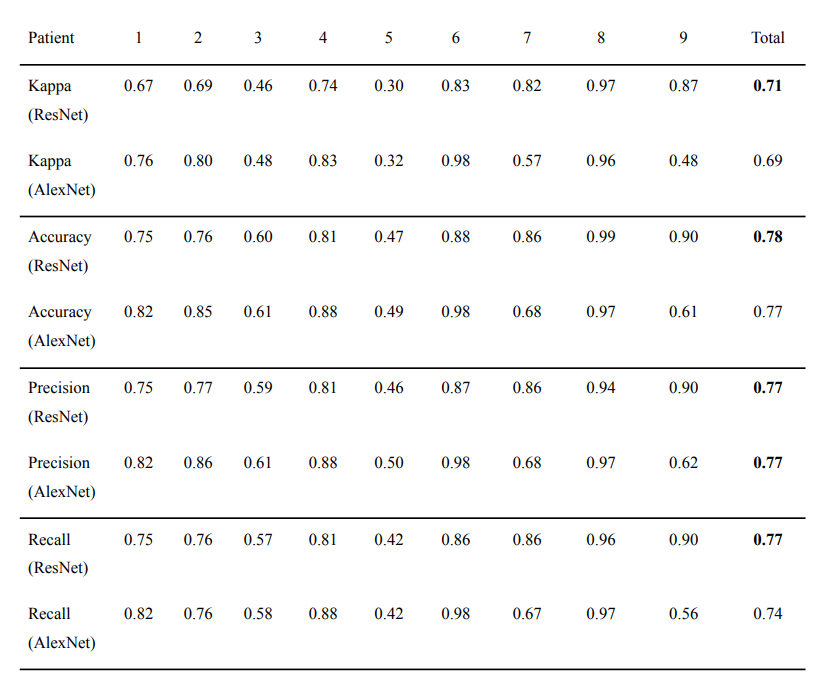